In [1]:
# Initial imports:
import json
from functools import partial

import natsort
import numpy as np
from IPython.core.display import HTML

import outer_spacem as osm
import pandas as pd
import scanpy as sc
import seaborn as sns
from IPython.core.display_functions import display
from matplotlib.ticker import ScalarFormatter
from matplotlib import pyplot as plt
from matplotlib.colors import to_rgb

from napari_spacem_qc.maldi_optim_utils import make_clickable_links
from napari_spacem_qc.debug_utils import disable_interactive_plots
# TODO: Import from qc_utils
from napari_spacem_qc.qc_utils import mprint, \
    get_general_config_parameters, get_rows_cols_layout, get_slide_layout, \
    print_metadata_table, plot_well_layouts, plot_replicate_coverage
from napari_spacem_qc import qc_utils
from outer_spacem.io import clip_hotspots

from napari_spacem_qc.parameters.report_parameters import SpaceMQCParameters

In [2]:
# Tagged cell that will be usually rewritten by Papermill
# with the correct path to the config file:
 # config_file = "/Users/alberto-mac/Documents/DA_ESPORTARE/LOCAL_EMBL_FILES/g_shared/shared/alberto/projects/spacem-reports/australia-project/initial_reports/config.yml"
config_file = "/Users/alberto-mac/Documents/DA_ESPORTARE/LOCAL_EMBL_FILES/g_shared/shared/alberto/projects/spacem-reports/australia-project/initial_reports/plots_without_TS36/config_ion_images_DE_markers.yml"
make_plots = True
condition = "Stem cells"

In [3]:
# Parameters
condition = "14 days cells"


In [4]:
# ------------------------------------------------
# Load report config file and general parameters:
# ------------------------------------------------

if not make_plots:
    disable_interactive_plots()

# Load report config
report_config = SpaceMQCParameters(config_path=config_file)
report_config.validate_all_tags()

params = \
    get_general_config_parameters(report_config,
                                  requires_adata_pattern=True,
                                  return_dictionary=True,
                                  print_report_header=True,
                                  report_title=f"Intensities of Differentially Expressed Markers for `{condition}` condition",
                                  mask_metadata=False)

# Define some variables that will be needed later on:
full_metadata = params["metadata"]
adata_pattern = params["adata_pattern"]
slide_key = params["slide_key"]
row_key = params["row_key"]
col_key = params["col_key"]
bio_key = params["bio_key"]
repl_key = params["repl_key"]
masking_key = params["masking_key"]
palette = params["palette"]

metadata = qc_utils.remove_masked_datasets_from_metadata(full_metadata,
                                                      masking_key=masking_key)

tick_palette = pd.Series(
    palette[metadata[bio_key]].values,
    index=metadata["auto_generated_dataset_name"]
)

# Define some parameters specific to the METASPACE QC report:
# markers = report_config.get("metaspace_qc/markers")

# MOD: -------------------
# Load custom markers from file:
markers_path = "/Users/alberto-mac/Documents/DA_ESPORTARE/LOCAL_EMBL_FILES/g_shared/shared/alberto/projects/spacem-reports/australia-project/initial_reports/plots_without_TS36/slide_All Slides_markers.csv"
markers = pd.read_csv(markers_path, sep=",", index_col=0)
markers = markers.loc[condition].to_list()
# MOD: -------------------


is_ion_marker = np.array(qc_utils.find_ion_markers(markers))
molecule_markers = np.array(markers)[~is_ion_marker]
ion_markers = np.array(markers)[is_ion_marker]
# adducts_to_consider = \
#     report_config.get("metaspace_qc/adducts_to_consider", [])
tic_normalization = report_config.get(
    "metaspace_qc/apply_tic_normalization_to_ion_images", True)

slide_layout = get_slide_layout(report_config=report_config)
layout_rows, layout_cols = get_rows_cols_layout(slide_layout)


# Single cell UOW (excluding Slide TS36)
## Intensities of Differentially Expressed Markers for `14 days cells` condition
Project description: Initial datasets shared by Australian collaborators (Tassiani Sarretto, Helena Anastacio). Three conditions (stem cells, cells grown for 7 and 14 days). 12 replicates per condition. One slide (TS36) including cells grown 7 days was excluded from this analysis (possible batch effects...?)

Date: `2023-05-30`

Config: `/Users/alberto-mac/Documents/DA_ESPORTARE/LOCAL_EMBL_FILES/g_shared/shared/alberto/projects/spacem-reports/australia-project/initial_reports/plots_without_TS36/config_ion_images_DE_markers.yml`

Notebook version: `v0.2.0.post3+g966cb55.d20230408 (git-commit: 9f02807)`

## Report parameters
- Biological key: `growthConditions`
- Slide key: `slide`
- Process slides independently: `False`
- Replicate key: `replicate_nb_overall`
- Masking key: `None`
- AnnData pattern: `/Users/alberto-mac/Documents/DA_ESPORTARE/LOCAL_EMBL_FILES/g_shared/shared/alberto/projects/spacem-reports/australia-project/initial_reports/anndatas/{slide}-well{well}-{row}{col}.h5ad`
- AnnData type: `AnnDatas downloaded from Metaspace`
- Metadata file path: `/Users/alberto-mac/Documents/DA_ESPORTARE/LOCAL_EMBL_FILES/g_shared/shared/alberto/projects/spacem-reports/australia-project/initial_reports/metadata_mod_full.csv`


In [5]:
# ------------------------------------------
# Retrieve & Aggregate information
# from AnnDatas downloaded from Metaspace:
# ------------------------------------------

results_dfs = []
n_ions_dfs = []
marker_nzf_dfs = []
marker_ion_images = []
max_intensity_per_marker = {}

metadata["analysis_version"] = None
metadata["ppm_tolerance"] = None
any_adata_downloaded = False

ion_images_with_same_scale_across_datasets = report_config.get(
    "metaspace_qc/"
    "ion_images_with_same_scale_across_datasets",
    default=False)

for idx, dataset_metadata in metadata.iterrows():
    # print(dataset_metadata["auto_generated_dataset_name"])

    dataset_id = dataset_metadata["datasetId"]

    ds_file = adata_pattern.format(**dataset_metadata.to_dict())
    # Load adata from disk:
    adata = sc.read(ds_file)

    if "read_metaspace_pixels" not in adata.uns:
        raise ValueError("The AnnData file is not compatible with the METASPACE QC report. Make sure to use AnnData files that have been downloaded via the Napari-SpaceM-QC tool")

    ds = adata.uns["read_metaspace_pixels"]["ion_images"]

    metadata["analysis_version"] = ds["config"]["analysis_version"]
    metadata["ppm_tolerance"] = ds["config"]["image_generation"]["ppm"]

    ds_results = ds["results"]
    ds_results["databases"] = ds_results["databases"].apply(json.loads)
    ds_results["moleculeNames"] = ds_results["moleculeNames"].apply(
        json.loads
    )
    ds_results["datasetId"] = dataset_id
    ds_results["ion_formula"] = ds_results["formula"] + ds_results["adduct"]

    for fdr in [0, 0.05, 0.1, 0.2, 0.5]:
        n_ions = (
            ds_results[ds_results.fdr <= fdr]
            .explode("databases")["databases"]
            .value_counts()
        )
        n_ions.index.name = "database"
        n_ions.name = "n_ions"
        n_ions = n_ions.reset_index()
        n_ions["fdr"] = fdr
        n_ions.insert(0, "datasetId", value=dataset_id)
        n_ions_dfs.append(n_ions)

    results_dfs.append(ds_results.explode("databases"))

    annotations = ds_results
    covered_markers = ds_results[ds_results["formula"].isin(molecule_markers) | ds_results["ion_formula"].isin(ion_markers)]

    # if len(adducts_to_consider) > 0:
    #     covered_markers = covered_markers[
    #         covered_markers["adduct"].isin(adducts_to_consider)
    #     ]

    if covered_markers.empty:
        print(
            f"WARNING: None of the selected markers was "
            f"found in the dataset {dataset_id}. "
            "Keep in mind to enter markers molecules WITHOUT "
            "specifying the adduct."
        )
        continue

    tic_image = ds["tic_image"].copy()

    for idx, marker in covered_markers.iterrows():
        if idx not in ds_results.index:
            continue

        ion_im = ds["array"][idx]

        if tic_normalization:
            ion_im = np.divide(ion_im, tic_image, out=np.zeros_like(ion_im),
                               where=tic_image > 0)

        # Clip the hotspots:
        ion_im = clip_hotspots(ion_im)

        nz_frac = (ion_im > 0).mean()

        dist = ion_im[ion_im > 0]

        shorten_name = marker['moleculeNames'][0]
        shorten_name = shorten_name[:25] + "..." \
            if len(shorten_name) > 25 else shorten_name

        # Save distribution of markers:
        marker_nzf_dfs.append(
            {
                "datasetId": dataset_id,
                "formula": marker["formula"],
                "adduct": marker["adduct"],
                "annotation_id": marker["annotation_id"],
                'molecule_name': shorten_name,
                "nz_frac": nz_frac,
                "nz_values": dist,
            }
        )

        # Compute max intensity across datasets:
        if ion_images_with_same_scale_across_datasets:
            max_intensity_per_marker = qc_utils.update_max_intensity(
                max_intensity_per_marker,
                                 dist, marker["annotation_id"])

        # Save intensities as ion images:
        marker_ion_images.append(
            {
                "datasetId": dataset_id,
                "formula": marker["formula"],
                "adduct": marker["adduct"],
                "annotation_id": marker["annotation_id"],
                'molecule_name': shorten_name,
                "image": ion_im,
            }
        )

    tic_image = clip_hotspots(tic_image)

    marker_ion_images.append(
        {
            "datasetId": dataset_id,
            "formula": "TIC",
            "adduct": None,
            "annotation_id": "TIC",
            'molecule_name': "TIC",
            "image": tic_image,
        }
    )

    image_flatten = tic_image.flatten()
    marker_nzf_dfs.append(
        {
            "datasetId": dataset_id,
            "formula": "TIC",
            "adduct": None,
            "annotation_id": "TIC",
            'molecule_name': "TIC",
            "nz_frac": None,
            "nz_values": image_flatten,
        }
    )
    if ion_images_with_same_scale_across_datasets:
        max_intensity_per_marker = qc_utils.update_max_intensity(
            max_intensity_per_marker, image_flatten, "TIC")

# Sanity check: ensure analysis version and ppm tolerance are all the same

if len(metadata["analysis_version"].unique()) > 1:
    mprint(
        "### <span style='color:red'> **WARNING:** Multiple analysis versions detected!</span>"
    )
    for name, v in metadata.groupby("analysis_version")[
        "auto_generated_dataset_name"]:
        mprint(
            f"<span style='color:red'>**Datasets using analysis version {name}**: {', '.join(v)}</span>"
        )

if len(metadata["ppm_tolerance"].unique()) > 1:
    mprint(
        "### <span style='color:red'> **WARNING:** Multiple ppm tolerance settings detected!</span>"
    )
    for name, v in metadata.groupby("ppm_tolerance")[
        "auto_generated_dataset_name"]:
        mprint(
            f"<span style='color:red'>**Datasets with ppm_tolerance={name}**: {', '.join(v)}</span>"
        )

# Reshape retrieved data in the final form:
if slide_key:
    gb_layout = metadata.sort_values(slide_key,
                                     key=natsort.natsort_key).groupby(
        slide_key
    )
else:
    gb_layout = [(False, metadata)]

results = pd.concat(results_dfs, axis=0)
results.reset_index(inplace=True)

n_ions = pd.concat(n_ions_dfs, axis=0)
n_ions.reset_index(drop=True, inplace=True)

marker_nzf = pd.DataFrame(marker_nzf_dfs)
ion_images = pd.DataFrame(marker_ion_images)

# Delete "database" from metadata and only keep the one from AnnData files:
if "database" in metadata:
    metadata.drop(columns="database", inplace=True)

assert "database" in n_ions.columns

results = metadata.merge(results, on="datasetId")
n_ions = metadata.merge(n_ions, on="datasetId")
marker_nzf = marker_nzf.merge(metadata, on="datasetId")
ion_images = ion_images.merge(metadata, on="datasetId")

In [6]:
# --------------------------------------
# Print Table of Content of the report:
# --------------------------------------

display(HTML(f'<h2 id="main_index">Table of Content</h2>'))
mprint(f"""
1. [Ion images plots of DE marker intensities](#ion_images)
2. [Violin plots of DE marker intensities](#marker_intensities)
""")


1. [Ion images plots of DE marker intensities](#ion_images)
2. [Violin plots of DE marker intensities](#marker_intensities)


In [7]:
# ---------------------------------------
# Print table with links to Ion Images
# (one link per slide/marker):
# ---------------------------------------

if slide_key:
    gb = ion_images.sort_values(
        slide_key, key=natsort.natsort_key
    ).groupby(slide_key)
else:
    gb = [(False, ion_images)]

links_to_ion_images_sections = {}
styler_format = {}

for batch_name, batch_ion_images in gb:
    batch_name_formatted = f"{slide_key.capitalize()} {batch_name}" if batch_name else " "
    annotations_and_names = batch_ion_images[
        ["annotation_id", "molecule_name"]].value_counts().reset_index(
        level=1).drop(columns=[0])
    ann_ids = annotations_and_names.index.to_numpy()

    if batch_name_formatted not in links_to_ion_images_sections:
        links_to_ion_images_sections[batch_name_formatted] = {}
    for ann_id in ann_ids:
        mol_name = annotations_and_names.loc[ann_id, 'molecule_name']
        links_to_ion_images_sections[batch_name_formatted][
            ann_id] = f"{mol_name}#{batch_name}_{ann_id}"

    # Add styler:
    styler_format[f"{batch_name_formatted}"] = partial(
        make_clickable_links, anchor_link=True
    )

links_to_ion_images_sections = pd.DataFrame(links_to_ion_images_sections)
order = ["TIC"] + natsort.natsorted(
    [item for item in links_to_ion_images_sections.index.tolist() if
     item != "TIC"])
links_to_ion_images_sections = links_to_ion_images_sections.loc[order]
links_to_ion_images_sections.index.name = "Marker formula"

styler = links_to_ion_images_sections.style
styler.set_caption("Links to ion images for selected markers")
styler = styler.format(styler_format)
display(styler)

# # %%
# # ----------------------------------------------
# # Print Basic Project Information:
# # - Replicate Coverage Plot
# # - Metadata Table with list of datasets
# # - Slide Layouts
# # ----------------------------------------------
# plot_replicate_coverage(report_config=report_config)
# print_metadata_table(report_config=report_config)
# plot_well_layouts(report_config=report_config)
#
# # %%
# # ----------------------------------------------
# # Print Number of Annotations per Dataset
# # ----------------------------------------------
#
# display(HTML(f'<h2 id="number_of_annotations">Number of annotations</h2>'))
# mprint(f"[Go back to index](#main_index)")
#
n_ions["database"] = n_ions["database"].apply(" ".join)
results["database"] = results["databases"].apply(" ".join)
#
# with sns.axes_style("whitegrid"):
#     h = 1 + 0.25 * len(metadata)
#     w = 3
#     a = w / h
#
#     g = sns.FacetGrid(
#         data=n_ions,
#         col="database",
#         hue="fdr",
#         palette="mako_r",
#         height=h,
#         aspect=a,
#     )
#
#     g.map(
#         sns.stripplot,
#         "n_ions",
#         "auto_generated_dataset_name",
#         size=10,
#         orient="h",
#         jitter=False,
#         # palette="mercury",
#         linewidth=1,
#         edgecolor="w",
#         # alpha=0.9
#     )
#
#     g.add_legend(title="FDR")
#
#     g.set(xlabel="# annotations", ylabel="")
#     g.set_titles("{col_name}")
#
#     for ax in g.axes.flat:
#         ax.xaxis.grid(True)
#         ax.yaxis.grid(True)
#         ax.set_xscale("log")
#
#     for ax in g._left_axes:
#         osm.pl._pl._decorate_ticklabels(
#             ax, ytick_palette=tick_palette, adapt_textcolor=True
#         )
#
#     sns.despine(left=True, bottom=False)
#     plt.xscale("log")
#     plt.xticks([1e0, 1e1, 1e2, 1e3])
#     plt.yticks(ha="center")
#     plt.show()



,Slide TS33,Slide TS34,Slide TS35,Slide TS36,Slide TS37,Slide TS38
Marker formula,,,,,,
TIC,TIC,TIC,TIC,TIC,TIC,TIC
C34H66O3+NH4,Tetrahydro-6-(2-hydroxy-1...,Tetrahydro-6-(2-hydroxy-1...,Tetrahydro-6-(2-hydroxy-1...,Tetrahydro-6-(2-hydroxy-1...,Tetrahydro-6-(2-hydroxy-1...,Tetrahydro-6-(2-hydroxy-1...
C34H69NO3+H,Cer(d14:0/20:0),Cer(d14:0/20:0),Cer(d14:0/20:0),Cer(d14:0/20:0),Cer(d14:0/20:0),Cer(d14:0/20:0)
C39H73O8P+Na,9-Octadecenoic acid 1-[(p...,9-Octadecenoic acid 1-[(p...,9-Octadecenoic acid 1-[(p...,9-Octadecenoic acid 1-[(p...,9-Octadecenoic acid 1-[(p...,9-Octadecenoic acid 1-[(p...
C42H73O8P+NH4,"PA(3:0/36:5(18Z,21Z,24Z,2...","PA(3:0/36:5(18Z,21Z,24Z,2...","PA(3:0/36:5(18Z,21Z,24Z,2...","PA(3:0/36:5(18Z,21Z,24Z,2...","PA(3:0/36:5(18Z,21Z,24Z,2...","PA(3:0/36:5(18Z,21Z,24Z,2..."
C42H76NO8P+H,"PC(2:0/32:4(17Z,20Z,23Z,2...","PC(2:0/32:4(17Z,20Z,23Z,2...","PC(2:0/32:4(17Z,20Z,23Z,2...","PC(2:0/32:4(17Z,20Z,23Z,2...","PC(2:0/32:4(17Z,20Z,23Z,2...","PC(2:0/32:4(17Z,20Z,23Z,2..."
C43H63NO7+NH4,Spirolide C,Spirolide C,Spirolide C,Spirolide C,Spirolide C,Spirolide C
C44H80NO8P+Na,"PC(2:0/34:4(19Z,22Z,25Z,2...","PC(2:0/34:4(19Z,22Z,25Z,2...","PC(2:0/34:4(19Z,22Z,25Z,2...","annotation_id C44H80NO8P+Na PC(2:0/34:4(19Z,22Z,25Z,2... C44H80NO8P+Na PC(14:0/22:4(7Z,10Z,13Z,1... Name: molecule_name, dtype: object","PC(2:0/34:4(19Z,22Z,25Z,2...","PC(2:0/34:4(19Z,22Z,25Z,2..."
C44H82NO8P+Na,"PC(14:0/22:3(10Z,13Z,16Z)...","PC(14:0/22:3(10Z,13Z,16Z)...","PC(14:0/22:3(10Z,13Z,16Z)...","PC(14:0/22:3(10Z,13Z,16Z)...","PC(14:0/22:3(10Z,13Z,16Z)...","PC(14:0/22:3(10Z,13Z,16Z)..."


[Go back to index](#main_index)

Annotation done at FDR 50% against the following databases: HMDB v4, SwissLipids 2018-02-02, KEGG v1

Ion images with TIC normalization: `True`

## TIC

Joint colormap: for all wells/datasets, the same colormap is used to represent ion intensities.

[Go back to index](#main_index)

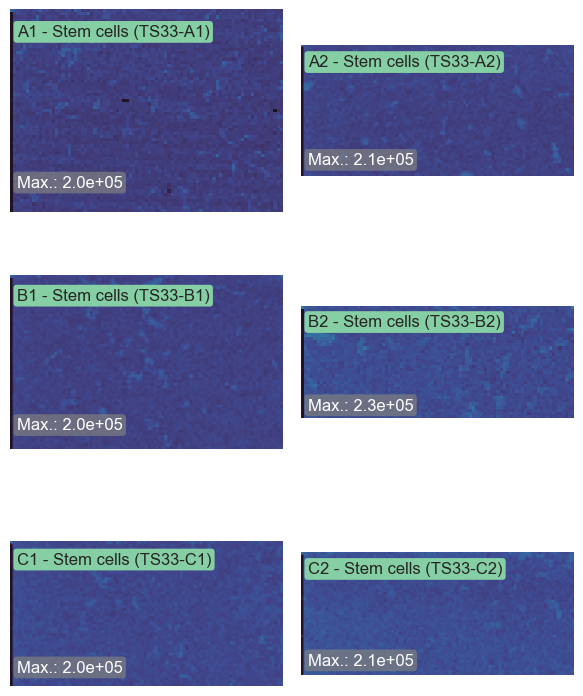

[Go back to index](#main_index)

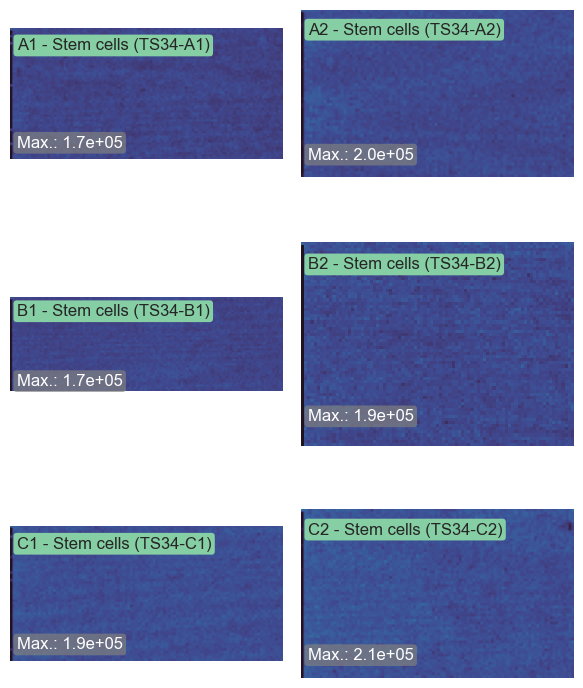

[Go back to index](#main_index)

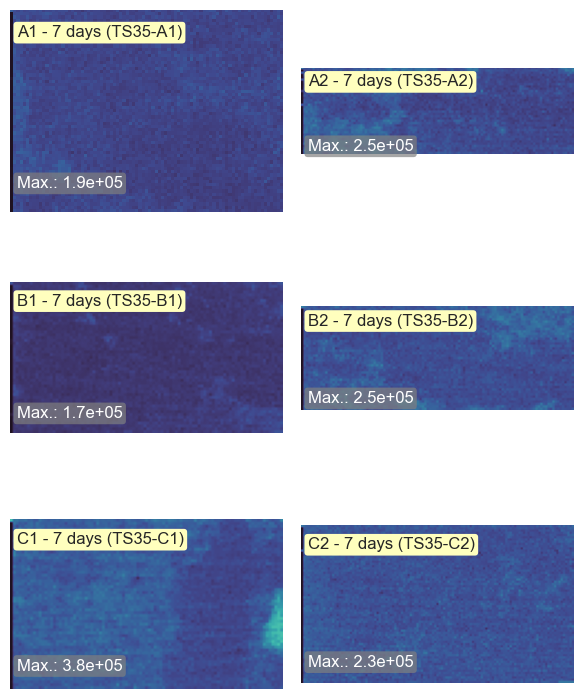

[Go back to index](#main_index)

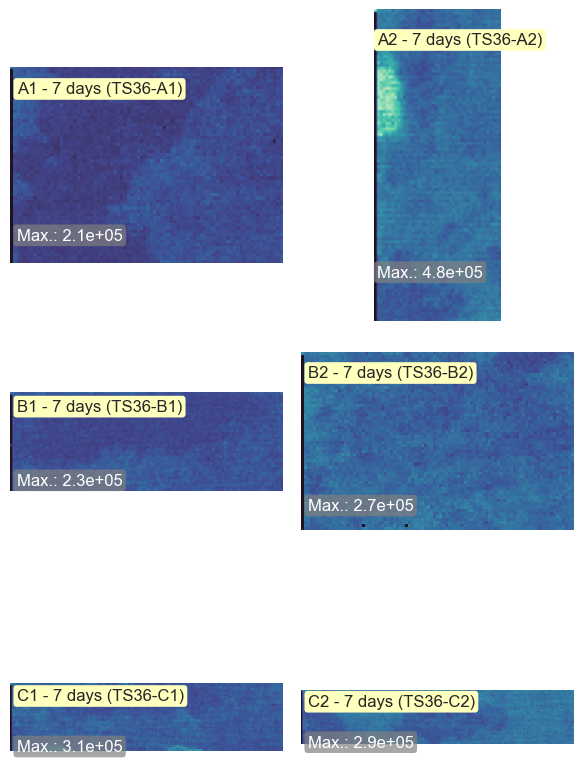

[Go back to index](#main_index)

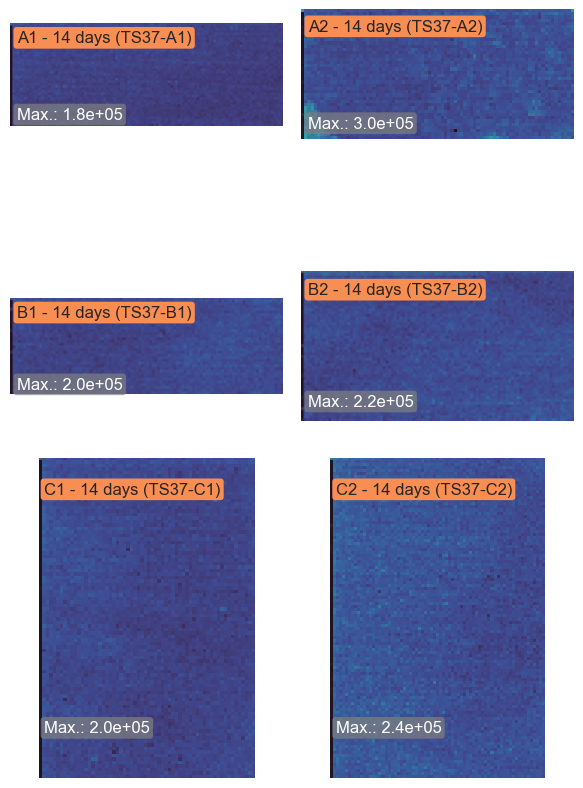

[Go back to index](#main_index)

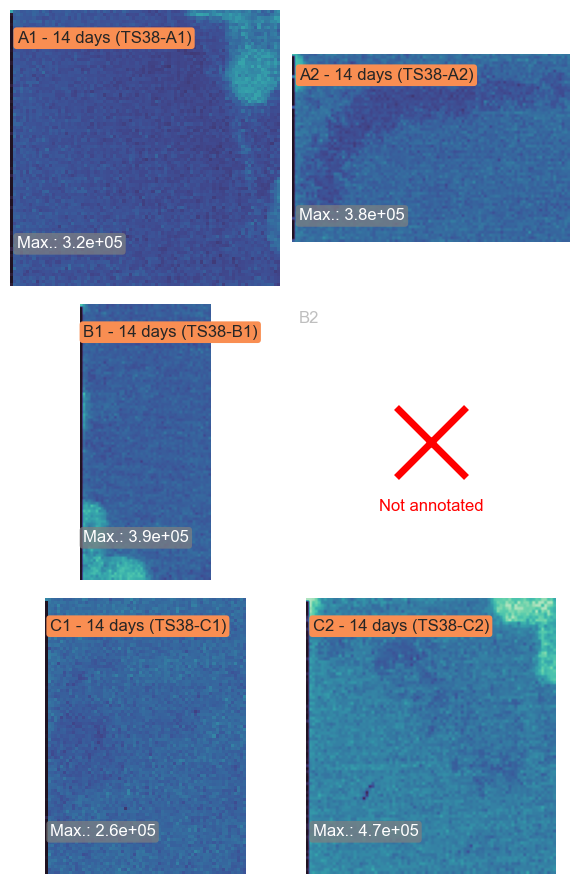

## C34H66O3+NH4

Tetrahydro-6-(2-hydroxy-16,19-dimethylhexacosyl)-4-methyl-2H-pyran-2-one

Joint colormap: for all wells/datasets, the same colormap is used to represent ion intensities.

[Go back to index](#main_index)

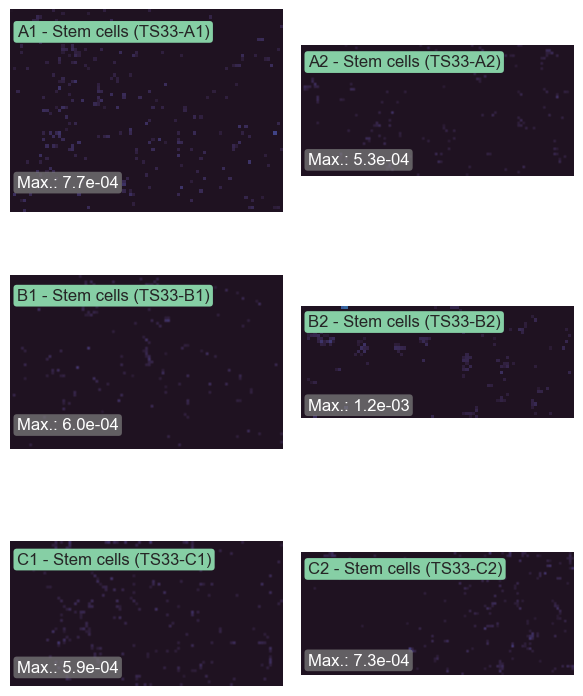

[Go back to index](#main_index)

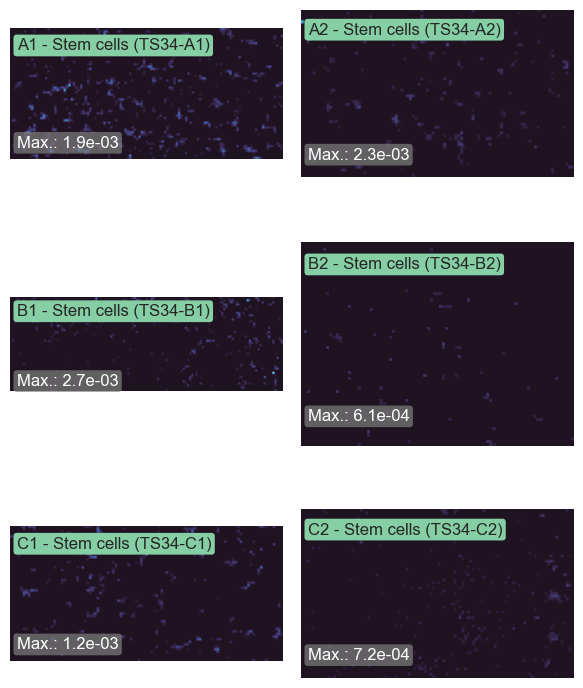

[Go back to index](#main_index)

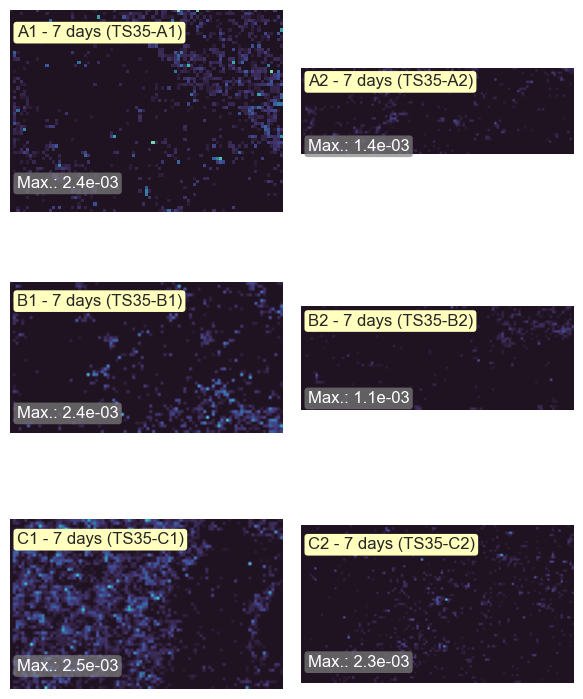

[Go back to index](#main_index)

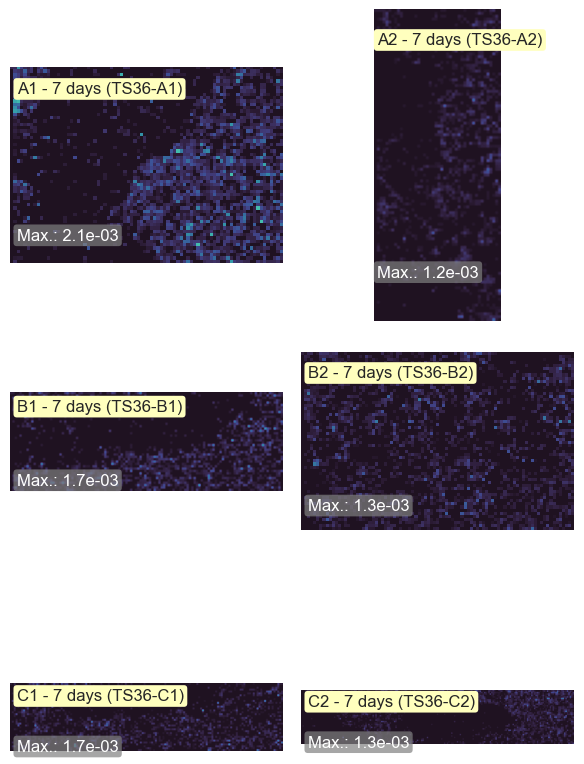

[Go back to index](#main_index)

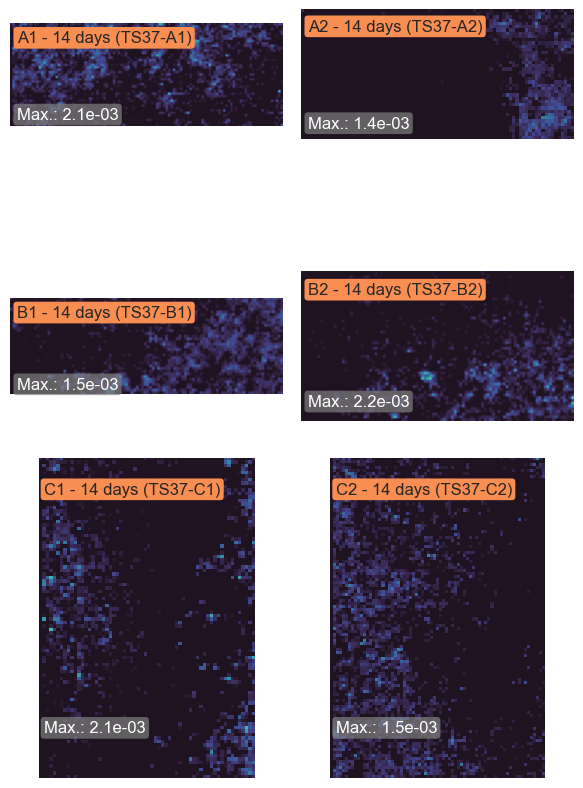

[Go back to index](#main_index)

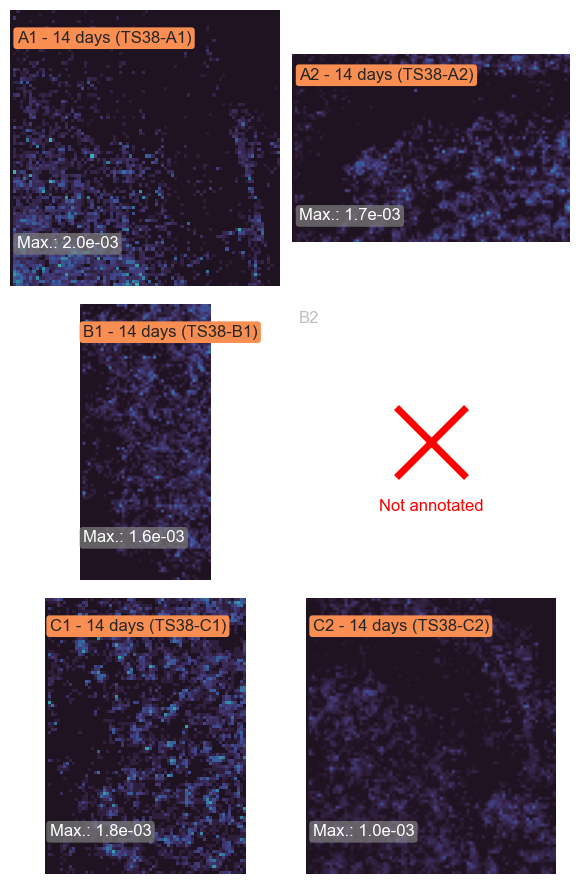

## C34H69NO3+H

Cer(d14:0/20:0), Cer(d16:0/18:0), Cer(d18:0/16:0), Cer(d20:0/14:0), Cer(iso-d17:0/17:0)

Joint colormap: for all wells/datasets, the same colormap is used to represent ion intensities.

[Go back to index](#main_index)

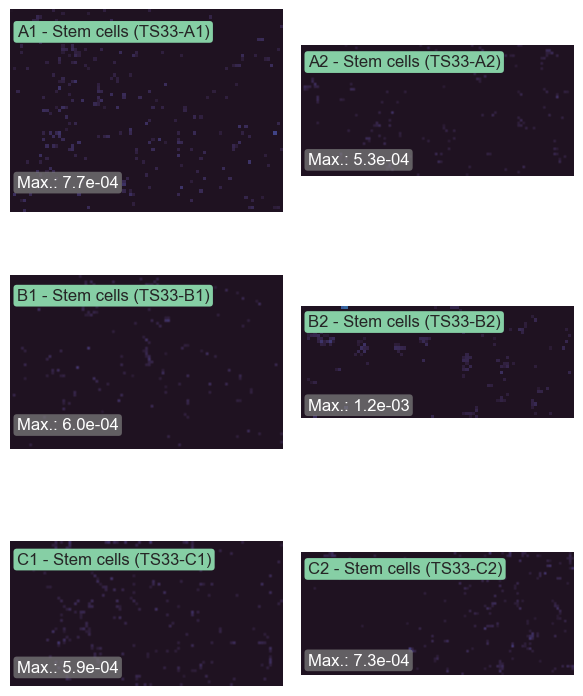

[Go back to index](#main_index)

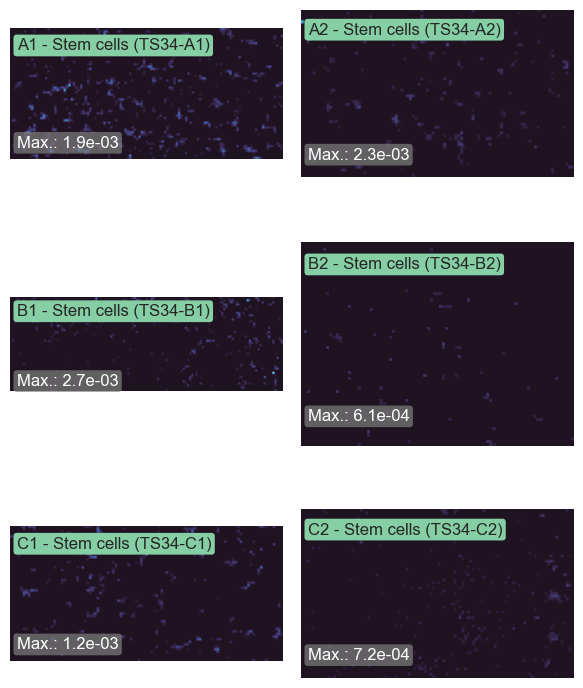

[Go back to index](#main_index)

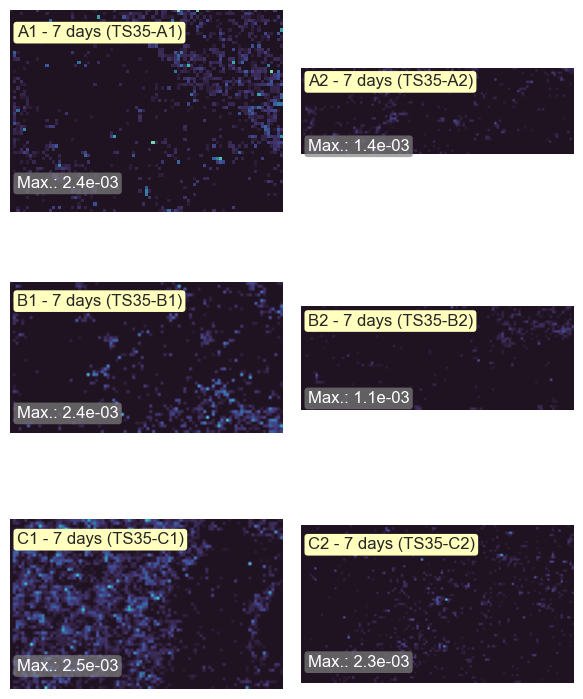

[Go back to index](#main_index)

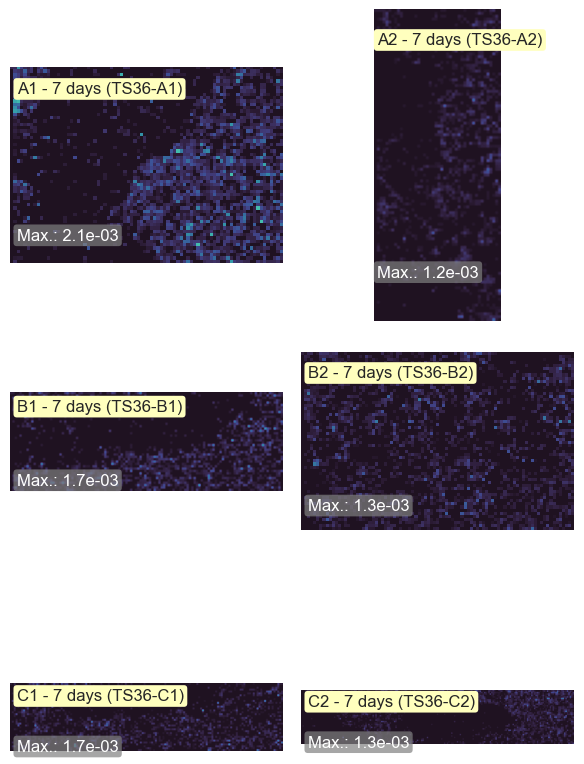

[Go back to index](#main_index)

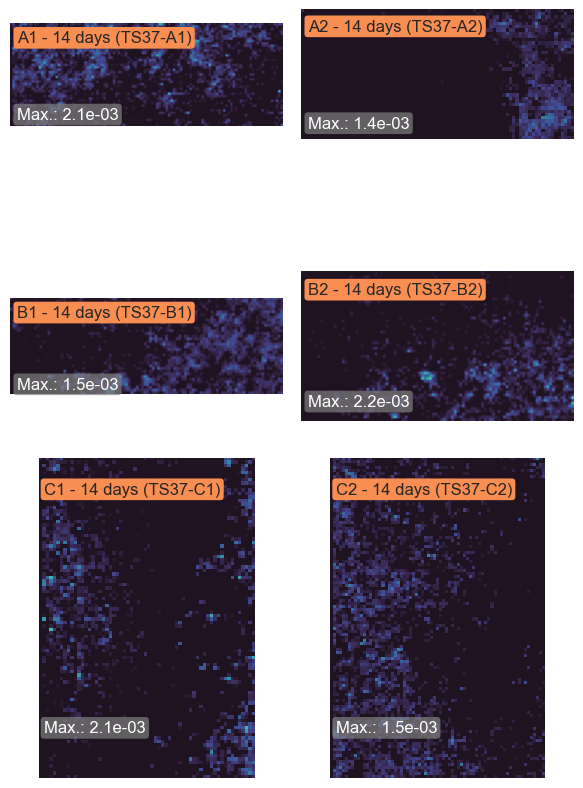

[Go back to index](#main_index)

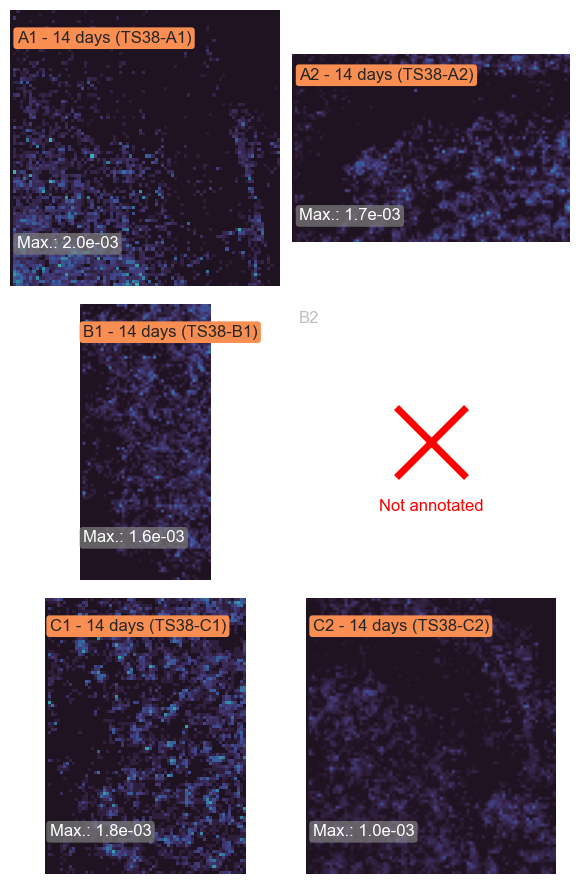

## C39H73O8P+Na

9-Octadecenoic acid 1-[(phosphonoxy)methyl]-1,2-ethanediyl ester, PA(14:0/22:2(13Z,16Z)), PA(14:1(9Z)/22:1(13Z)), PA(16:0/20:2(11Z,14Z)), PA(16:1(6Z)/20:1(11Z)), PA(16:1(9Z)/20:1(11Z)), PA(16:2(9Z,12Z)/20:0), PA(18:0/18:2(9Z,11E)), PA(18:0/18:2(9Z,12Z)), PA(18:1(6Z)/18:1(6Z)), PA(18:1(6Z)/18:1(9Z)), PA(18:1(6Z)/18:1(11E)), PA(18:1(6Z)/18:1(11Z)), PA(18:1(9Z)/18:1(6Z)), PA(18:1(9Z)/18:1(9Z)), PA(18:1(9Z)/18:1(11E)), PA(18:1(9Z)/18:1(11Z)), PA(18:1(11E)/18:1(6Z)), PA(18:1(11E)/18:1(9Z)), PA(18:1(11E)/18:1(11E)), PA(18:1(11E)/18:1(11Z)), PA(18:1(11Z)/18:1(6Z)), PA(18:1(11Z)/18:1(9Z)), PA(18:1(11Z)/18:1(11E)), PA(18:1(11Z)/18:1(11Z)), PA(18:2(9Z,11E)/18:0), PA(18:2(9Z,12Z)/18:0), PA(20:0/16:2(9Z,12Z)), PA(20:1(11Z)/16:1(6Z)), PA(20:1(11Z)/16:1(9Z)), PA(20:2(11Z,14Z)/16:0), PA(22:1(13Z)/14:1(9Z)), PA(22:2(13Z,16Z)/14:0)

Joint colormap: for all wells/datasets, the same colormap is used to represent ion intensities.

[Go back to index](#main_index)

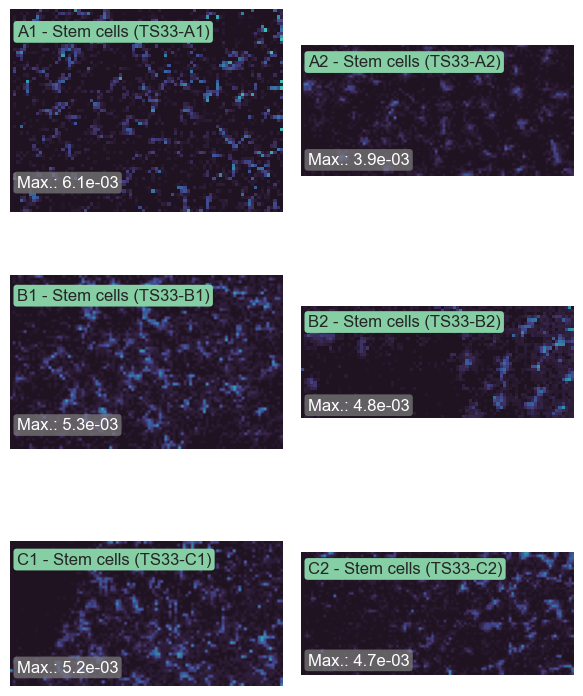

[Go back to index](#main_index)

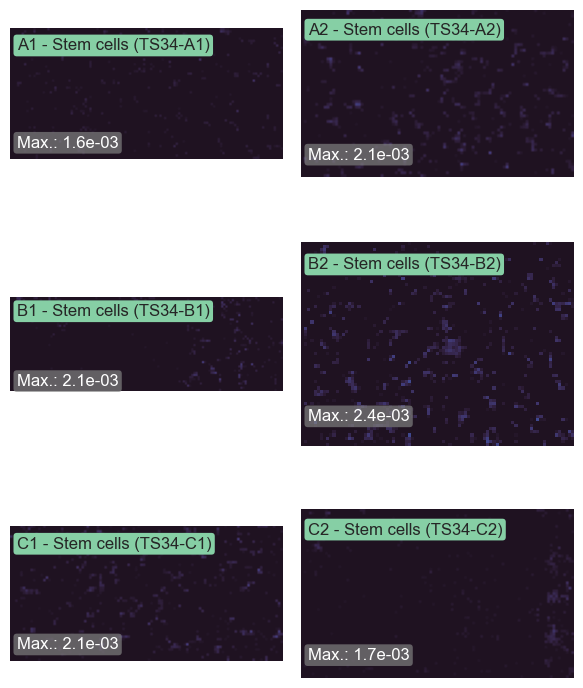

[Go back to index](#main_index)

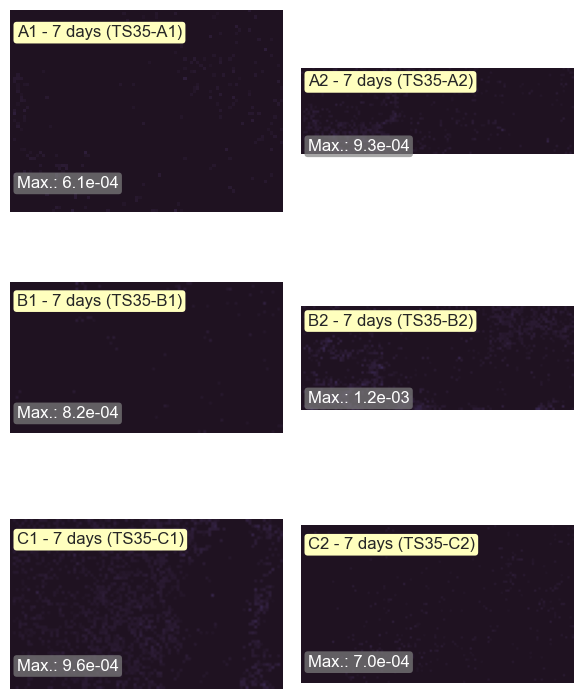

[Go back to index](#main_index)

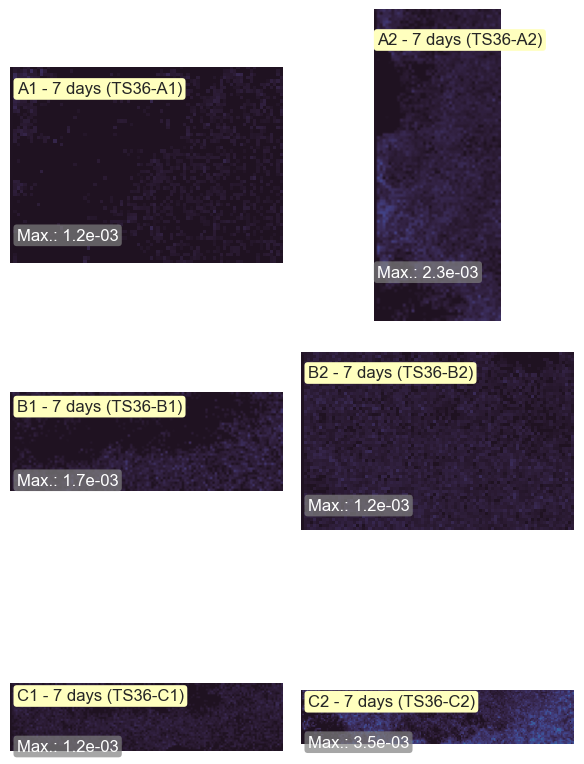

[Go back to index](#main_index)

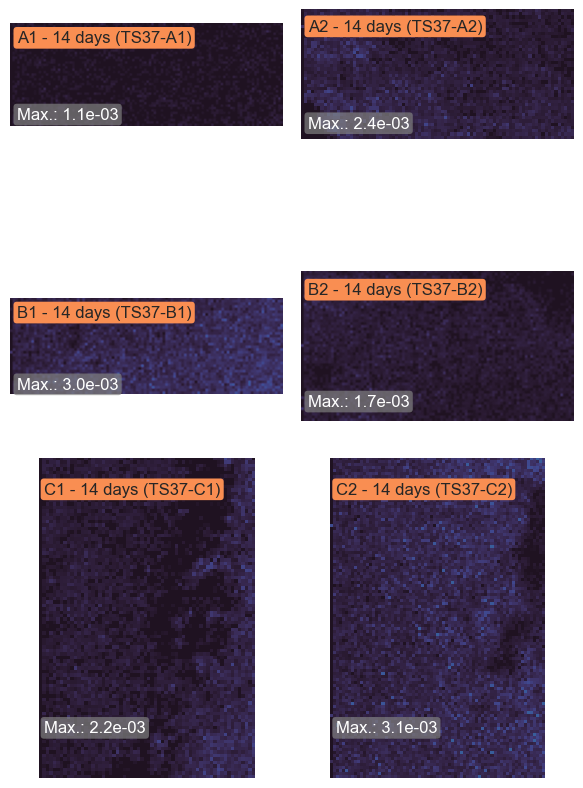

[Go back to index](#main_index)

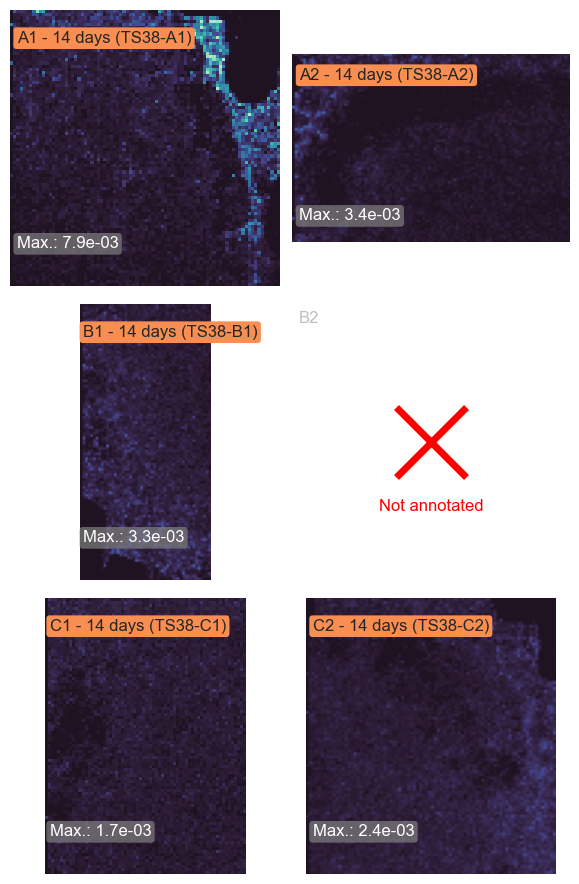

## C42H73O8P+NH4

PA(3:0/36:5(18Z,21Z,24Z,27Z,30Z)), PA(3:0/36:5(21Z,24Z,27Z,30Z,33Z)), PA(13:0/26:5(8Z,11Z,14Z,17Z,20Z)), PA(13:0/26:5(11Z,14Z,17Z,20Z,23Z)), PA(15:0/24:5(6Z,9Z,12Z,15Z,18Z)), PA(15:0/24:5(9Z,12Z,15Z,18Z,21Z)), PA(17:0/22:5(4Z,7Z,10Z,13Z,16Z)), PA(17:0/22:5(7Z,10Z,13Z,16Z,19Z)), PA(19:0/20:5(5Z,8Z,11Z,14Z,17Z)), PA(20:5(5Z,8Z,11Z,14Z,17Z)/19:0), PA(22:5(4Z,7Z,10Z,13Z,16Z)/17:0), PA(22:5(7Z,10Z,13Z,16Z,19Z)/17:0), PA(24:5(6Z,9Z,12Z,15Z,18Z)/15:0), PA(24:5(9Z,12Z,15Z,18Z,21Z)/15:0), PA(26:5(8Z,11Z,14Z,17Z,20Z)/13:0), PA(26:5(11Z,14Z,17Z,20Z,23Z)/13:0), PA(36:5(18Z,21Z,24Z,27Z,30Z)/3:0), PA(36:5(21Z,24Z,27Z,30Z,33Z)/3:0)

Joint colormap: for all wells/datasets, the same colormap is used to represent ion intensities.

[Go back to index](#main_index)

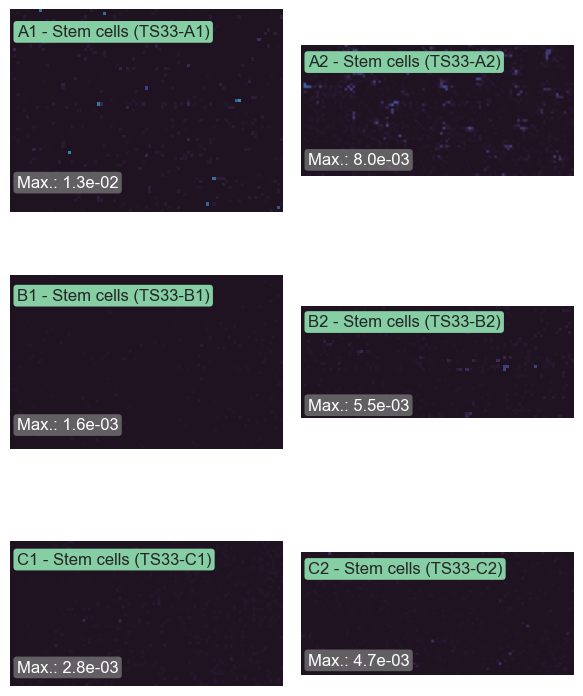

[Go back to index](#main_index)

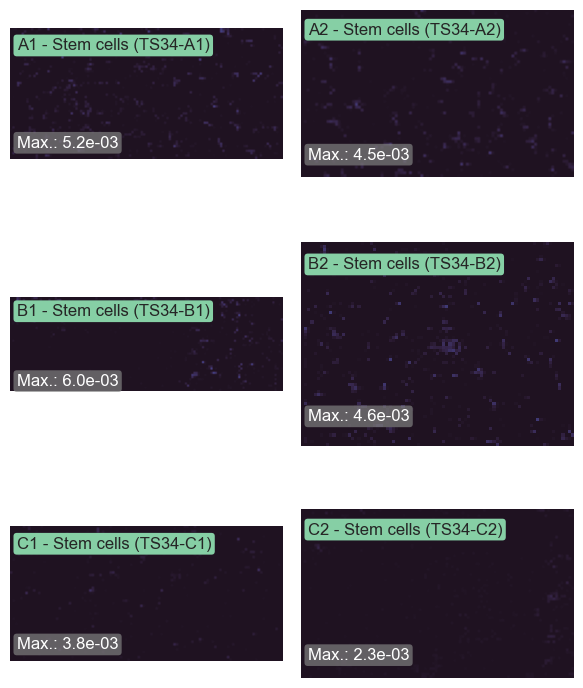

[Go back to index](#main_index)

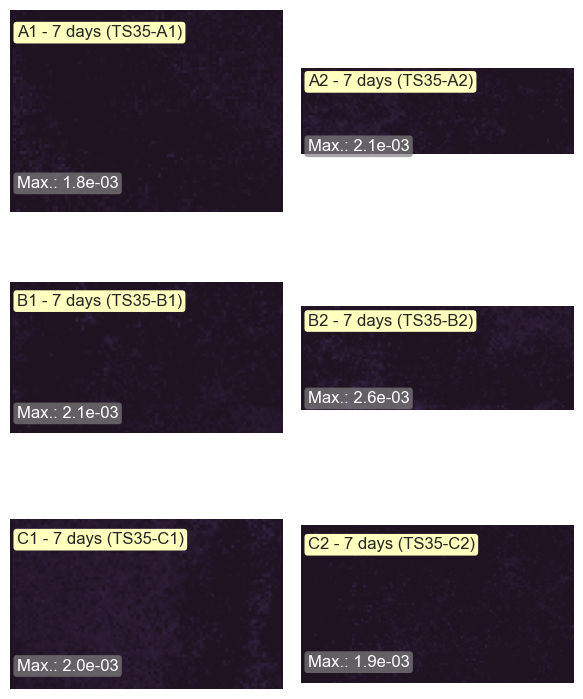

[Go back to index](#main_index)

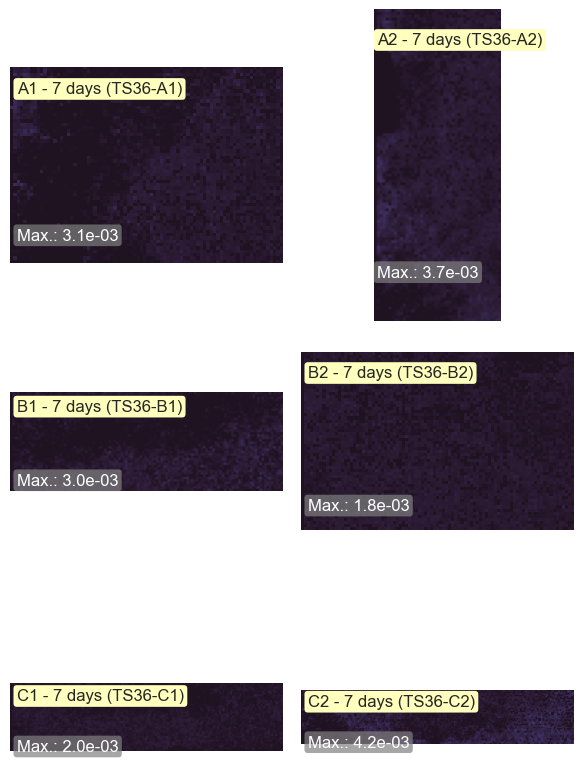

[Go back to index](#main_index)

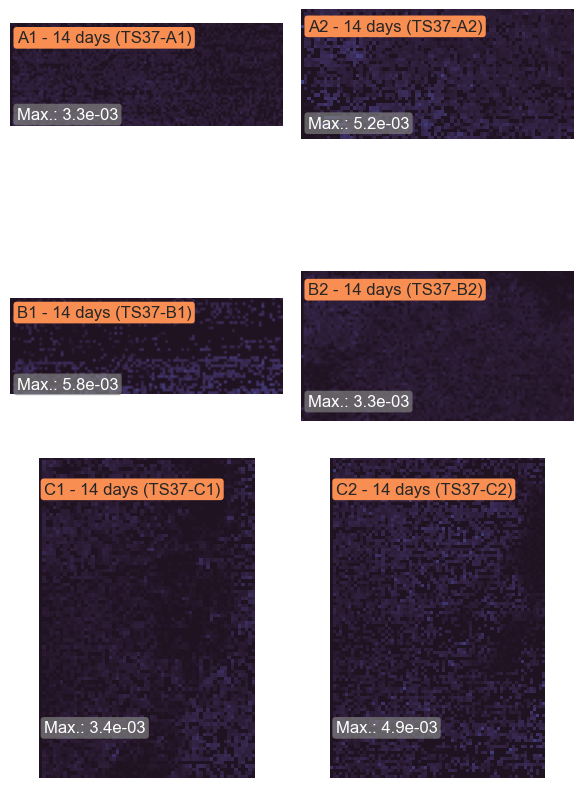

[Go back to index](#main_index)

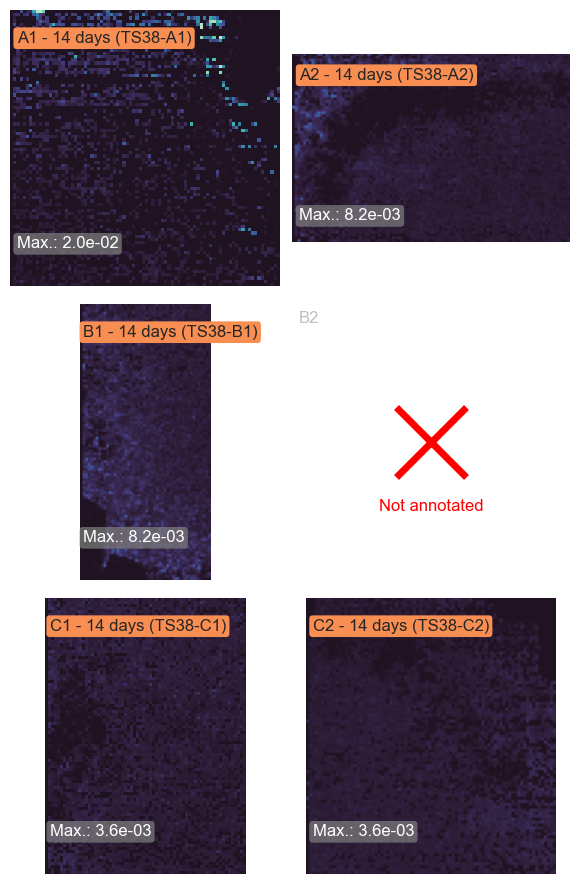

## C42H76NO8P+H

PC(2:0/32:4(17Z,20Z,23Z,26Z)), PC(4:0/30:4(15Z,18Z,21Z,24Z)), PC(6:0/28:4(13Z,16Z,19Z,22Z)), PC(8:0/26:4(11Z,14Z,17Z,20Z)), PC(12:0/22:4(7Z,10Z,13Z,16Z)), PC(14:0/20:4(5Z,8Z,11Z,14Z)), PC(14:0/20:4(8Z,11Z,14Z,17Z)), PC(14:1(9Z)/20:3(5Z,8Z,11Z)), PC(14:1(9Z)/20:3(8Z,11Z,14Z)), PC(14:1(9Z)/20:3(11Z,14Z,17Z)), PC(16:0/18:4(6Z,9Z,12Z,15Z)), PC(16:1(6Z)/18:3(6Z,9Z,12Z)), PC(16:1(6Z)/18:3(9Z,12Z,15Z)), PC(16:1(9Z)/18:3(6Z,9Z,12Z)), PC(16:1(9Z)/18:3(9Z,12Z,15Z)), PC(16:2(9Z,12Z)/18:2(9Z,11E)), PC(16:2(9Z,12Z)/18:2(9Z,12Z)), PC(18:2(9Z,11E)/16:2(9Z,12Z)), PC(18:2(9Z,12Z)/16:2(9Z,12Z)), PC(18:3(6Z,9Z,12Z)/16:1(6Z)), PC(18:3(6Z,9Z,12Z)/16:1(9Z)), PC(18:3(9Z,12Z,15Z)/16:1(6Z)), PC(18:3(9Z,12Z,15Z)/16:1(9Z)), PC(18:4(6Z,9Z,12Z,15Z)/16:0), PC(20:3(5Z,8Z,11Z)/14:1(9Z)), PC(20:3(8Z,11Z,14Z)/14:1(9Z)), PC(20:3(11Z,14Z,17Z)/14:1(9Z)), PC(20:4(5Z,8Z,11Z,14Z)/14:0), PC(20:4(8Z,11Z,14Z,17Z)/14:0), PC(22:4(7Z,10Z,13Z,16Z)/12:0), PC(24:4(9Z,12Z,15Z,18Z)/10:0), PC(26:4(11Z,14Z,17Z,20Z)/8:0), PC(28:4(13Z,16Z,19Z,22Z)/6:0), PC(30:4(15Z,18Z,21Z,24Z)/4:0), PC(32:4(17Z,20Z,23Z,26Z)/2:0), PE(3:0/34:4(19Z,22Z,25Z,28Z)), PE(13:0/24:4(9Z,12Z,15Z,18Z)), PE(15:0/22:4(7Z,10Z,13Z,16Z)), PE(17:0/20:4(5Z,8Z,11Z,14Z)), PE(17:0/20:4(8Z,11Z,14Z,17Z)), PE(18:4(6Z,9Z,12Z,15Z)/19:0), PE(19:0/18:4(6Z,9Z,12Z,15Z)), PE(20:4(5Z,8Z,11Z,14Z)/17:0), PE(20:4(8Z,11Z,14Z,17Z)/17:0), PE(22:4(7Z,10Z,13Z,16Z)/15:0), PE(24:4(9Z,12Z,15Z,18Z)/13:0), PE-NMe2(15:0/20:4(5Z,8Z,11Z,14Z)), PE-NMe2(15:0/20:4(8Z,11Z,14Z,17Z)), PE-NMe2(20:4(5Z,8Z,11Z,14Z)/15:0), PE-NMe2(20:4(8Z,11Z,14Z,17Z)/15:0), PE-NMe(14:0/22:4(7Z,10Z,13Z,16Z)), PE-NMe(16:0/20:4(5Z,8Z,11Z,14Z)), PE-NMe(16:0/20:4(8Z,11Z,14Z,17Z)), PE-NMe(16:1(9Z)/20:3(5Z,8Z,11Z)), PE-NMe(16:1(9Z)/20:3(8Z,11Z,14Z)), PE-NMe(18:0/18:4(6Z,9Z,12Z,15Z)), PE-NMe(18:1(9Z)/18:3(6Z,9Z,12Z)), PE-NMe(18:1(9Z)/18:3(9Z,12Z,15Z)), PE-NMe(18:1(11Z)/18:3(6Z,9Z,12Z)), PE-NMe(18:1(11Z)/18:3(9Z,12Z,15Z)), PE-NMe(18:2(9Z,12Z)/18:2(9Z,12Z)), PE-NMe(18:3(6Z,9Z,12Z)/18:1(9Z)), PE-NMe(18:3(6Z,9Z,12Z)/18:1(11Z)), PE-NMe(18:3(9Z,12Z,15Z)/18:1(9Z)), PE-NMe(18:3(9Z,12Z,15Z)/18:1(11Z)), PE-NMe(18:4(6Z,9Z,12Z,15Z)/18:0), PE-NMe(20:3(5Z,8Z,11Z)/16:1(9Z)), PE-NMe(20:3(8Z,11Z,14Z)/16:1(9Z)), PE-NMe(20:4(5Z,8Z,11Z,14Z)/16:0), PE-NMe(20:4(8Z,11Z,14Z,17Z)/16:0), PE-NMe(22:4(7Z,10Z,13Z,16Z)/14:0)

Joint colormap: for all wells/datasets, the same colormap is used to represent ion intensities.

[Go back to index](#main_index)

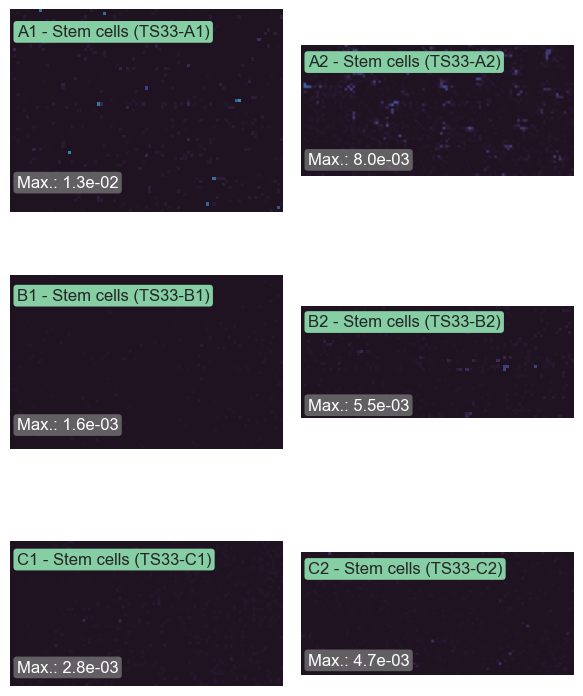

[Go back to index](#main_index)

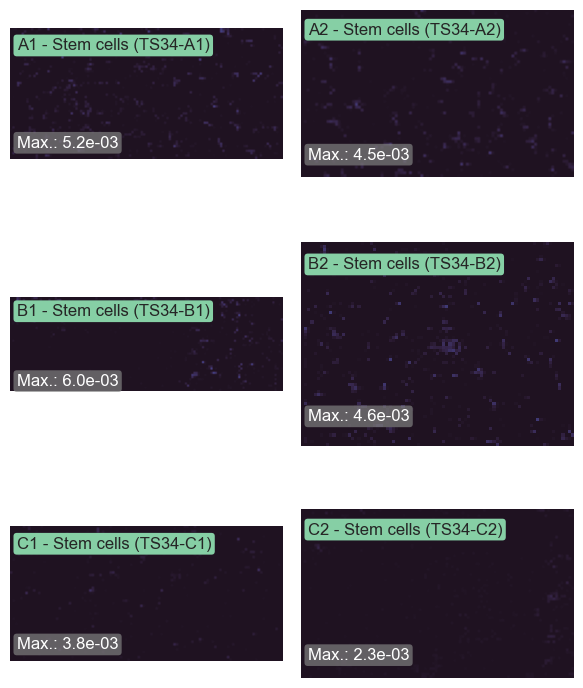

[Go back to index](#main_index)

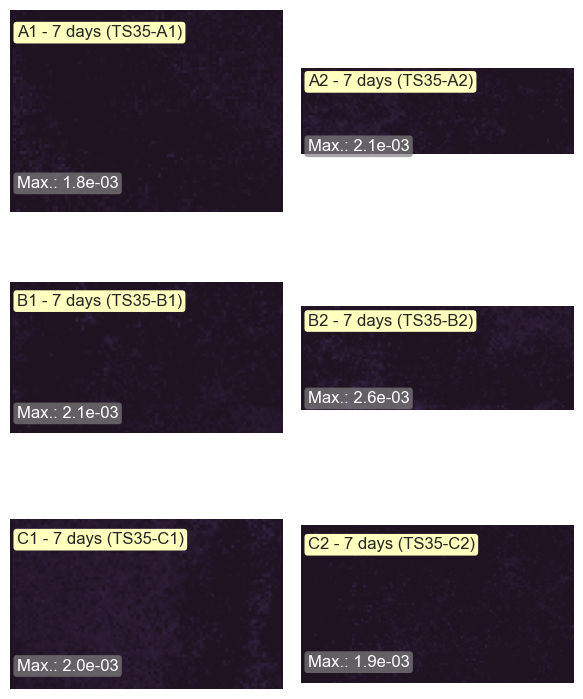

[Go back to index](#main_index)

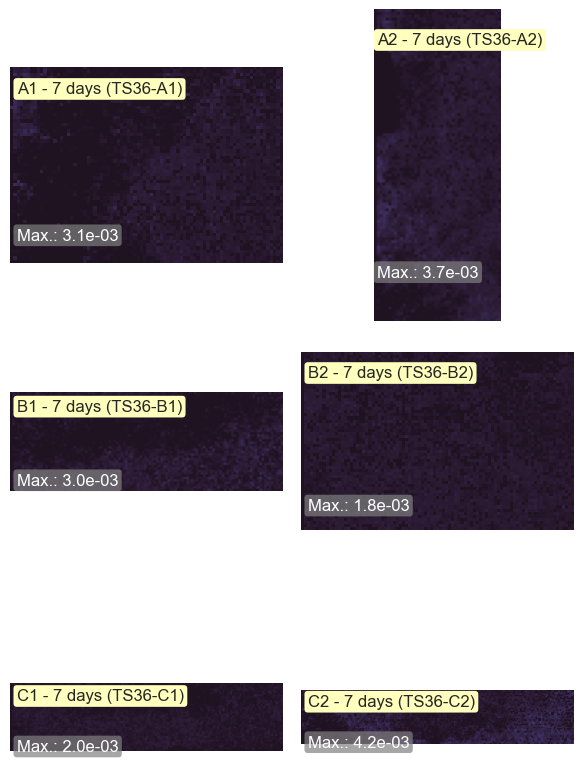

[Go back to index](#main_index)

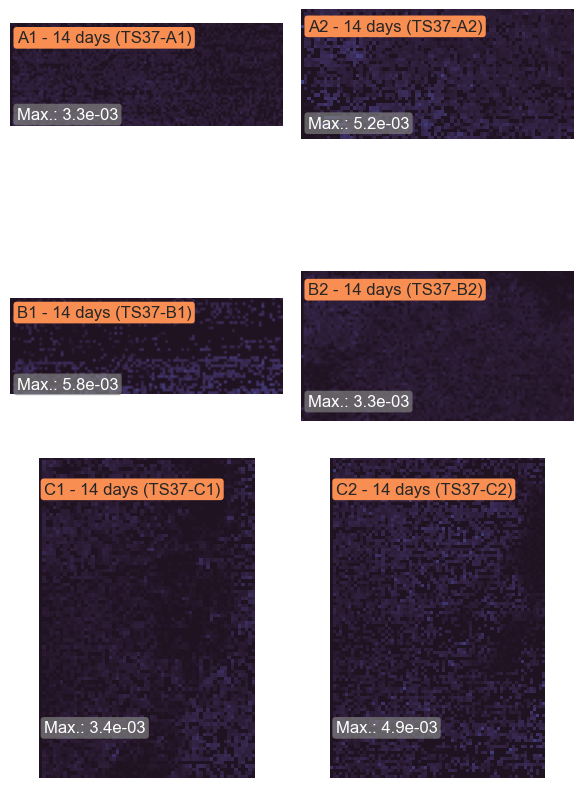

[Go back to index](#main_index)

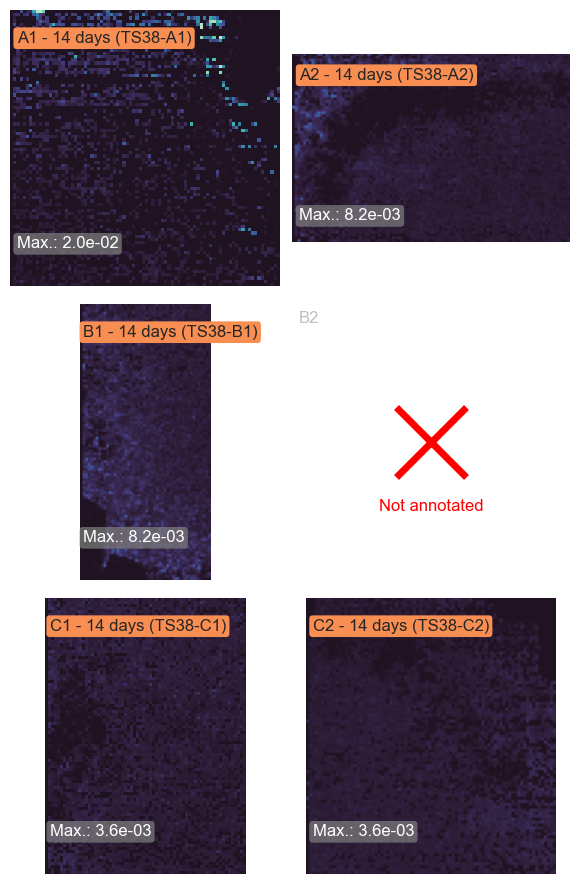

## C43H63NO7+NH4

Spirolide C

Joint colormap: for all wells/datasets, the same colormap is used to represent ion intensities.

[Go back to index](#main_index)

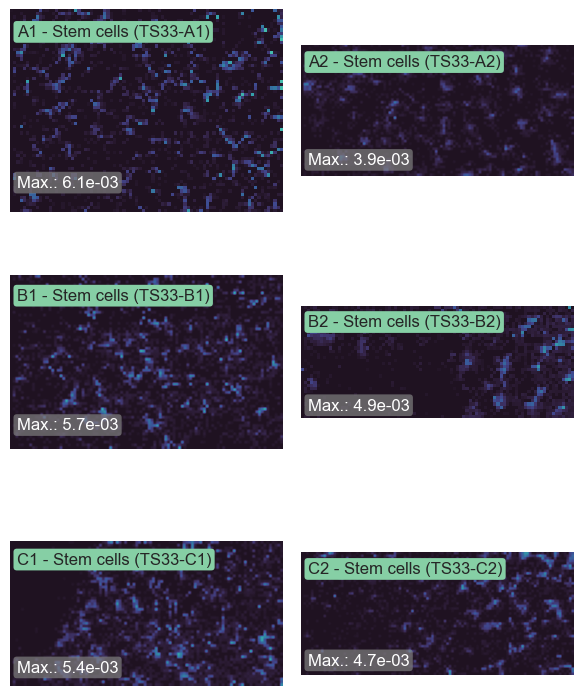

[Go back to index](#main_index)

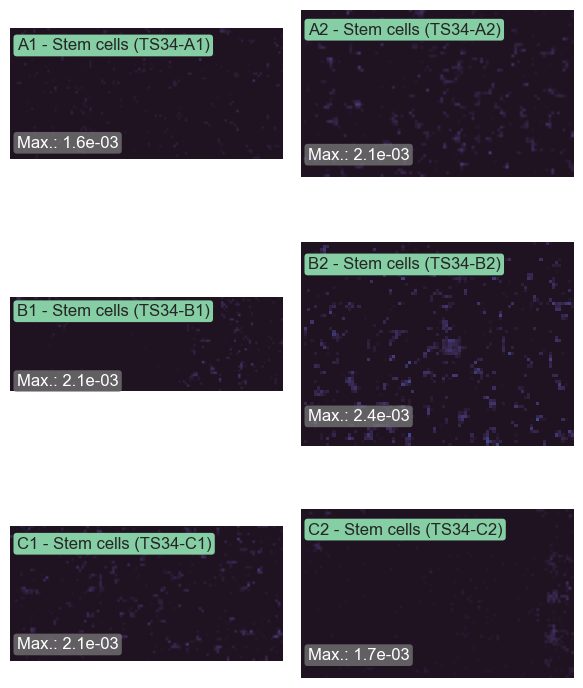

[Go back to index](#main_index)

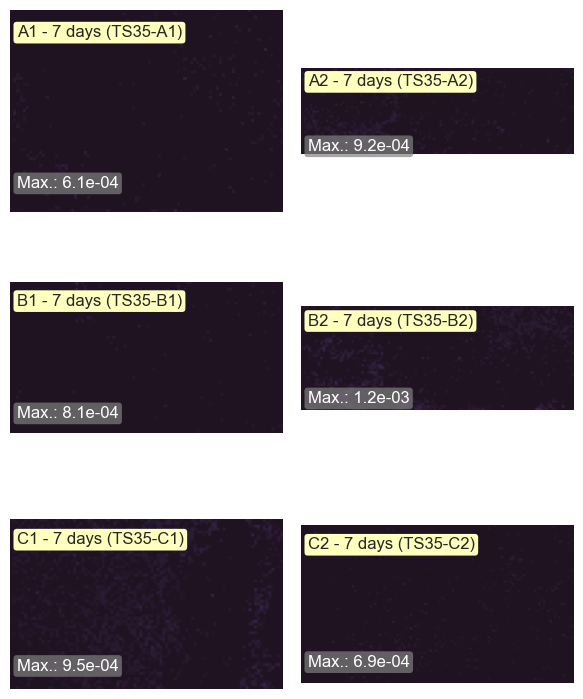

[Go back to index](#main_index)

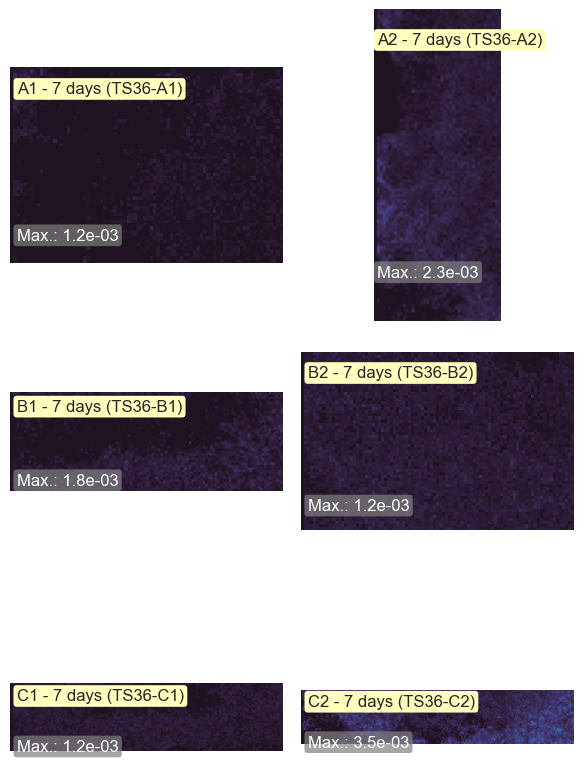

[Go back to index](#main_index)

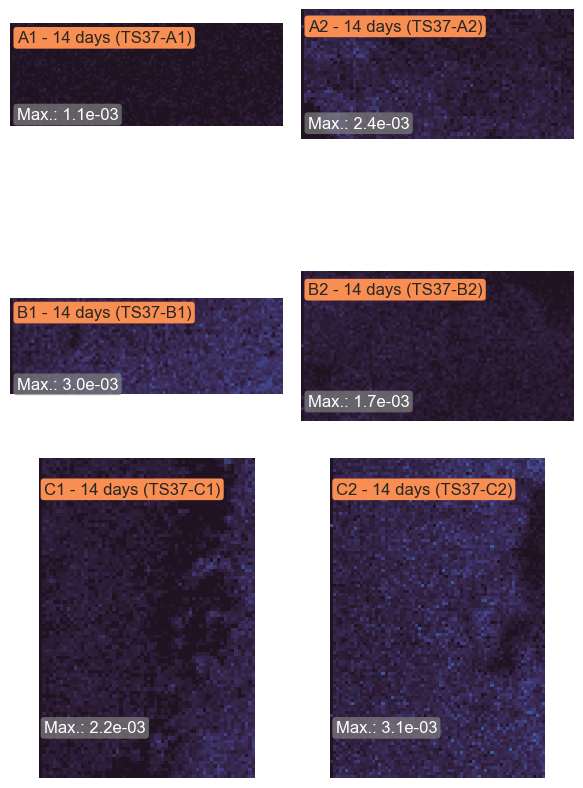

[Go back to index](#main_index)

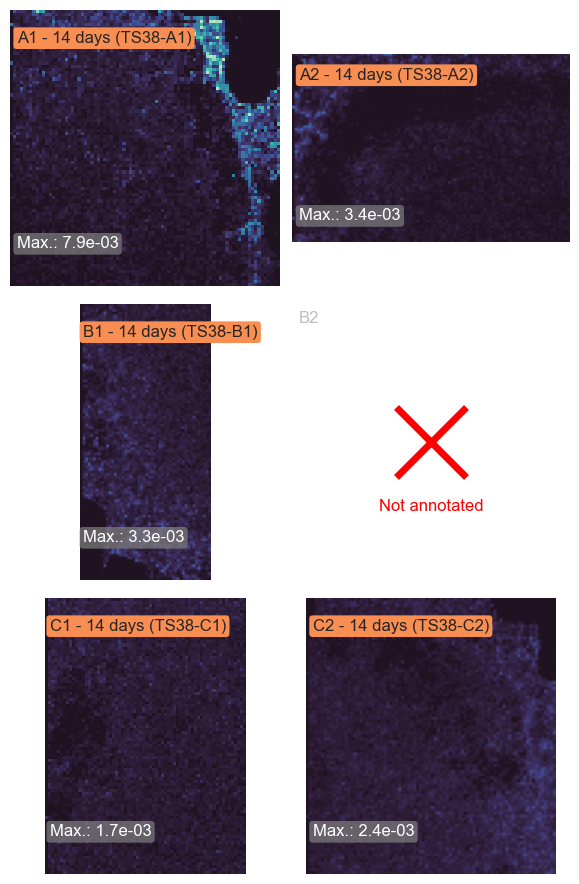

## C44H80NO8P+Na

PC(2:0/34:4(19Z,22Z,25Z,28Z)), PC(4:0/32:4(17Z,20Z,23Z,26Z)), PC(6:0/30:4(15Z,18Z,21Z,24Z)), PC(12:0/24:4(9Z,12Z,15Z,18Z)), PC(14:0/22:4(7Z,10Z,13Z,16Z)), PC(14:1(9Z)/22:3(10Z,13Z,16Z)), PC(16:0/20:4(5Z,8Z,11Z,14Z)), PC(16:0/20:4(8Z,11Z,14Z,17Z)), PC(16:1(6Z)/20:3(8Z,11Z,14Z)), PC(16:1(6Z)/20:3(11Z,14Z,17Z)), PC(16:1(9Z)/20:3(5Z,8Z,11Z)), PC(16:1(9Z)/20:3(8Z,11Z,14Z)), PC(18:0/18:4(6Z,9Z,12Z,15Z)), PC(18:1(6Z)/18:3(9Z,12Z,15Z)), PC(18:1(9Z)/18:3(6Z,9Z,12Z)), PC(18:1(9Z)/18:3(9Z,12Z,15Z)), PC(18:1(11E)/18:3(6Z,9Z,12Z)), PC(18:1(11E)/18:3(9Z,12Z,15Z)), PC(18:1(11Z)/18:3(6Z,9Z,12Z)), PC(18:1(11Z)/18:3(9Z,12Z,15Z)), PC(18:2(9Z,11E)/18:2(9Z,11E)), PC(18:2(9Z,12Z)/18:2(9Z,11E)), PC(18:2(9Z,12Z)/18:2(9Z,12Z)), PC(18:3(6Z,9Z,12Z)/18:1(6Z)), PC(18:3(6Z,9Z,12Z)/18:1(9Z)), PC(18:3(6Z,9Z,12Z)/18:1(11E)), PC(18:3(6Z,9Z,12Z)/18:1(11Z)), PC(18:3(9Z,12Z,15Z)/18:1(6Z)), PC(18:3(9Z,12Z,15Z)/18:1(9Z)), PC(18:3(9Z,12Z,15Z)/18:1(11E)), PC(18:3(9Z,12Z,15Z)/18:1(11Z)), PC(18:4(6Z,9Z,12Z,15Z)/18:0), PC(20:2(11Z,14Z)/16:2(9Z,12Z)), PC(20:3(5Z,8Z,11Z)/16:1(9Z)), PC(20:3(8Z,11Z,14Z)/16:1(6Z)), PC(20:3(8Z,11Z,14Z)/16:1(9Z)), PC(20:3(11Z,14Z,17Z)/16:1(9Z)), PC(20:4(5Z,8Z,11Z,14Z)/16:0), PC(20:4(8Z,11Z,14Z,17Z)/16:0), PC(22:4(7Z,10Z,13Z,16Z)/14:0), PC(24:4(9Z,12Z,15Z,18Z)/12:0), PC(26:4(11Z,14Z,17Z,20Z)/10:0), PC(28:4(13Z,16Z,19Z,22Z)/8:0), PC(30:4(15Z,18Z,21Z,24Z)/6:0), PC(32:4(17Z,20Z,23Z,26Z)/4:0), PC(34:4(19Z,22Z,25Z,28Z)/2:0), PE(13:0/26:4(11Z,14Z,17Z,20Z)), PE(15:0/24:4(9Z,12Z,15Z,18Z)), PE(17:0/22:4(7Z,10Z,13Z,16Z)), PE(18:4(6Z,9Z,12Z,15Z)/21:0), PE(19:0/20:4(8Z,11Z,14Z,17Z)), PE(20:4(5Z,8Z,11Z,14Z)/19:0), PE(22:4(7Z,10Z,13Z,16Z)/17:0), PE(24:4(9Z,12Z,15Z,18Z)/15:0), PE(26:4(11Z,14Z,17Z,20Z)/13:0), PE(36:4(21Z,24Z,27Z,30Z)/3:0), PE-NMe2(15:0/22:4(7Z,10Z,13Z,16Z)), PE-NMe2(22:4(7Z,10Z,13Z,16Z)/15:0), PE-NMe(16:0/22:4(7Z,10Z,13Z,16Z)), PE-NMe(18:0/20:4(5Z,8Z,11Z,14Z)), PE-NMe(18:0/20:4(8Z,11Z,14Z,17Z)), PE-NMe(18:1(9Z)/20:3(5Z,8Z,11Z)), PE-NMe(18:1(9Z)/20:3(8Z,11Z,14Z)), PE-NMe(18:1(11Z)/20:3(5Z,8Z,11Z)), PE-NMe(18:1(11Z)/20:3(8Z,11Z,14Z)), PE-NMe(18:2(9Z,12Z)/20:2(11Z,14Z)), PE-NMe(18:3(6Z,9Z,12Z)/20:1(11Z)), PE-NMe(18:3(9Z,12Z,15Z)/20:1(11Z)), PE-NMe(18:4(6Z,9Z,12Z,15Z)/20:0), PE-NMe(20:0/18:4(6Z,9Z,12Z,15Z)), PE-NMe(20:1(11Z)/18:3(6Z,9Z,12Z)), PE-NMe(20:1(11Z)/18:3(9Z,12Z,15Z)), PE-NMe(20:2(11Z,14Z)/18:2(9Z,12Z)), PE-NMe(20:3(5Z,8Z,11Z)/18:1(9Z)), PE-NMe(20:3(5Z,8Z,11Z)/18:1(11Z)), PE-NMe(20:3(8Z,11Z,14Z)/18:1(9Z)), PE-NMe(20:3(8Z,11Z,14Z)/18:1(11Z)), PE-NMe(20:4(5Z,8Z,11Z,14Z)/18:0), PE-NMe(20:4(8Z,11Z,14Z,17Z)/18:0), PE-NMe(22:4(7Z,10Z,13Z,16Z)/16:0)

Joint colormap: for all wells/datasets, the same colormap is used to represent ion intensities.

[Go back to index](#main_index)

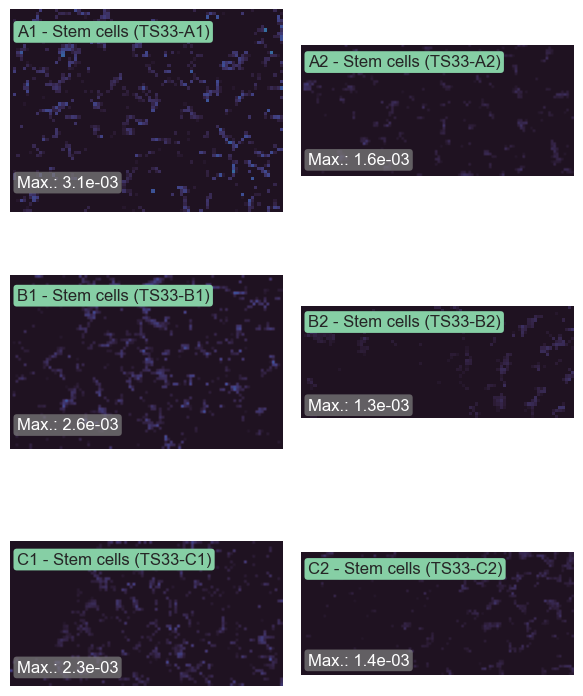

[Go back to index](#main_index)

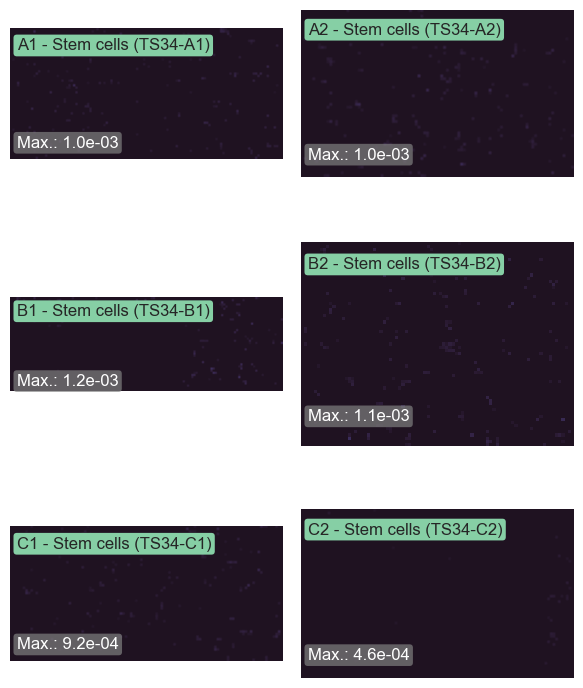

[Go back to index](#main_index)

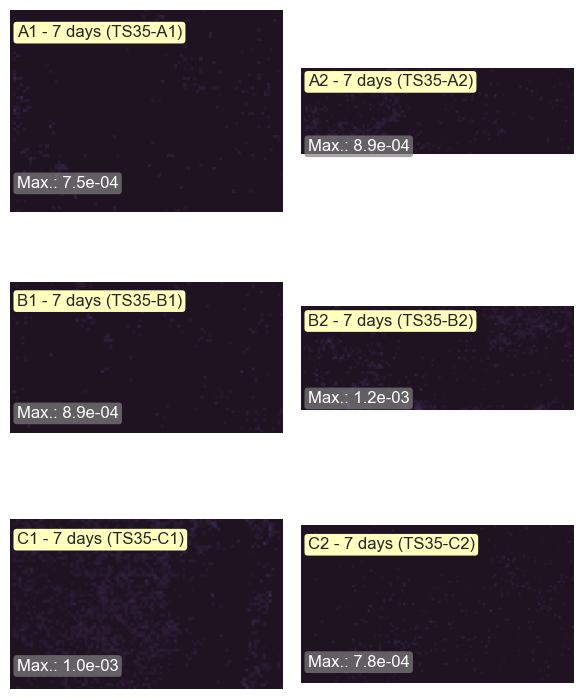

[Go back to index](#main_index)

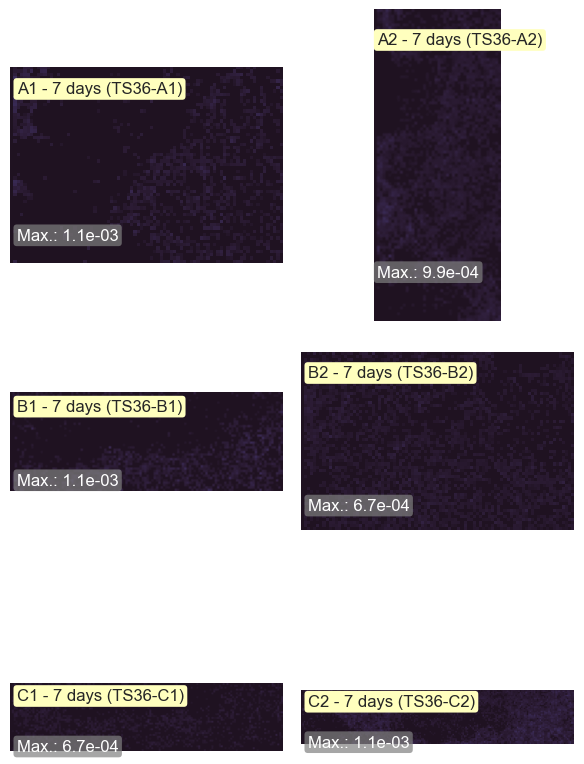

[Go back to index](#main_index)

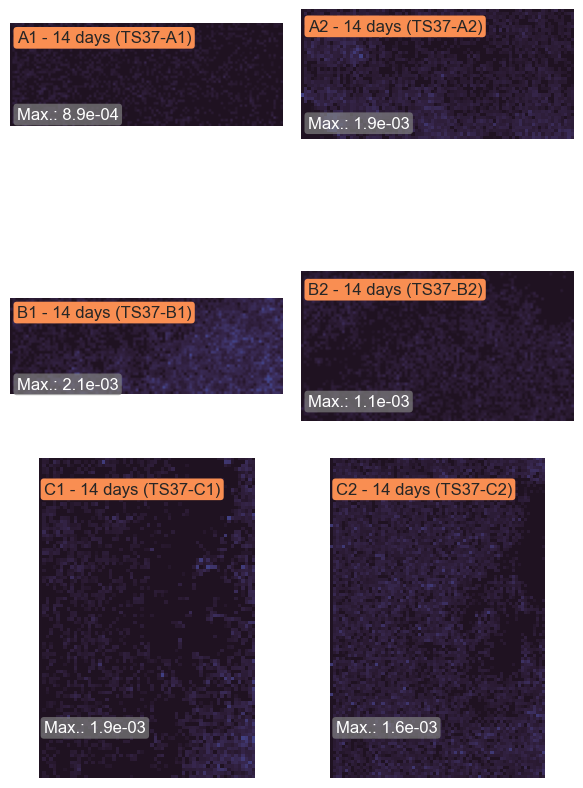

[Go back to index](#main_index)

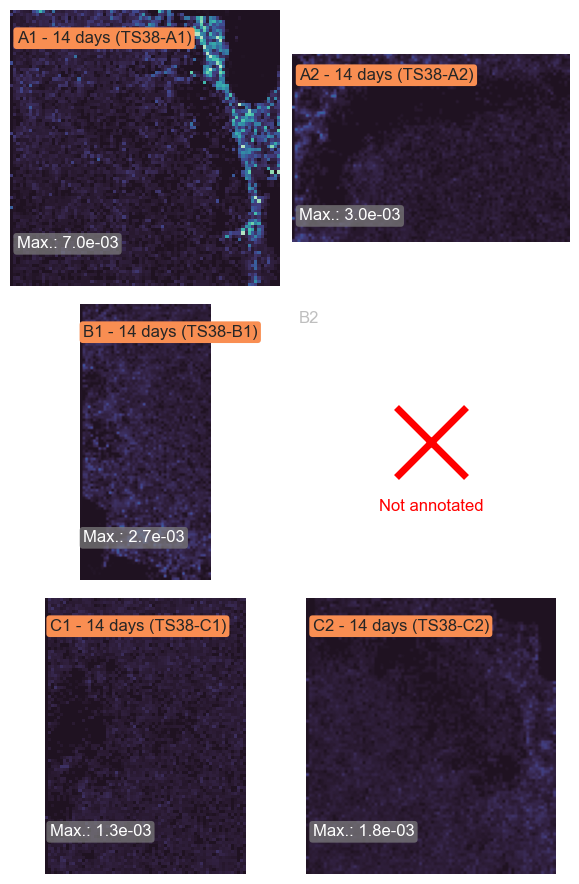

## C44H82NO8P+Na

PC(14:0/22:3(10Z,13Z,16Z)), PC(14:1(9Z)/22:2(13Z,16Z)), PC(16:0/20:3(5Z,8Z,11Z)), PC(16:0/20:3(8Z,11Z,14Z)), PC(16:0/20:3(11Z,14Z,17Z)), PC(16:1(6Z)/20:2(11Z,14Z)), PC(16:1(9Z)/20:2(11Z,14Z)), PC(16:2(9Z,12Z)/20:1(11Z)), PC(18:0/18:3(6Z,9Z,12Z)), PC(18:0/18:3(9Z,12Z,15Z)), PC(18:1(6Z)/18:2(9Z,11E)), PC(18:1(6Z)/18:2(9Z,12Z)), PC(18:1(9Z)/18:2(9Z,11E)), PC(18:1(9Z)/18:2(9Z,12Z)), PC(18:1(11E)/18:2(9Z,11E)), PC(18:1(11E)/18:2(9Z,12Z)), PC(18:1(11Z)/18:2(9Z,11E)), PC(18:1(11Z)/18:2(9Z,12Z)), PC(18:2(9Z,11E)/18:1(6Z)), PC(18:2(9Z,11E)/18:1(9Z)), PC(18:2(9Z,11E)/18:1(11E)), PC(18:2(9Z,11E)/18:1(11Z)), PC(18:2(9Z,12Z)/18:1(6Z)), PC(18:2(9Z,12Z)/18:1(9Z)), PC(18:2(9Z,12Z)/18:1(11E)), PC(18:2(9Z,12Z)/18:1(11Z)), PC(18:3(6Z,9Z,12Z)/18:0), PC(18:3(9Z,12Z,15Z)/18:0), PC(20:1(11Z)/16:2(9Z,12Z)), PC(20:2(11Z,14Z)/16:1(6Z)), PC(20:2(11Z,14Z)/16:1(9Z)), PC(20:3(5Z,8Z,11Z)/16:0), PC(20:3(8Z,11Z,14Z)/16:0), PC(20:3(11Z,14Z,17Z)/16:0), PC(22:2(13Z,16Z)/14:1(9Z)), PC(22:3(10Z,13Z,16Z)/14:0), PE(17:0/22:3(10Z,13Z,16Z)), PE(18:3(6Z,9Z,12Z)/21:0), PE(18:3(9Z,12Z,15Z)/21:0), PE(19:0/20:3(8Z,11Z,14Z)), PE(19:0/20:3(11Z,14Z,17Z)), PE(20:3(8Z,11Z,14Z)/19:0), PE(20:3(11Z,14Z,17Z)/19:0), PE(21:0/18:3(6Z,9Z,12Z)), PE(21:0/18:3(9Z,12Z,15Z)), PE(22:3(10Z,13Z,16Z)/17:0), PE-NMe(16:1(9Z)/22:2(13Z,16Z)), PE-NMe(18:0/20:3(5Z,8Z,11Z)), PE-NMe(18:0/20:3(8Z,11Z,14Z)), PE-NMe(18:1(9Z)/20:2(11Z,14Z)), PE-NMe(18:1(11Z)/20:2(11Z,14Z)), PE-NMe(18:2(9Z,12Z)/20:1(11Z)), PE-NMe(18:3(6Z,9Z,12Z)/20:0), PE-NMe(18:3(9Z,12Z,15Z)/20:0), PE-NMe(20:0/18:3(6Z,9Z,12Z)), PE-NMe(20:0/18:3(9Z,12Z,15Z)), PE-NMe(20:1(11Z)/18:2(9Z,12Z)), PE-NMe(20:2(11Z,14Z)/18:1(9Z)), PE-NMe(20:2(11Z,14Z)/18:1(11Z)), PE-NMe(20:3(5Z,8Z,11Z)/18:0), PE-NMe(20:3(8Z,11Z,14Z)/18:0), PE-NMe(22:2(13Z,16Z)/16:1(9Z))

Joint colormap: for all wells/datasets, the same colormap is used to represent ion intensities.

[Go back to index](#main_index)

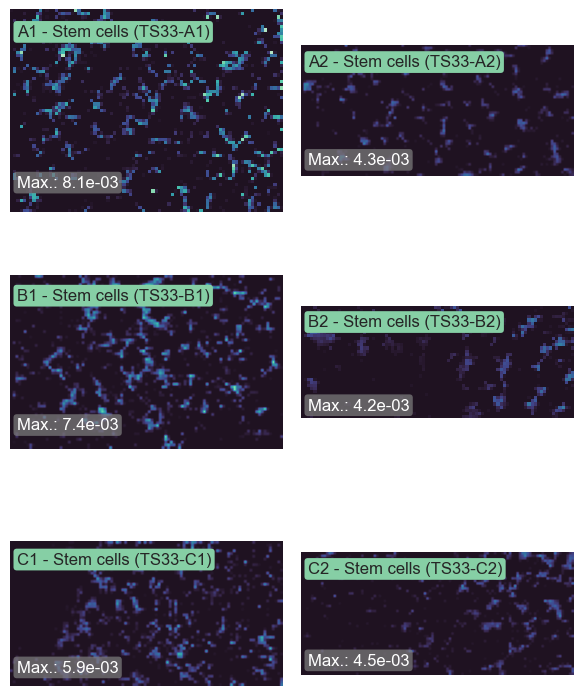

[Go back to index](#main_index)

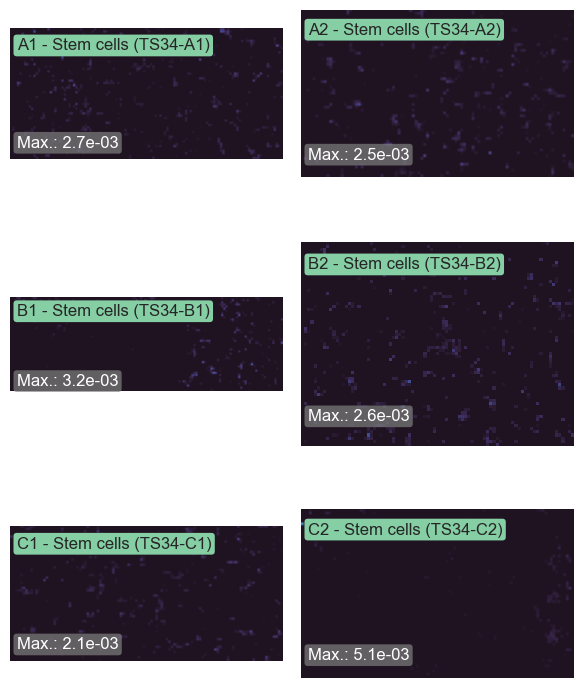

[Go back to index](#main_index)

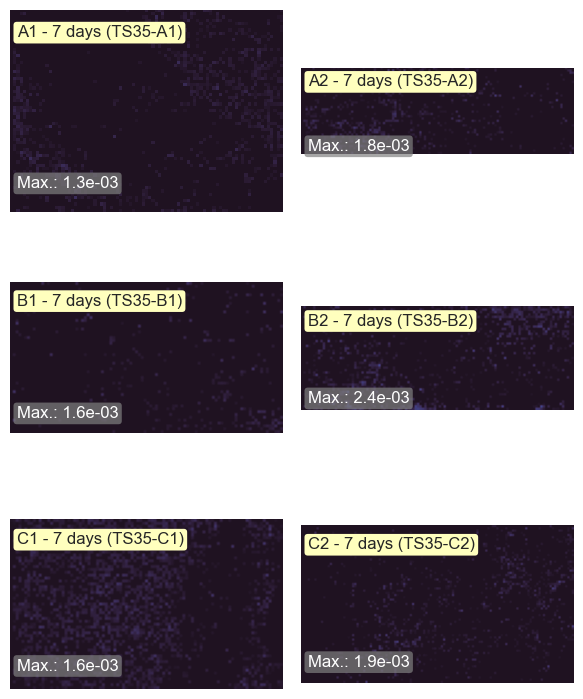

[Go back to index](#main_index)

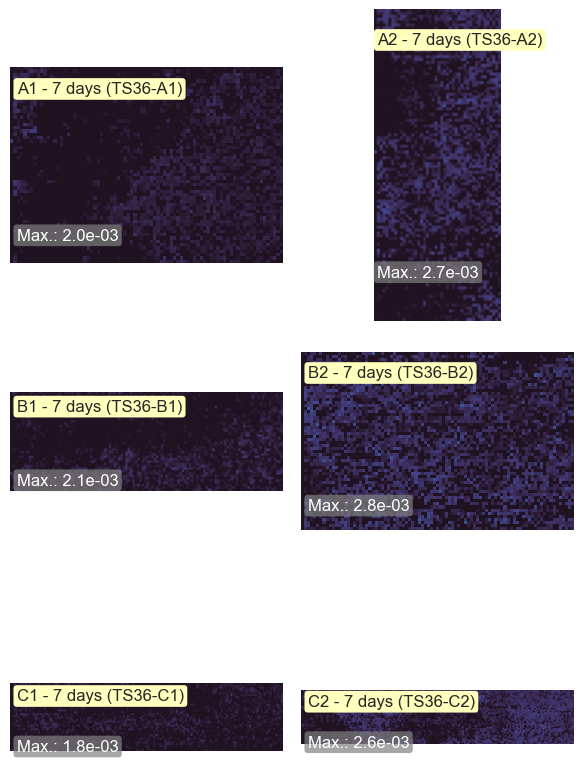

[Go back to index](#main_index)

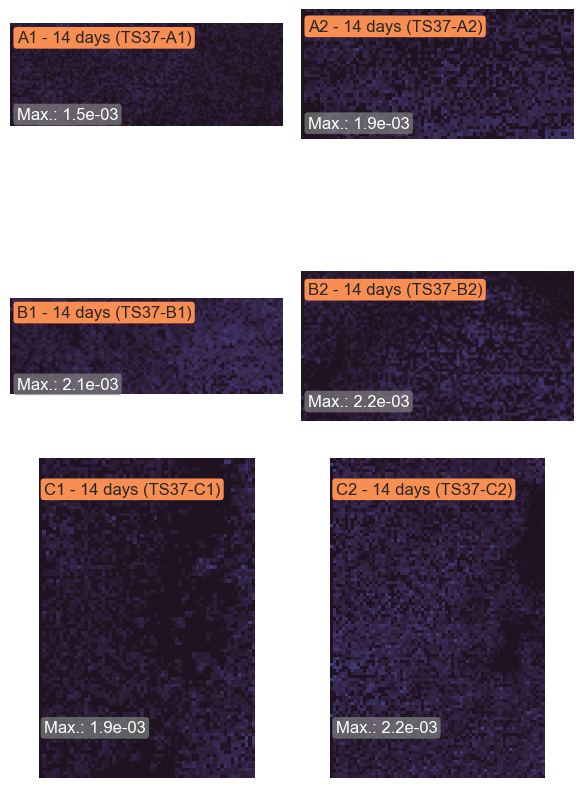

[Go back to index](#main_index)

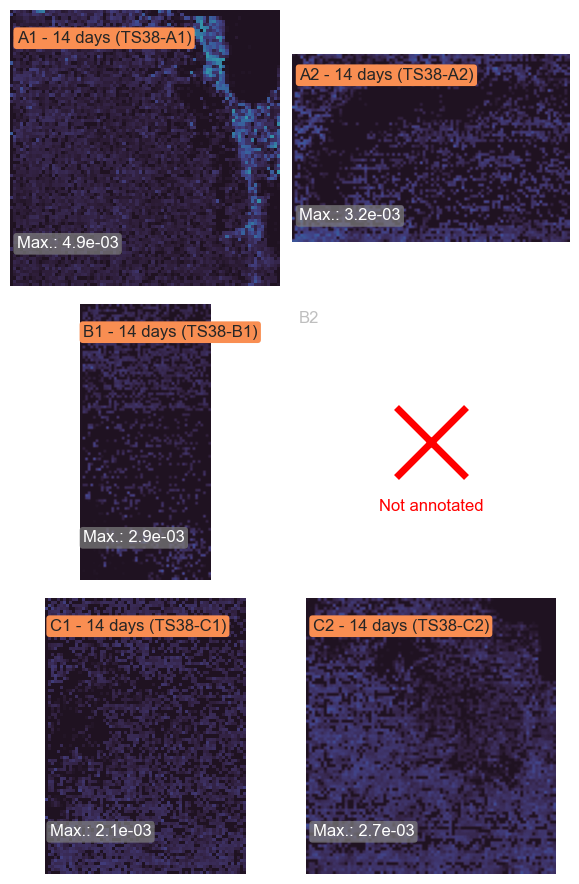

## C44H84NO8P+Na

1,2-dioleoyl-sn-glycero-3-phosphocholine, PC(14:0/22:2(13Z,16Z)), PC(14:1(9Z)/22:1(13Z)), PC(16:0/20:2(11Z,14Z)), PC(16:1(6Z)/20:1(11Z)), PC(16:1(9Z)/20:1(11Z)), PC(16:2(9Z,12Z)/20:0), PC(18:0/18:2(9Z,11E)), PC(18:0/18:2(9Z,12Z)), PC(18:1(6Z)/18:1(6Z)), PC(18:1(6Z)/18:1(9Z)), PC(18:1(6Z)/18:1(11E)), PC(18:1(6Z)/18:1(11Z)), PC(18:1(9Z)/18:1(6Z)), PC(18:1(9Z)/18:1(9Z)), PC(18:1(9Z)/18:1(11E)), PC(18:1(9Z)/18:1(11Z)), PC(18:1(11E)/18:1(6Z)), PC(18:1(11E)/18:1(9Z)), PC(18:1(11E)/18:1(11E)), PC(18:1(11E)/18:1(11Z)), PC(18:1(11Z)/18:1(6Z)), PC(18:1(11Z)/18:1(9Z)), PC(18:1(11Z)/18:1(11E)), PC(18:1(11Z)/18:1(11Z)), PC(18:2(9Z,11E)/18:0), PC(18:2(9Z,12Z)/18:0), PC(20:0/16:2(9Z,12Z)), PC(20:1(11Z)/16:1(6Z)), PC(20:1(11Z)/16:1(9Z)), PC(20:2(11Z,14Z)/16:0), PC(22:1(13Z)/14:1(9Z)), PC(22:2(13Z,16Z)/14:0), PE(17:0/22:2(13Z,16Z)), PE(18:2(9Z,11E)/21:0), PE(18:2(9Z,12Z)/21:0), PE(19:0/20:2(11Z,14Z)), PE(20:2(11Z,14Z)/19:0), PE(21:0/18:2(9Z,11E)), PE(21:0/18:2(9Z,12Z)), PE(22:2(13Z,16Z)/17:0), PE-NMe2(15:0/22:2(13Z,16Z)), PE-NMe2(22:2(13Z,16Z)/15:0), PE-NMe(14:1(9Z)/24:1(15Z)), PE-NMe(16:0/22:2(13Z,16Z)), PE-NMe(16:1(9Z)/22:1(13Z)), PE-NMe(18:0/20:2(11Z,14Z)), PE-NMe(18:1(9Z)/20:1(11Z)), PE-NMe(18:1(11Z)/20:1(11Z)), PE-NMe(18:2(9Z,12Z)/20:0), PE-NMe(20:0/18:2(9Z,12Z)), PE-NMe(20:1(11Z)/18:1(9Z)), PE-NMe(20:1(11Z)/18:1(11Z)), PE-NMe(20:2(11Z,14Z)/18:0), PE-NMe(22:1(13Z)/16:1(9Z)), PE-NMe(22:2(13Z,16Z)/16:0), PE-NMe(24:1(15Z)/14:1(9Z))

Joint colormap: for all wells/datasets, the same colormap is used to represent ion intensities.

[Go back to index](#main_index)

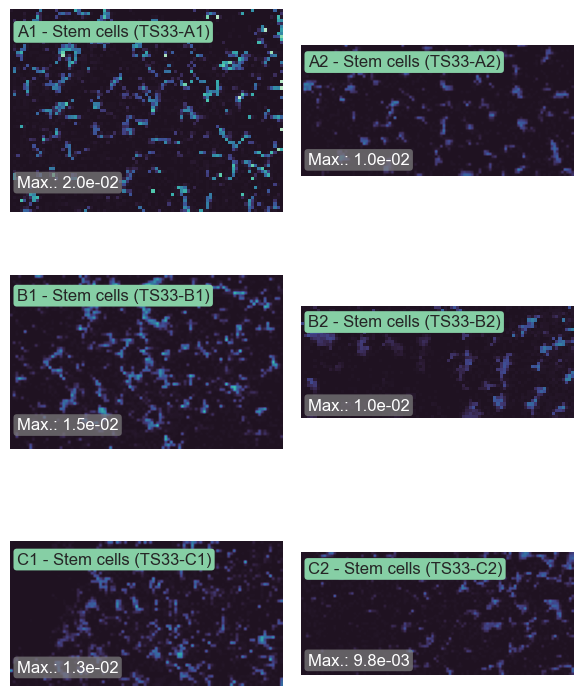

[Go back to index](#main_index)

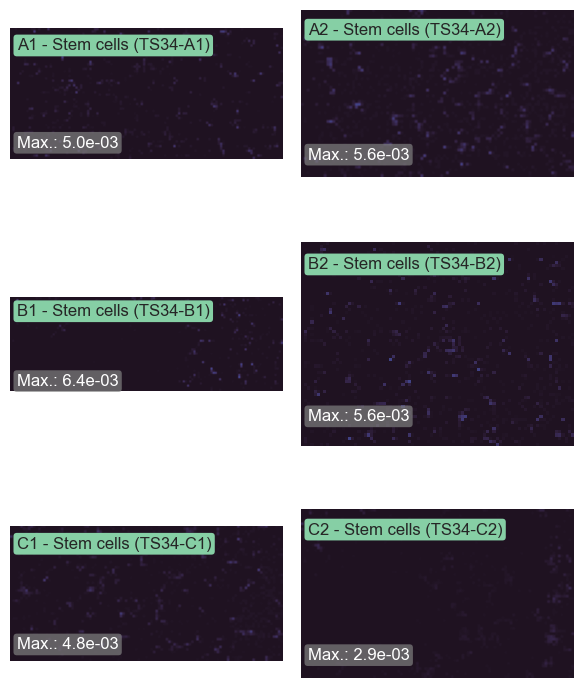

[Go back to index](#main_index)

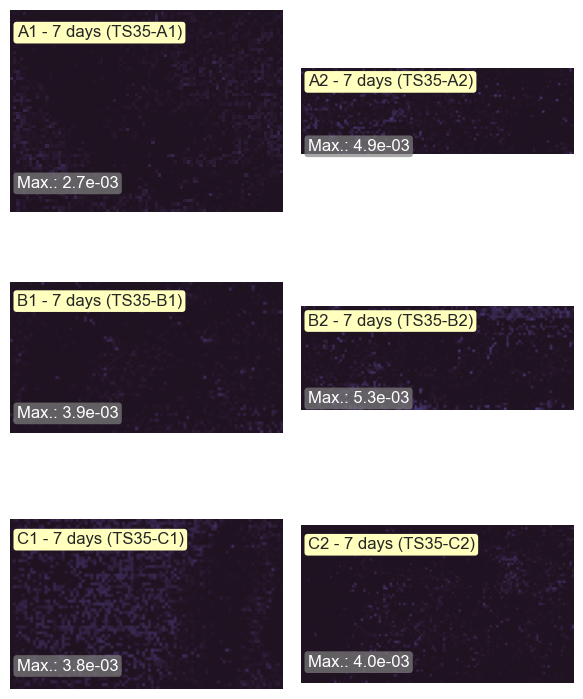

[Go back to index](#main_index)

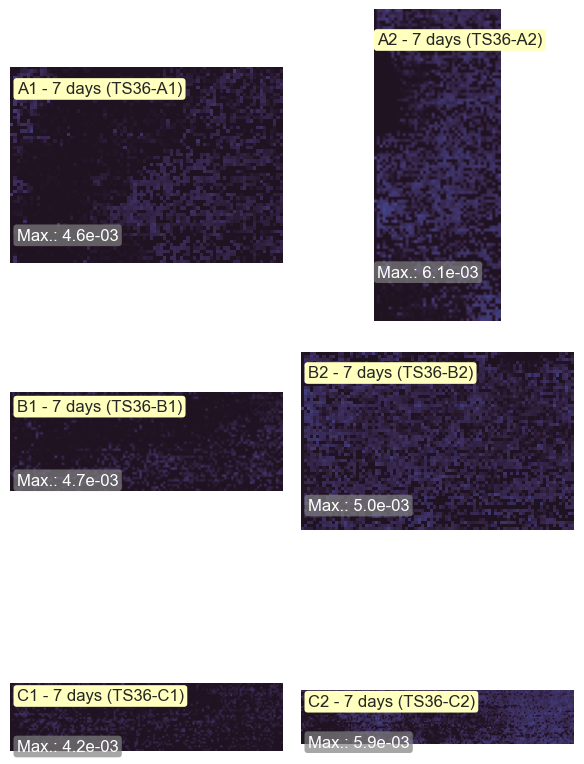

[Go back to index](#main_index)

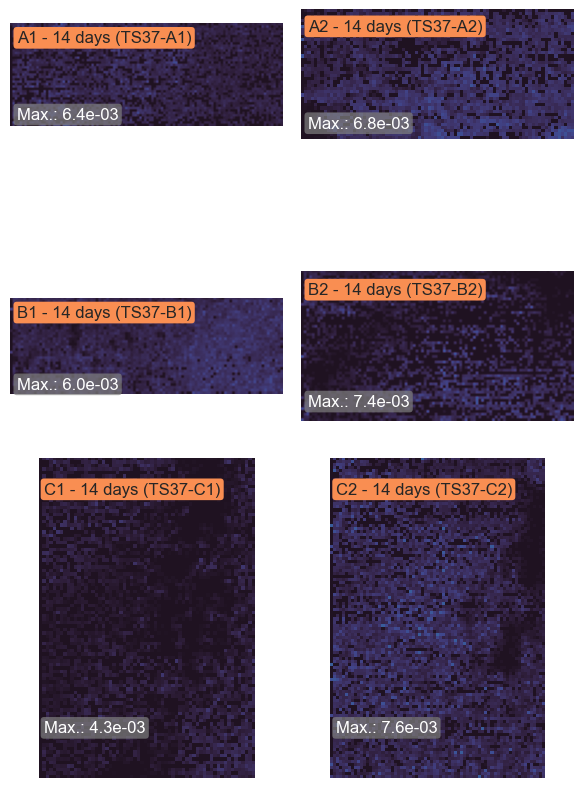

[Go back to index](#main_index)

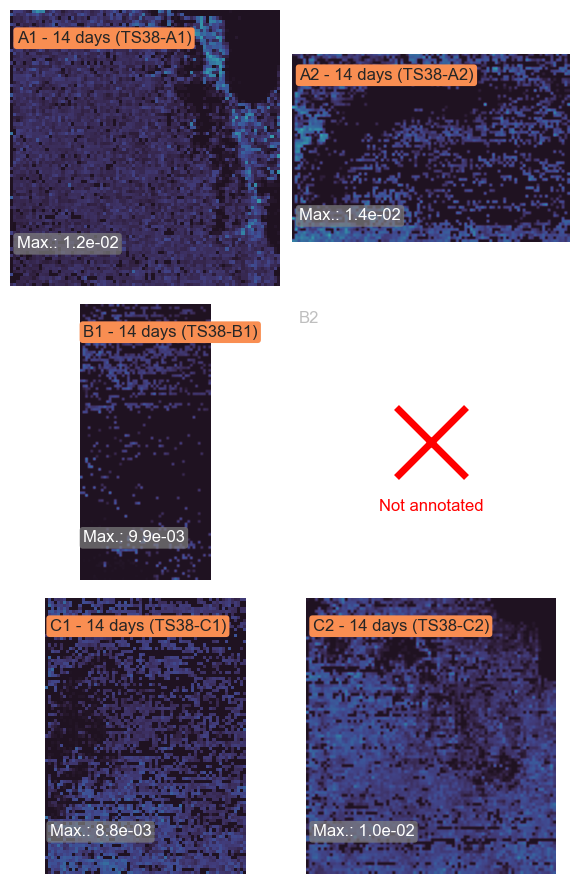

## C45H79O8P+NH4

PA(4:0/38:5(20Z,23Z,26Z,29Z,32Z)), PA(4:0/38:5(23Z,26Z,29Z,32Z,35Z)), PA(6:0/36:5(18Z,21Z,24Z,27Z,30Z)), PA(6:0/36:5(21Z,24Z,27Z,30Z,33Z)), PA(8:0/34:5(16Z,19Z,22Z,25Z,28Z)), PA(10:0/32:5(14Z,17Z,20Z,23Z,26Z)), PA(10:0/32:5(17Z,20Z,23Z,26Z,29Z)), PA(12:0/30:5(12Z,15Z,18Z,21Z,24Z)), PA(14:0/28:5(10Z,13Z,16Z,19Z,22Z)), PA(14:0/28:5(13Z,16Z,19Z,22Z,25Z)), PA(16:0/26:5(8Z,11Z,14Z,17Z,20Z)), PA(16:0/26:5(11Z,14Z,17Z,20Z,23Z)), PA(16:1(6Z)/26:4(11Z,14Z,17Z,20Z)), PA(16:1(9Z)/26:4(11Z,14Z,17Z,20Z)), PA(18:0/24:5(9Z,12Z,15Z,18Z,21Z)), PA(18:1(6Z)/24:4(9Z,12Z,15Z,18Z)), PA(18:1(11E)/24:4(9Z,12Z,15Z,18Z)), PA(18:1(11Z)/24:4(9Z,12Z,15Z,18Z)), PA(18:4(6Z,9Z,12Z,15Z)/24:1(15Z)), PA(20:0/22:5(4Z,7Z,10Z,13Z,16Z)), PA(20:0/22:5(7Z,10Z,13Z,16Z,19Z)), PA(20:1(11Z)/22:4(7Z,10Z,13Z,16Z)), PA(20:2(11Z,14Z)/22:3(10Z,13Z,16Z)), PA(20:3(5Z,8Z,11Z)/22:2(13Z,16Z)), PA(20:3(8Z,11Z,14Z)/22:2(13Z,16Z)), PA(20:3(11Z,14Z,17Z)/22:2(13Z,16Z)), PA(20:4(5Z,8Z,11Z,14Z)/22:1(13Z)), PA(20:4(8Z,11Z,14Z,17Z)/22:1(13Z)), PA(20:5(5Z,8Z,11Z,14Z,17Z)/22:0), PA(22:0/20:5(5Z,8Z,11Z,14Z,17Z)), PA(22:1(13Z)/20:4(5Z,8Z,11Z,14Z)), PA(22:1(13Z)/20:4(8Z,11Z,14Z,17Z)), PA(22:2(13Z,16Z)/20:3(5Z,8Z,11Z)), PA(22:2(13Z,16Z)/20:3(8Z,11Z,14Z)), PA(22:2(13Z,16Z)/20:3(11Z,14Z,17Z)), PA(22:3(10Z,13Z,16Z)/20:2(11Z,14Z)), PA(22:4(7Z,10Z,13Z,16Z)/20:1(11Z)), PA(22:5(4Z,7Z,10Z,13Z,16Z)/20:0), PA(22:5(7Z,10Z,13Z,16Z,19Z)/20:0), PA(24:1(15Z)/18:4(6Z,9Z,12Z,15Z)), PA(24:4(9Z,12Z,15Z,18Z)/18:1(6Z)), PA(24:4(9Z,12Z,15Z,18Z)/18:1(9Z)), PA(24:4(9Z,12Z,15Z,18Z)/18:1(11Z)), PA(24:5(6Z,9Z,12Z,15Z,18Z)/18:0), PA(24:5(9Z,12Z,15Z,18Z,21Z)/18:0), PA(26:4(11Z,14Z,17Z,20Z)/16:1(6Z)), PA(26:4(11Z,14Z,17Z,20Z)/16:1(9Z)), PA(26:5(11Z,14Z,17Z,20Z,23Z)/16:0), PA(28:4(13Z,16Z,19Z,22Z)/14:1(9Z)), PA(28:5(13Z,16Z,19Z,22Z,25Z)/14:0), PA(30:5(12Z,15Z,18Z,21Z,24Z)/12:0), PA(30:5(15Z,18Z,21Z,24Z,27Z)/12:0), PA(32:5(17Z,20Z,23Z,26Z,29Z)/10:0), PA(34:5(16Z,19Z,22Z,25Z,28Z)/8:0), PA(34:5(19Z,22Z,25Z,28Z,31Z)/8:0), PA(36:5(21Z,24Z,27Z,30Z,33Z)/6:0), PA(38:5(20Z,23Z,26Z,29Z,32Z)/4:0)

Joint colormap: for all wells/datasets, the same colormap is used to represent ion intensities.

[Go back to index](#main_index)

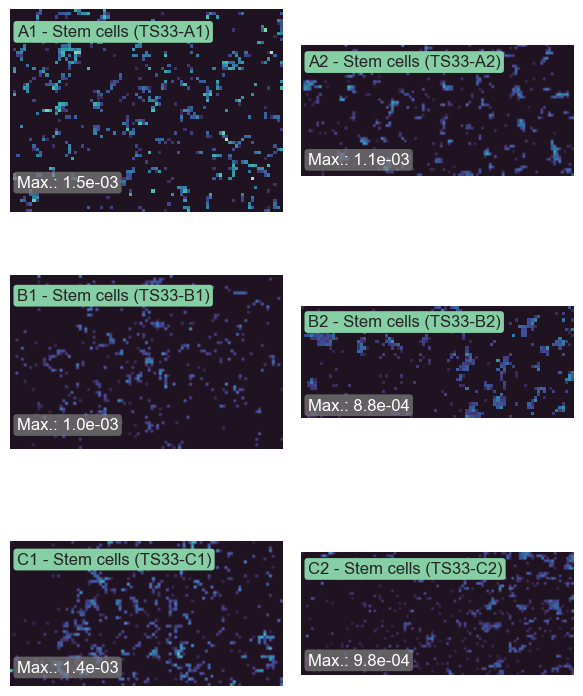

[Go back to index](#main_index)

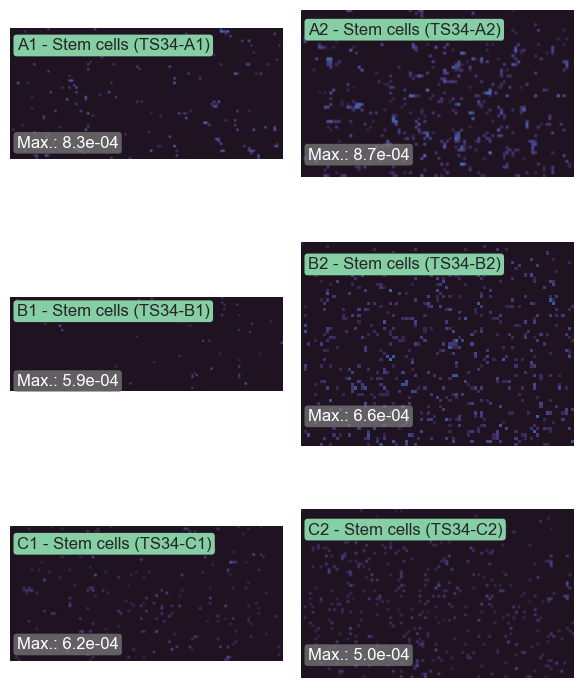

[Go back to index](#main_index)

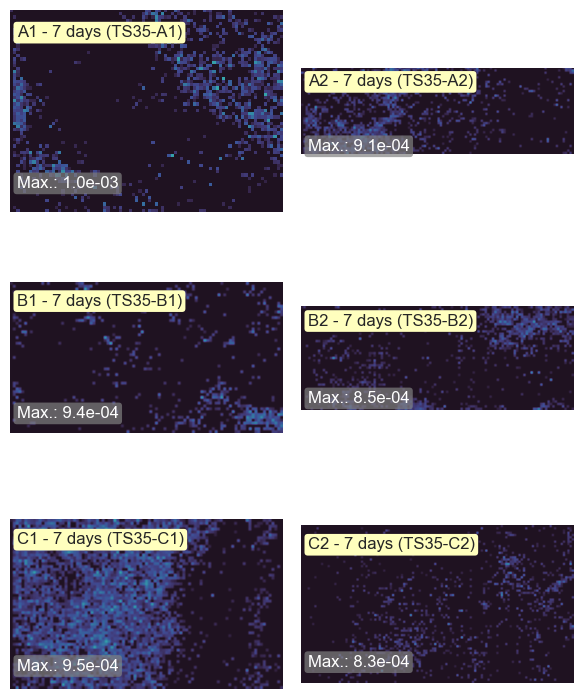

[Go back to index](#main_index)

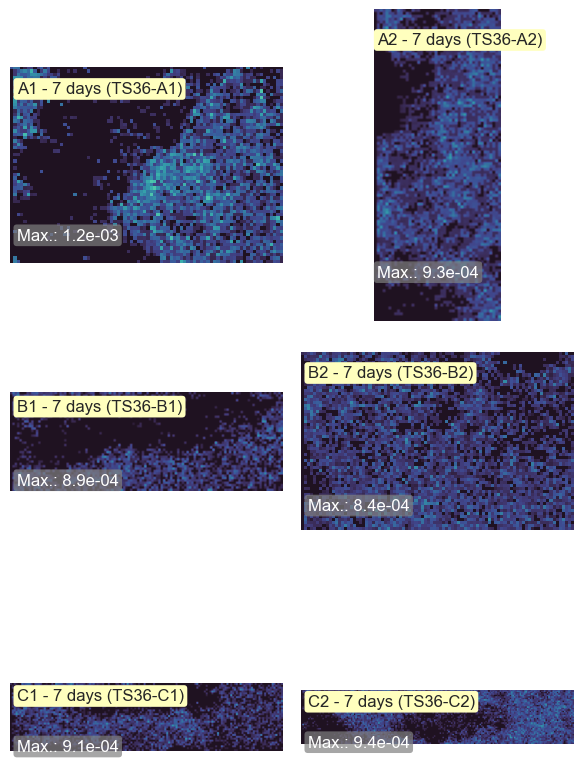

[Go back to index](#main_index)

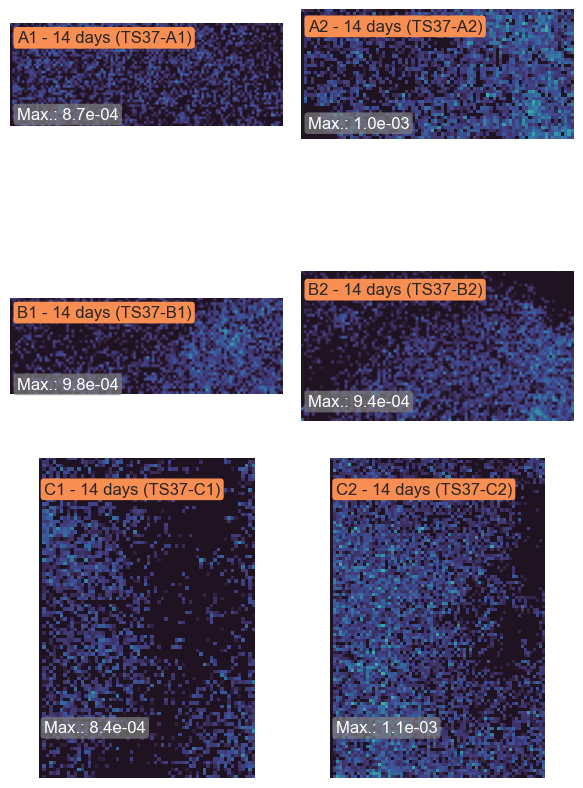

[Go back to index](#main_index)

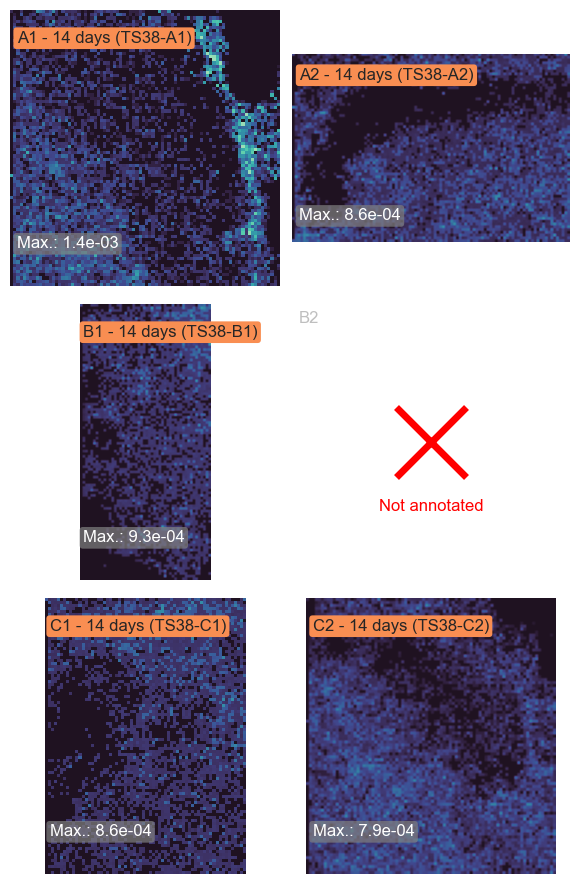

## C45H82NO8P+H

1-Octadecanoyl-2-(7Z,10Z,13Z,16Z-docosatetraenoyl)-sn-glycero-3-phosphoethanolamine, PC(3:0/34:4(19Z,22Z,25Z,28Z)), PC(13:0/24:4(9Z,12Z,15Z,18Z)), PC(15:0/22:4(7Z,10Z,13Z,16Z)), PC(17:0/20:4(5Z,8Z,11Z,14Z)), PC(17:0/20:4(8Z,11Z,14Z,17Z)), PC(18:4(6Z,9Z,12Z,15Z)/19:0), PC(20:4(5Z,8Z,11Z,14Z)/17:0), PC(20:4(8Z,11Z,14Z,17Z)/17:0), PC(22:4(7Z,10Z,13Z,16Z)/15:0), PC(24:4(9Z,12Z,15Z,18Z)/13:0), PC(34:4(19Z,22Z,25Z,28Z)/3:0), PE(2:0/38:4(23Z,26Z,29Z,32Z)), PE(4:0/36:4(21Z,24Z,27Z,30Z)), PE(6:0/34:4(19Z,22Z,25Z,28Z)), PE(8:0/32:4(17Z,20Z,23Z,26Z)), PE(10:0/30:4(15Z,18Z,21Z,24Z)), PE(12:0/28:4(13Z,16Z,19Z,22Z)), PE(14:0/26:4(11Z,14Z,17Z,20Z)), PE(16:0/24:4(9Z,12Z,15Z,18Z)), PE(18:0/22:4(7Z,10Z,13Z,16Z)), PE(18:1(6Z)/22:3(10Z,13Z,16Z)), PE(18:1(9Z)/22:3(10Z,13Z,16Z)), PE(18:1(11E)/22:3(10Z,13Z,16Z)), PE(18:1(11Z)/22:3(10Z,13Z,16Z)), PE(18:2(9Z,12Z)/22:2(13Z,16Z)), PE(18:3(6Z,9Z,12Z)/22:1(13Z)), PE(18:3(9Z,12Z,15Z)/22:1(13Z)), PE(18:4(6Z,9Z,12Z,15Z)/22:0), PE(20:0/20:4(5Z,8Z,11Z,14Z)), PE(20:0/20:4(8Z,11Z,14Z,17Z)), PE(20:1(11Z)/20:3(5Z,8Z,11Z)), PE(20:1(11Z)/20:3(8Z,11Z,14Z)), PE(20:2(11Z,14Z)/20:2(11Z,14Z)), PE(20:3(5Z,8Z,11Z)/20:1(11Z)), PE(20:3(8Z,11Z,14Z)/20:1(11Z)), PE(20:3(11Z,14Z,17Z)/20:1(11Z)), PE(20:4(5Z,8Z,11Z,14Z)/20:0), PE(20:4(8Z,11Z,14Z,17Z)/20:0), PE(22:0/18:4(6Z,9Z,12Z,15Z)), PE(22:1(13Z)/18:3(6Z,9Z,12Z)), PE(22:1(13Z)/18:3(9Z,12Z,15Z)), PE(22:2(13Z,16Z)/18:2(9Z,11E)), PE(22:2(13Z,16Z)/18:2(9Z,12Z)), PE(22:3(10Z,13Z,16Z)/18:1(6Z)), PE(22:3(10Z,13Z,16Z)/18:1(9Z)), PE(22:3(10Z,13Z,16Z)/18:1(11E)), PE(22:3(10Z,13Z,16Z)/18:1(11Z)), PE(22:4(7Z,10Z,13Z,16Z)/18:0), PE(24:4(9Z,12Z,15Z,18Z)/16:0), PE(26:4(11Z,14Z,17Z,20Z)/14:0), PE(28:4(13Z,16Z,19Z,22Z)/12:0), PE(30:4(15Z,18Z,21Z,24Z)/10:0), PE(32:4(17Z,20Z,23Z,26Z)/8:0), PE(34:4(19Z,22Z,25Z,28Z)/6:0), PE-NMe2(16:0/22:4(7Z,10Z,13Z,16Z)), PE-NMe2(18:0/20:4(5Z,8Z,11Z,14Z)), PE-NMe2(18:0/20:4(8Z,11Z,14Z,17Z)), PE-NMe2(18:1(9Z)/20:3(5Z,8Z,11Z)), PE-NMe2(18:1(9Z)/20:3(8Z,11Z,14Z)), PE-NMe2(18:1(11Z)/20:3(5Z,8Z,11Z)), PE-NMe2(18:1(11Z)/20:3(8Z,11Z,14Z)), PE-NMe2(18:2(9Z,12Z)/20:2(11Z,14Z)), PE-NMe2(18:3(6Z,9Z,12Z)/20:1(11Z)), PE-NMe2(18:3(9Z,12Z,15Z)/20:1(11Z)), PE-NMe2(18:4(6Z,9Z,12Z,15Z)/20:0), PE-NMe2(20:0/18:4(6Z,9Z,12Z,15Z)), PE-NMe2(20:1(11Z)/18:3(6Z,9Z,12Z)), PE-NMe2(20:1(11Z)/18:3(9Z,12Z,15Z)), PE-NMe2(20:2(11Z,14Z)/18:2(9Z,12Z)), PE-NMe2(20:3(5Z,8Z,11Z)/18:1(9Z)), PE-NMe2(20:3(5Z,8Z,11Z)/18:1(11Z)), PE-NMe2(20:3(8Z,11Z,14Z)/18:1(9Z)), PE-NMe2(20:3(8Z,11Z,14Z)/18:1(11Z)), PE-NMe2(20:4(5Z,8Z,11Z,14Z)/18:0), PE-NMe2(20:4(8Z,11Z,14Z,17Z)/18:0), PE-NMe2(22:4(7Z,10Z,13Z,16Z)/16:0)

Joint colormap: for all wells/datasets, the same colormap is used to represent ion intensities.

[Go back to index](#main_index)

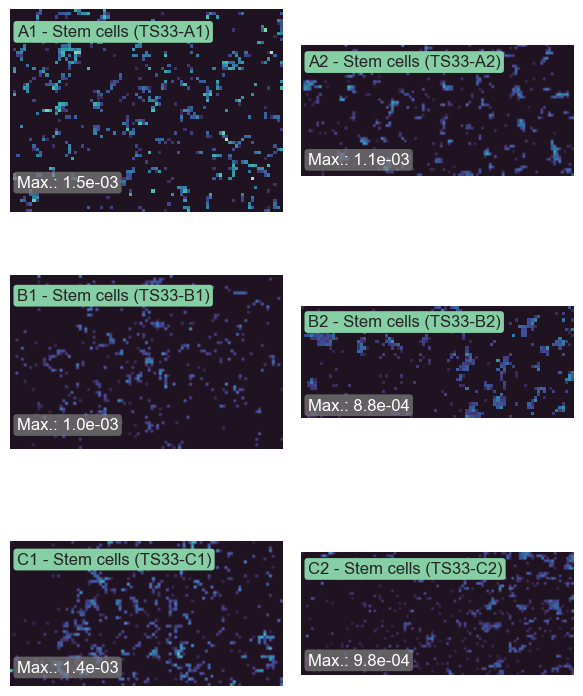

[Go back to index](#main_index)

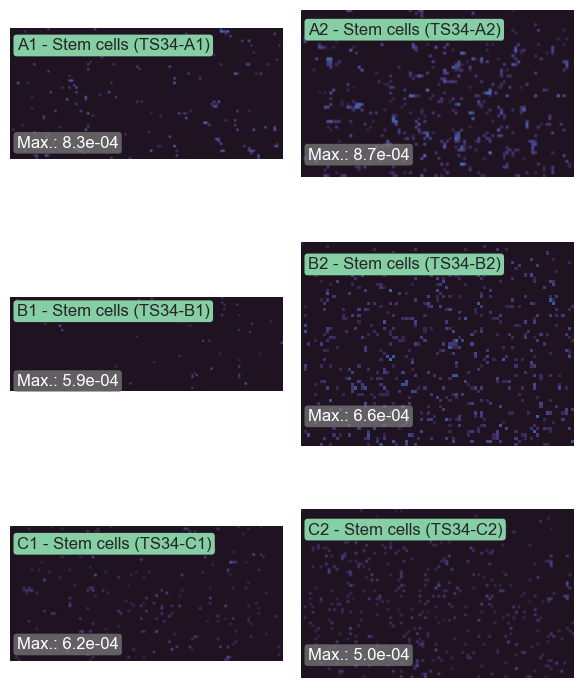

[Go back to index](#main_index)

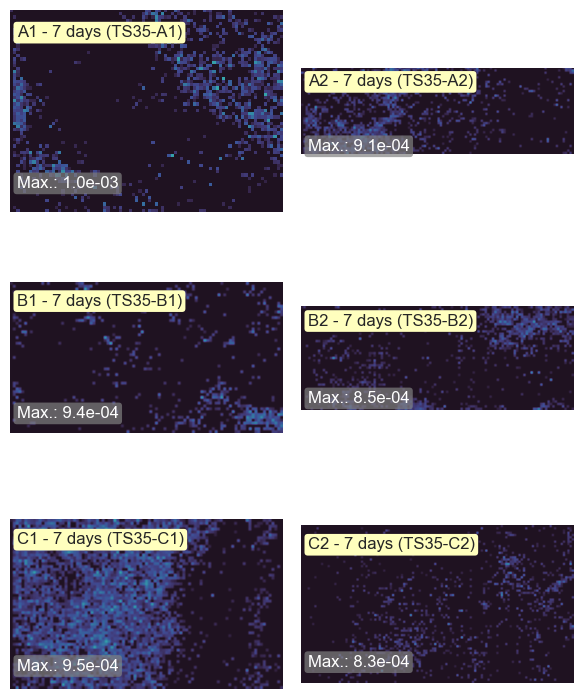

[Go back to index](#main_index)

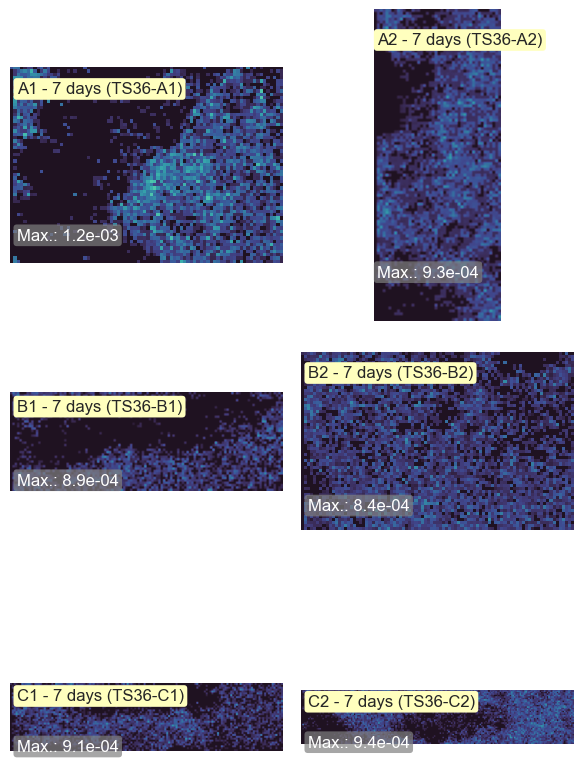

[Go back to index](#main_index)

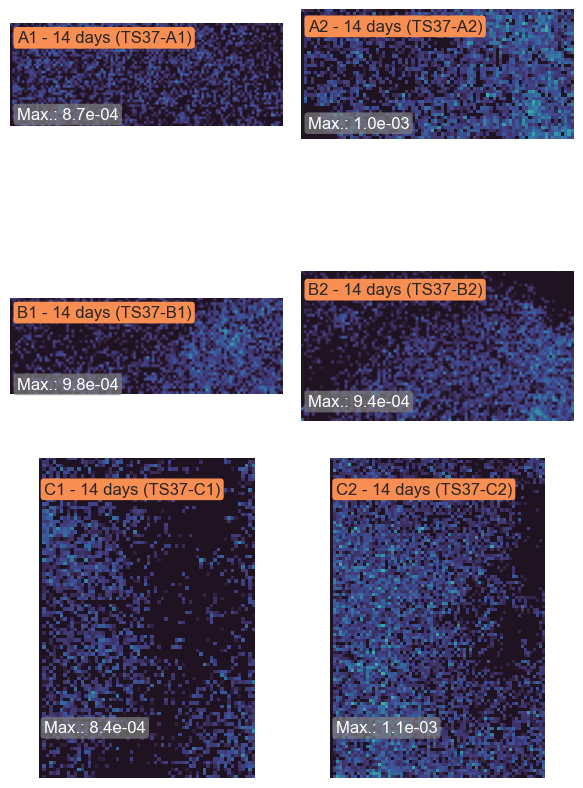

[Go back to index](#main_index)

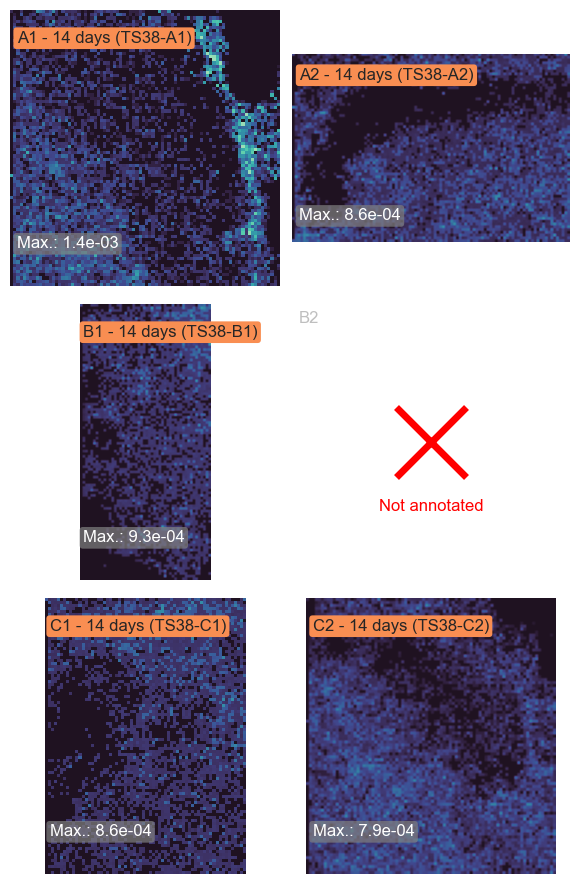

## C46H80NO8P+H

PC(2:0/36:6(18Z,21Z,24Z,27Z,30Z,33Z)), PC(4:0/34:6(16Z,19Z,22Z,25Z,28Z,31Z)), PC(8:0/30:6(12Z,15Z,18Z,21Z,24Z,27Z)), PC(10:0/28:6(10Z,13Z,16Z,19Z,22Z,25Z)), PC(12:0/26:6(8Z,11Z,14Z,17Z,20Z,23Z)), PC(14:0/24:6(6Z,9Z,12Z,15Z,18Z,21Z)), PC(14:1(9Z)/24:5(6Z,9Z,12Z,15Z,18Z)), PC(14:1(9Z)/24:5(9Z,12Z,15Z,18Z,21Z)), PC(16:0/22:6(4Z,7Z,10Z,13Z,16Z,19Z)), PC(16:1(6Z)/22:5(4Z,7Z,10Z,13Z,16Z)), PC(16:1(6Z)/22:5(7Z,10Z,13Z,16Z,19Z)), PC(16:1(9Z)/22:5(4Z,7Z,10Z,13Z,16Z)), PC(16:1(9Z)/22:5(7Z,10Z,13Z,16Z,19Z)), PC(18:1(9Z)/20:5(5Z,8Z,11Z,14Z,17Z)), PC(18:1(11Z)/20:5(5Z,8Z,11Z,14Z,17Z)), PC(18:2(9Z,11E)/20:4(5Z,8Z,11Z,14Z)), PC(18:2(9Z,12Z)/20:4(5Z,8Z,11Z,14Z)), PC(18:2(9Z,12Z)/20:4(8Z,11Z,14Z,17Z)), PC(18:3(6Z,9Z,12Z)/20:3(5Z,8Z,11Z)), PC(18:3(6Z,9Z,12Z)/20:3(8Z,11Z,14Z)), PC(18:3(9Z,12Z,15Z)/20:3(5Z,8Z,11Z)), PC(18:3(9Z,12Z,15Z)/20:3(8Z,11Z,14Z)), PC(18:4(6Z,9Z,12Z,15Z)/20:2(11Z,14Z)), PC(20:2(11Z,14Z)/18:4(6Z,9Z,12Z,15Z)), PC(20:3(5Z,8Z,11Z)/18:3(6Z,9Z,12Z)), PC(20:3(5Z,8Z,11Z)/18:3(9Z,12Z,15Z)), PC(20:3(8Z,11Z,14Z)/18:3(6Z,9Z,12Z)), PC(20:3(8Z,11Z,14Z)/18:3(9Z,12Z,15Z)), PC(20:3(11Z,14Z,17Z)/18:3(6Z,9Z,12Z)), PC(20:3(11Z,14Z,17Z)/18:3(9Z,12Z,15Z)), PC(20:4(5Z,8Z,11Z,14Z)/18:2(9Z,11E)), PC(20:4(5Z,8Z,11Z,14Z)/18:2(9Z,12Z)), PC(20:4(8Z,11Z,14Z,17Z)/18:2(9Z,11E)), PC(20:4(8Z,11Z,14Z,17Z)/18:2(9Z,12Z)), PC(20:5(5Z,8Z,11Z,14Z,17Z)/18:1(6Z)), PC(20:5(5Z,8Z,11Z,14Z,17Z)/18:1(9Z)), PC(20:5(5Z,8Z,11Z,14Z,17Z)/18:1(11E)), PC(20:5(5Z,8Z,11Z,14Z,17Z)/18:1(11Z)), PC(22:4(7Z,10Z,13Z,16Z)/16:2(9Z,12Z)), PC(22:5(4Z,7Z,10Z,13Z,16Z)/16:1(6Z)), PC(22:5(4Z,7Z,10Z,13Z,16Z)/16:1(9Z)), PC(22:5(7Z,10Z,13Z,16Z,19Z)/16:1(6Z)), PC(22:5(7Z,10Z,13Z,16Z,19Z)/16:1(9Z)), PC(22:6(4Z,7Z,10Z,13Z,16Z,19Z)/16:0), PC(24:6(6Z,9Z,12Z,15Z,18Z,21Z)/14:0), PC(26:6(8Z,11Z,14Z,17Z,20Z,23Z)/12:0), PC(28:6(10Z,13Z,16Z,19Z,22Z,25Z)/10:0), PC(30:6(12Z,15Z,18Z,21Z,24Z,27Z)/8:0), PC(34:6(16Z,19Z,22Z,25Z,28Z,31Z)/4:0), PC(36:6(18Z,21Z,24Z,27Z,30Z,33Z)/2:0), PE(13:0/28:6(10Z,13Z,16Z,19Z,22Z,25Z)), PE(15:0/26:6(8Z,11Z,14Z,17Z,20Z,23Z)), PE(17:0/24:6(6Z,9Z,12Z,15Z,18Z,21Z)), PE(22:6(4Z,7Z,10Z,13Z,16Z,19Z)/19:0), PE(26:6(8Z,11Z,14Z,17Z,20Z,23Z)/15:0), PE(28:6(10Z,13Z,16Z,19Z,22Z,25Z)/13:0), PE-NMe(18:0/22:6(4Z,7Z,10Z,13Z,16Z,19Z)), PE-NMe(18:1(9Z)/22:5(4Z,7Z,10Z,13Z,16Z)), PE-NMe(18:1(9Z)/22:5(7Z,10Z,13Z,16Z,19Z)), PE-NMe(18:1(11Z)/22:5(4Z,7Z,10Z,13Z,16Z)), PE-NMe(18:1(11Z)/22:5(7Z,10Z,13Z,16Z,19Z)), PE-NMe(18:2(9Z,12Z)/22:4(7Z,10Z,13Z,16Z)), PE-NMe(18:4(6Z,9Z,12Z,15Z)/22:2(13Z,16Z)), PE-NMe(20:1(11Z)/20:5(5Z,8Z,11Z,14Z,17Z)), PE-NMe(20:2(11Z,14Z)/20:4(5Z,8Z,11Z,14Z)), PE-NMe(20:2(11Z,14Z)/20:4(8Z,11Z,14Z,17Z)), PE-NMe(20:3(5Z,8Z,11Z)/20:3(5Z,8Z,11Z)), PE-NMe(20:3(5Z,8Z,11Z)/20:3(8Z,11Z,14Z)), PE-NMe(20:3(8Z,11Z,14Z)/20:3(5Z,8Z,11Z)), PE-NMe(20:3(8Z,11Z,14Z)/20:3(8Z,11Z,14Z)), PE-NMe(20:4(5Z,8Z,11Z,14Z)/20:2(11Z,14Z)), PE-NMe(20:4(8Z,11Z,14Z,17Z)/20:2(11Z,14Z)), PE-NMe(20:5(5Z,8Z,11Z,14Z,17Z)/20:1(11Z)), PE-NMe(22:2(13Z,16Z)/18:4(6Z,9Z,12Z,15Z)), PE-NMe(22:4(7Z,10Z,13Z,16Z)/18:2(9Z,12Z)), PE-NMe(22:5(4Z,7Z,10Z,13Z,16Z)/18:1(9Z)), PE-NMe(22:5(4Z,7Z,10Z,13Z,16Z)/18:1(11Z)), PE-NMe(22:5(7Z,10Z,13Z,16Z,19Z)/18:1(9Z)), PE-NMe(22:5(7Z,10Z,13Z,16Z,19Z)/18:1(11Z)), PE-NMe(22:6(4Z,7Z,10Z,13Z,16Z,19Z)/18:0)

Joint colormap: for all wells/datasets, the same colormap is used to represent ion intensities.

[Go back to index](#main_index)

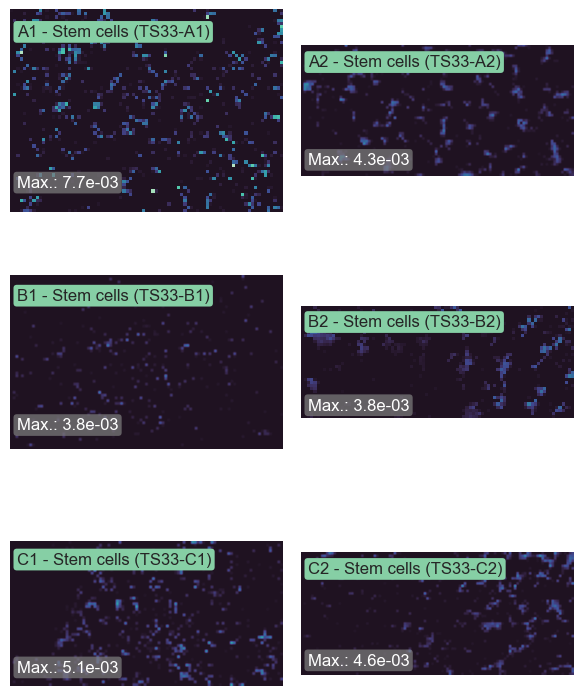

[Go back to index](#main_index)

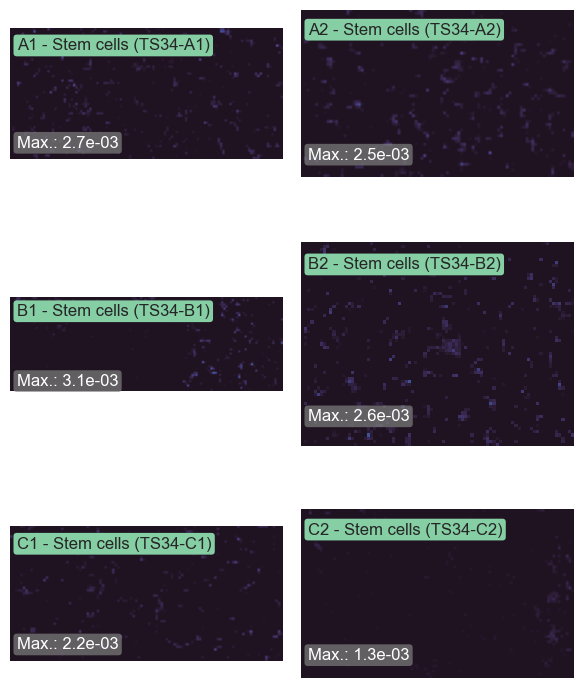

[Go back to index](#main_index)

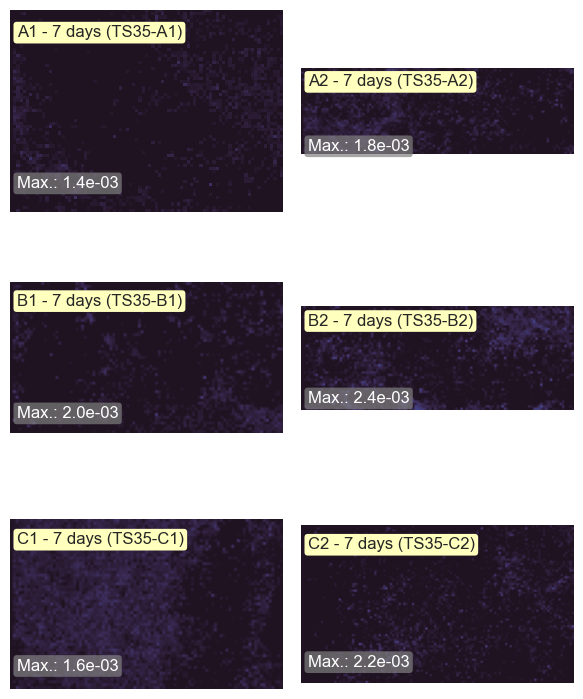

[Go back to index](#main_index)

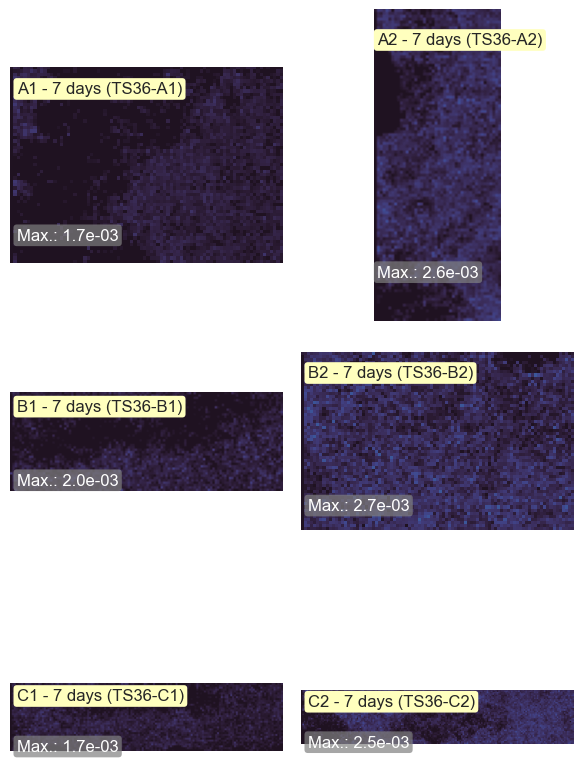

[Go back to index](#main_index)

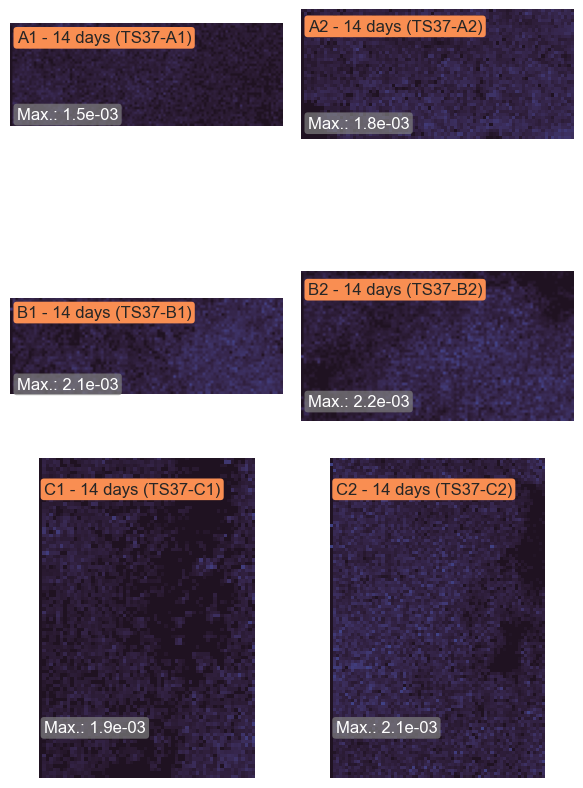

[Go back to index](#main_index)

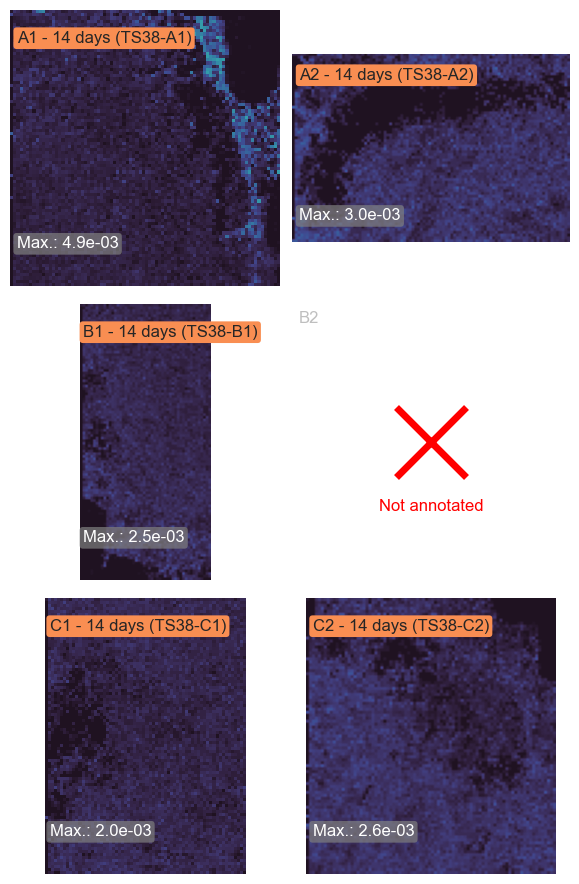

## C46H84NO8P+Na

PC(2:0/36:4(21Z,24Z,27Z,30Z)), PC(4:0/34:4(19Z,22Z,25Z,28Z)), PC(6:0/32:4(17Z,20Z,23Z,26Z)), PC(10:0/28:4(13Z,16Z,19Z,22Z)), PC(12:0/26:4(11Z,14Z,17Z,20Z)), PC(14:0/24:4(9Z,12Z,15Z,18Z)), PC(16:0/22:4(7Z,10Z,13Z,16Z)), PC(16:1(9Z)/22:3(10Z,13Z,16Z)), PC(16:2(9Z,12Z)/22:2(13Z,16Z)), PC(18:0/20:4(5Z,8Z,11Z,14Z)), PC(18:0/20:4(8Z,11Z,14Z,17Z)), PC(18:1(6Z)/20:3(8Z,11Z,14Z)), PC(18:1(9Z)/20:3(5Z,8Z,11Z)), PC(18:1(9Z)/20:3(8Z,11Z,14Z)), PC(18:1(9Z)/20:3(11Z,14Z,17Z)), PC(18:1(11E)/20:3(8Z,11Z,14Z)), PC(18:1(11Z)/20:3(5Z,8Z,11Z)), PC(18:1(11Z)/20:3(8Z,11Z,14Z)), PC(18:1(11Z)/20:3(11Z,14Z,17Z)), PC(18:2(9Z,11E)/20:2(11Z,14Z)), PC(18:2(9Z,12Z)/20:2(11Z,14Z)), PC(18:3(6Z,9Z,12Z)/20:1(11Z)), PC(18:3(9Z,12Z,15Z)/20:1(11Z)), PC(18:4(6Z,9Z,12Z,15Z)/20:0), PC(20:0/18:4(6Z,9Z,12Z,15Z)), PC(20:1(11Z)/18:3(6Z,9Z,12Z)), PC(20:1(11Z)/18:3(9Z,12Z,15Z)), PC(20:2(11Z,14Z)/18:2(9Z,11E)), PC(20:2(11Z,14Z)/18:2(9Z,12Z)), PC(20:3(5Z,8Z,11Z)/18:1(9Z)), PC(20:3(5Z,8Z,11Z)/18:1(11Z)), PC(20:3(8Z,11Z,14Z)/18:1(9Z)), PC(20:3(8Z,11Z,14Z)/18:1(11E)), PC(20:3(8Z,11Z,14Z)/18:1(11Z)), PC(20:3(11Z,14Z,17Z)/18:1(6Z)), PC(20:3(11Z,14Z,17Z)/18:1(9Z)), PC(20:4(5Z,8Z,11Z,14Z)/18:0), PC(20:4(8Z,11Z,14Z,17Z)/18:0), PC(22:3(10Z,13Z,16Z)/16:1(6Z)), PC(22:3(10Z,13Z,16Z)/16:1(9Z)), PC(22:4(7Z,10Z,13Z,16Z)/16:0), PC(24:4(9Z,12Z,15Z,18Z)/14:0), PC(26:4(11Z,14Z,17Z,20Z)/12:0), PC(32:4(17Z,20Z,23Z,26Z)/6:0), PC(34:4(19Z,22Z,25Z,28Z)/4:0), PE(3:0/38:4(23Z,26Z,29Z,32Z)), PE(13:0/28:4(13Z,16Z,19Z,22Z)), PE(15:0/26:4(11Z,14Z,17Z,20Z)), PE(17:0/24:4(9Z,12Z,15Z,18Z)), PE(19:0/22:4(7Z,10Z,13Z,16Z)), PE(20:4(5Z,8Z,11Z,14Z)/21:0), PE(21:0/20:4(5Z,8Z,11Z,14Z)), PE(21:0/20:4(8Z,11Z,14Z,17Z)), PE(22:4(7Z,10Z,13Z,16Z)/19:0), PE(24:4(9Z,12Z,15Z,18Z)/17:0), PE(28:4(13Z,16Z,19Z,22Z)/13:0), PE(38:4(23Z,26Z,29Z,32Z)/3:0), PE-NMe(18:0/22:4(7Z,10Z,13Z,16Z)), PE-NMe(18:2(9Z,12Z)/22:2(13Z,16Z)), PE-NMe(18:3(6Z,9Z,12Z)/22:1(13Z)), PE-NMe(18:3(9Z,12Z,15Z)/22:1(13Z)), PE-NMe(18:4(6Z,9Z,12Z,15Z)/22:0), PE-NMe(20:0/20:4(5Z,8Z,11Z,14Z)), PE-NMe(20:0/20:4(8Z,11Z,14Z,17Z)), PE-NMe(20:1(11Z)/20:3(5Z,8Z,11Z)), PE-NMe(20:1(11Z)/20:3(8Z,11Z,14Z)), PE-NMe(20:2(11Z,14Z)/20:2(11Z,14Z)), PE-NMe(20:3(5Z,8Z,11Z)/20:1(11Z)), PE-NMe(20:3(8Z,11Z,14Z)/20:1(11Z)), PE-NMe(20:4(5Z,8Z,11Z,14Z)/20:0), PE-NMe(20:4(8Z,11Z,14Z,17Z)/20:0), PE-NMe(22:0/18:4(6Z,9Z,12Z,15Z)), PE-NMe(22:1(13Z)/18:3(6Z,9Z,12Z)), PE-NMe(22:1(13Z)/18:3(9Z,12Z,15Z)), PE-NMe(22:2(13Z,16Z)/18:2(9Z,12Z)), PE-NMe(22:4(7Z,10Z,13Z,16Z)/18:0)

Joint colormap: for all wells/datasets, the same colormap is used to represent ion intensities.

[Go back to index](#main_index)

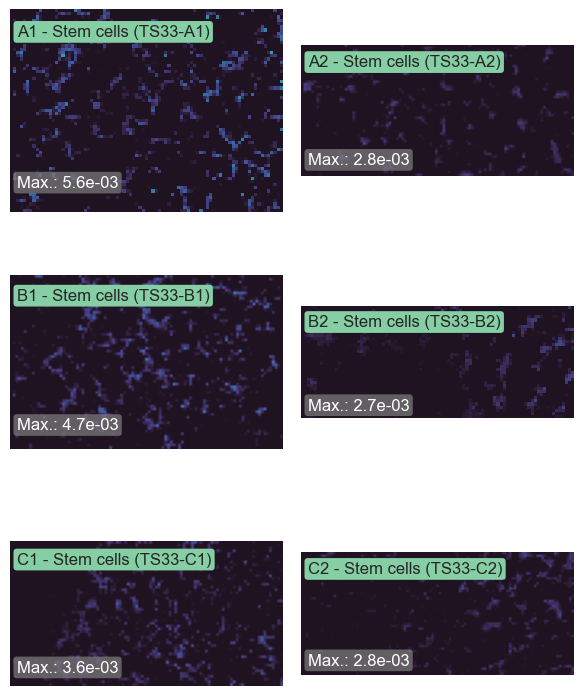

[Go back to index](#main_index)

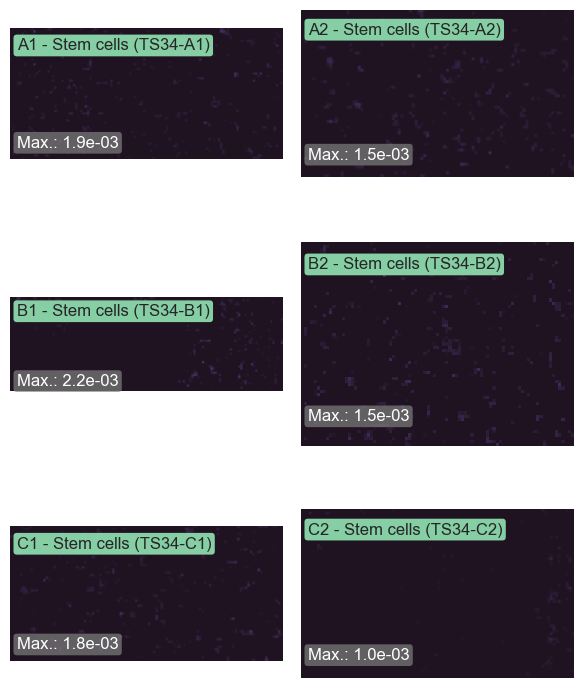

[Go back to index](#main_index)

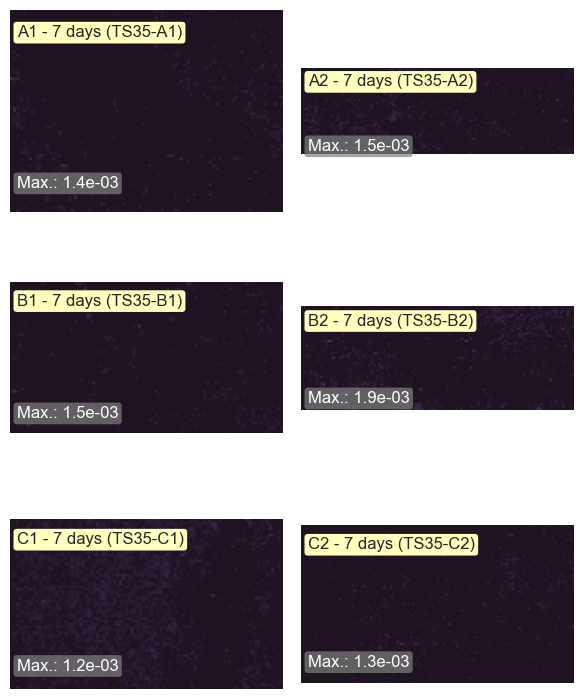

[Go back to index](#main_index)

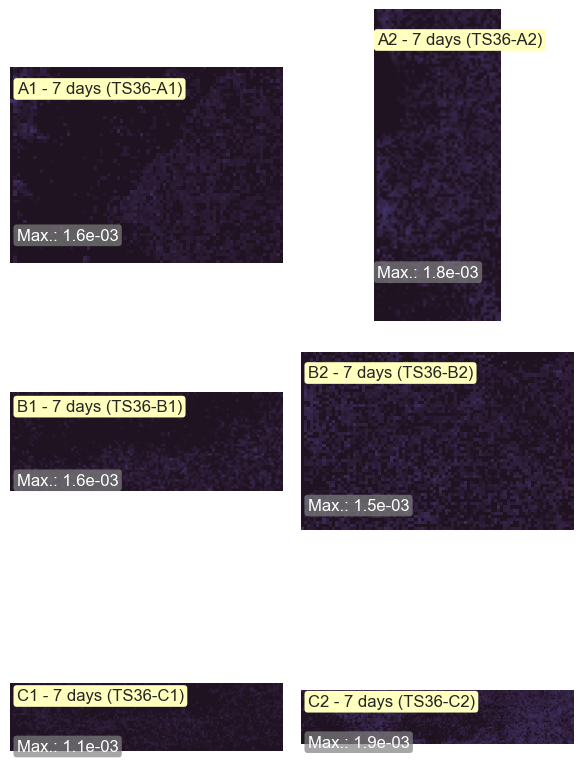

[Go back to index](#main_index)

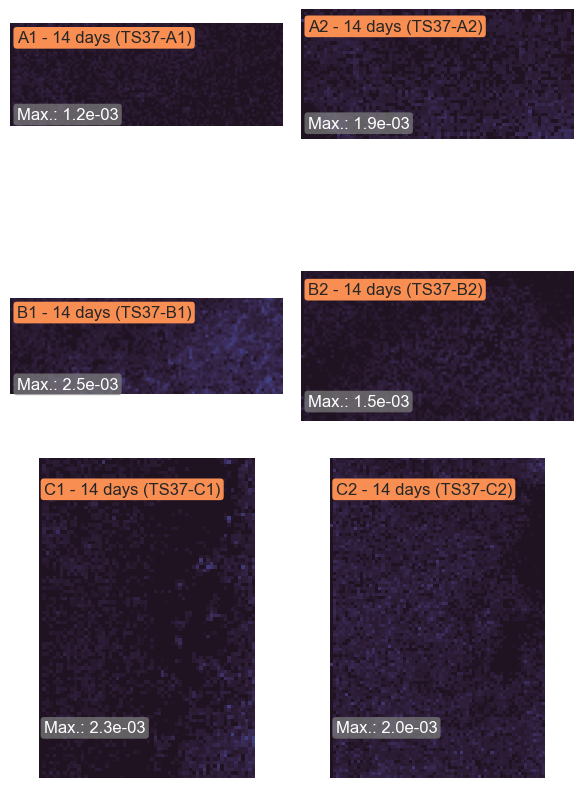

[Go back to index](#main_index)

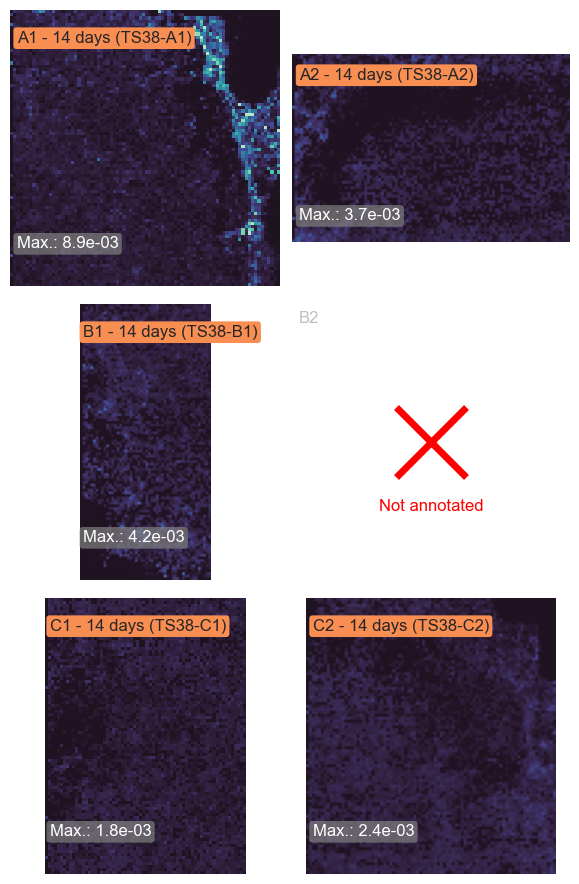

## C48H82NO8P+H

PC(14:1(9Z)/26:6(8Z,11Z,14Z,17Z,20Z,23Z)), PC(16:1(6Z)/24:6(6Z,9Z,12Z,15Z,18Z,21Z)), PC(16:1(9Z)/24:6(6Z,9Z,12Z,15Z,18Z,21Z)), PC(16:2(9Z,12Z)/24:5(6Z,9Z,12Z,15Z,18Z)), PC(16:2(9Z,12Z)/24:5(9Z,12Z,15Z,18Z,21Z)), PC(18:1(6Z)/22:6(4Z,7Z,10Z,13Z,16Z,19Z)), PC(18:1(9Z)/22:6(4Z,7Z,10Z,13Z,16Z,19Z)), PC(18:1(11E)/22:6(4Z,7Z,10Z,13Z,16Z,19Z)), PC(18:1(11Z)/22:6(4Z,7Z,10Z,13Z,16Z,19Z)), PC(18:2(9Z,11E)/22:5(4Z,7Z,10Z,13Z,16Z)), PC(18:2(9Z,11E)/22:5(7Z,10Z,13Z,16Z,19Z)), PC(18:2(9Z,12Z)/22:5(4Z,7Z,10Z,13Z,16Z)), PC(18:2(9Z,12Z)/22:5(7Z,10Z,13Z,16Z,19Z)), PC(18:3(6Z,9Z,12Z)/22:4(7Z,10Z,13Z,16Z)), PC(18:3(9Z,12Z,15Z)/22:4(7Z,10Z,13Z,16Z)), PC(18:4(6Z,9Z,12Z,15Z)/22:3(10Z,13Z,16Z)), PC(20:2(11Z,14Z)/20:5(5Z,8Z,11Z,14Z,17Z)), PC(20:3(5Z,8Z,11Z)/20:4(5Z,8Z,11Z,14Z)), PC(20:3(5Z,8Z,11Z)/20:4(8Z,11Z,14Z,17Z)), PC(20:3(8Z,11Z,14Z)/20:4(5Z,8Z,11Z,14Z)), PC(20:3(8Z,11Z,14Z)/20:4(8Z,11Z,14Z,17Z)), PC(20:3(11Z,14Z,17Z)/20:4(5Z,8Z,11Z,14Z)), PC(20:3(11Z,14Z,17Z)/20:4(8Z,11Z,14Z,17Z)), PC(20:4(5Z,8Z,11Z,14Z)/20:3(5Z,8Z,11Z)), PC(20:4(5Z,8Z,11Z,14Z)/20:3(8Z,11Z,14Z)), PC(20:4(5Z,8Z,11Z,14Z)/20:3(11Z,14Z,17Z)), PC(20:4(8Z,11Z,14Z,17Z)/20:3(5Z,8Z,11Z)), PC(20:4(8Z,11Z,14Z,17Z)/20:3(8Z,11Z,14Z)), PC(20:4(8Z,11Z,14Z,17Z)/20:3(11Z,14Z,17Z)), PC(20:5(5Z,8Z,11Z,14Z,17Z)/20:2(11Z,14Z)), PC(22:3(10Z,13Z,16Z)/18:4(6Z,9Z,12Z,15Z)), PC(22:4(7Z,10Z,13Z,16Z)/18:3(6Z,9Z,12Z)), PC(22:4(7Z,10Z,13Z,16Z)/18:3(9Z,12Z,15Z)), PC(22:5(4Z,7Z,10Z,13Z,16Z)/18:2(9Z,11E)), PC(22:5(4Z,7Z,10Z,13Z,16Z)/18:2(9Z,12Z)), PC(22:5(7Z,10Z,13Z,16Z,19Z)/18:2(9Z,11E)), PC(22:5(7Z,10Z,13Z,16Z,19Z)/18:2(9Z,12Z)), PC(22:6(4Z,7Z,10Z,13Z,16Z,19Z)/18:1(6Z)), PC(22:6(4Z,7Z,10Z,13Z,16Z,19Z)/18:1(9Z)), PC(22:6(4Z,7Z,10Z,13Z,16Z,19Z)/18:1(11E)), PC(22:6(4Z,7Z,10Z,13Z,16Z,19Z)/18:1(11Z)), PC(24:5(6Z,9Z,12Z,15Z,18Z)/16:2(9Z,12Z)), PC(24:5(9Z,12Z,15Z,18Z,21Z)/16:2(9Z,12Z)), PC(24:6(6Z,9Z,12Z,15Z,18Z,21Z)/16:1(6Z)), PC(24:6(6Z,9Z,12Z,15Z,18Z,21Z)/16:1(9Z)), PC(26:6(8Z,11Z,14Z,17Z,20Z,23Z)/14:1(9Z)), PE-NMe(20:1(11Z)/22:6(4Z,7Z,10Z,13Z,16Z,19Z)), PE-NMe(20:2(11Z,14Z)/22:5(4Z,7Z,10Z,13Z,16Z)), PE-NMe(20:2(11Z,14Z)/22:5(7Z,10Z,13Z,16Z,19Z)), PE-NMe(20:3(5Z,8Z,11Z)/22:4(7Z,10Z,13Z,16Z)), PE-NMe(20:3(8Z,11Z,14Z)/22:4(7Z,10Z,13Z,16Z)), PE-NMe(20:5(5Z,8Z,11Z,14Z,17Z)/22:2(13Z,16Z)), PE-NMe(22:2(13Z,16Z)/20:5(5Z,8Z,11Z,14Z,17Z)), PE-NMe(22:4(7Z,10Z,13Z,16Z)/20:3(5Z,8Z,11Z)), PE-NMe(22:4(7Z,10Z,13Z,16Z)/20:3(8Z,11Z,14Z)), PE-NMe(22:5(4Z,7Z,10Z,13Z,16Z)/20:2(11Z,14Z)), PE-NMe(22:5(7Z,10Z,13Z,16Z,19Z)/20:2(11Z,14Z)), PE-NMe(22:6(4Z,7Z,10Z,13Z,16Z,19Z)/20:1(11Z))

Joint colormap: for all wells/datasets, the same colormap is used to represent ion intensities.

[Go back to index](#main_index)

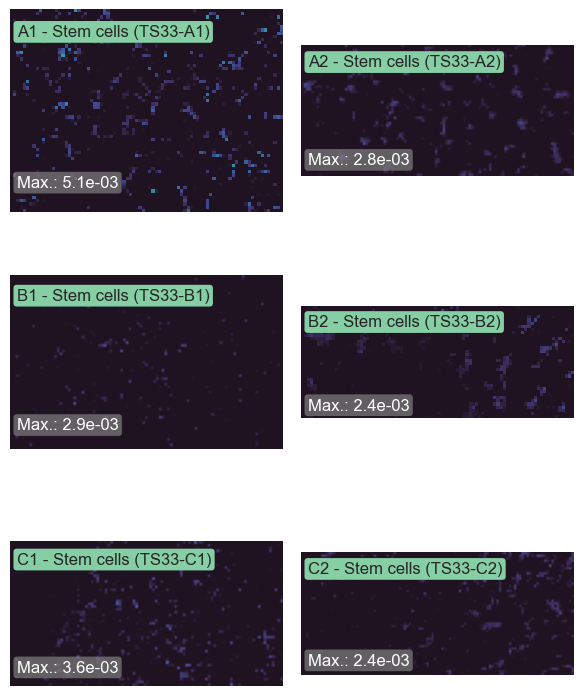

[Go back to index](#main_index)

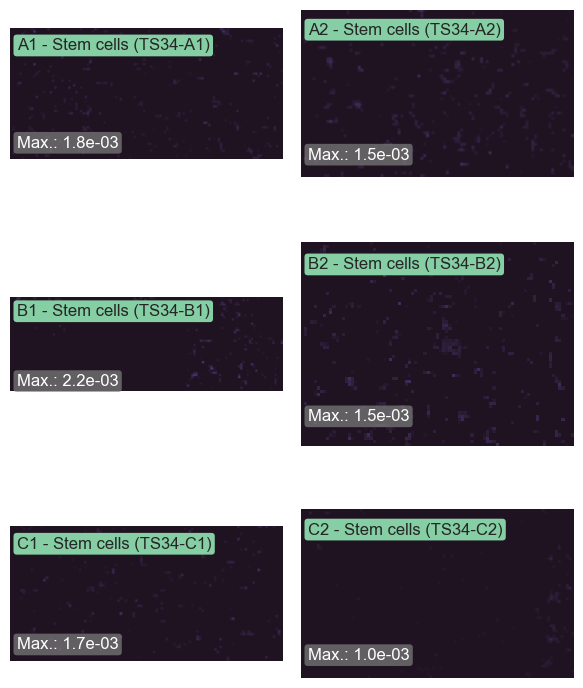

[Go back to index](#main_index)

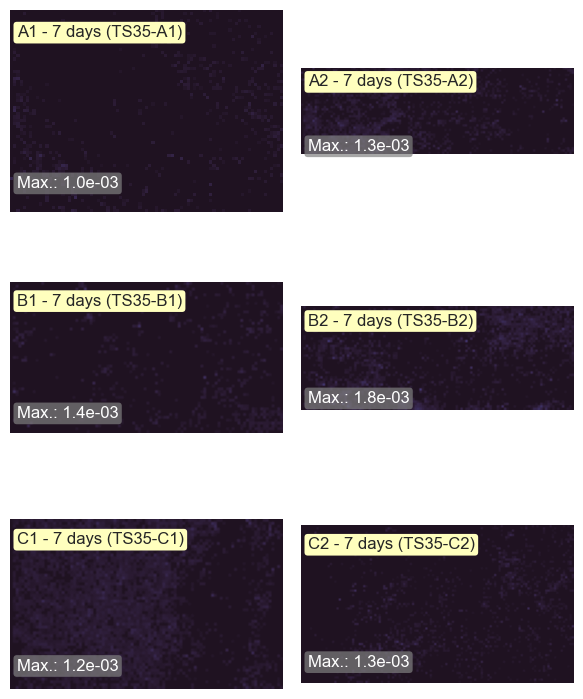

[Go back to index](#main_index)

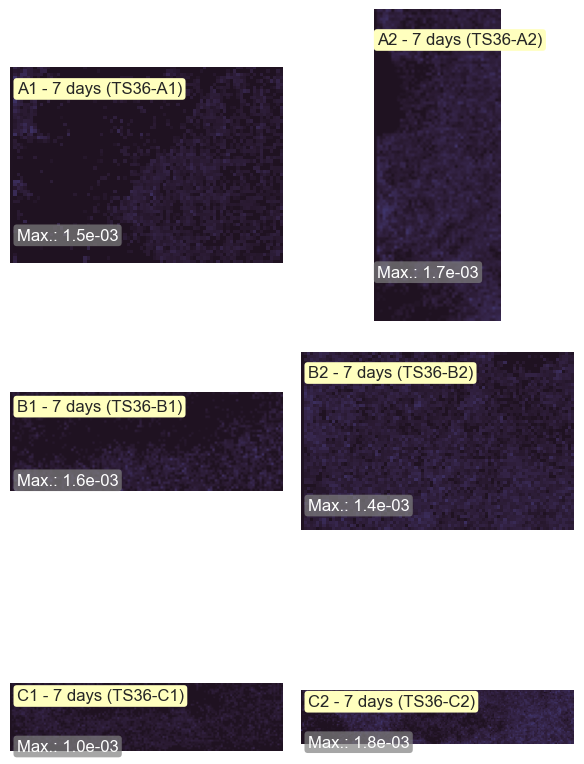

[Go back to index](#main_index)

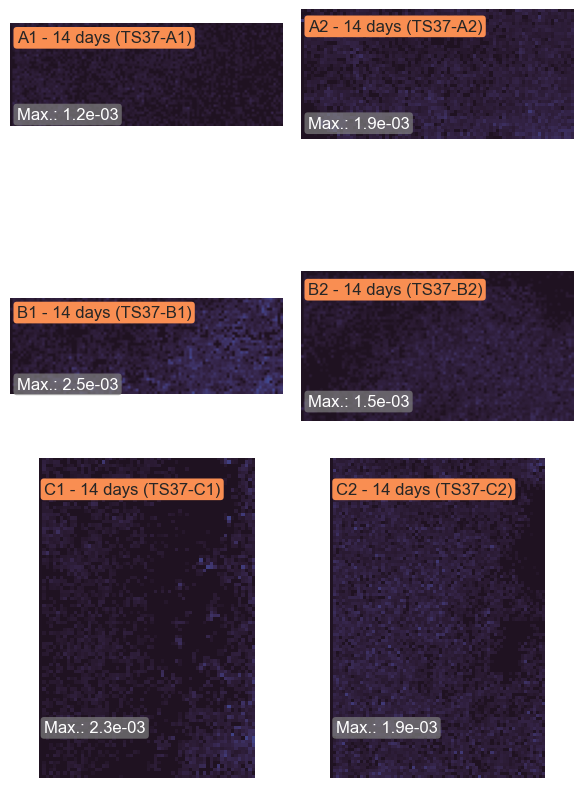

[Go back to index](#main_index)

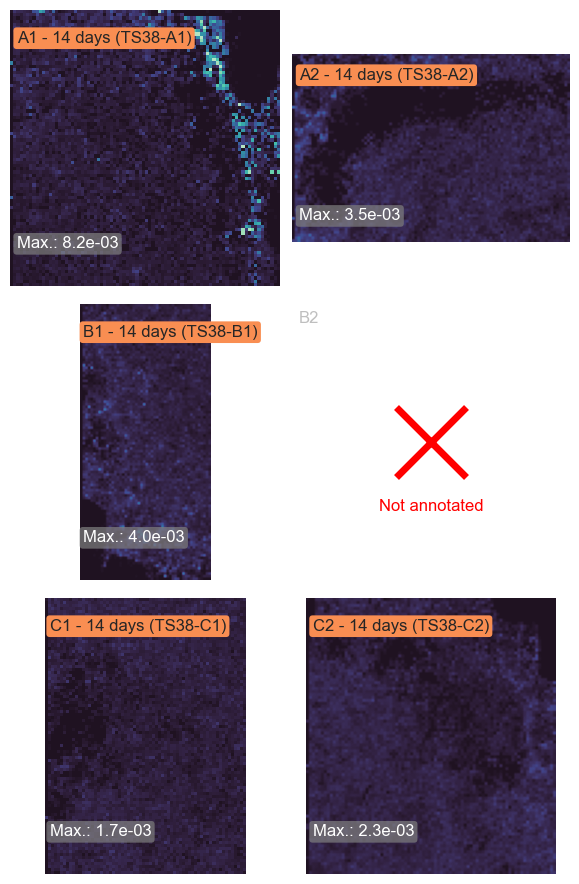

## C51H76O5+NH4

1,2-di-(6Z,9Z,12Z,15Z,18Z,21Z-tetracosahexaenoyl)-sn-glycerol, 1,3-di-(6Z,9Z,12Z,15Z,18Z,21Z-tetracosahexaenoyl)-sn-glycerol, 2,3-di-(6Z,9Z,12Z,15Z,18Z,21Z-tetracosahexaenoyl)-sn-glycerol

Joint colormap: for all wells/datasets, the same colormap is used to represent ion intensities.

[Go back to index](#main_index)

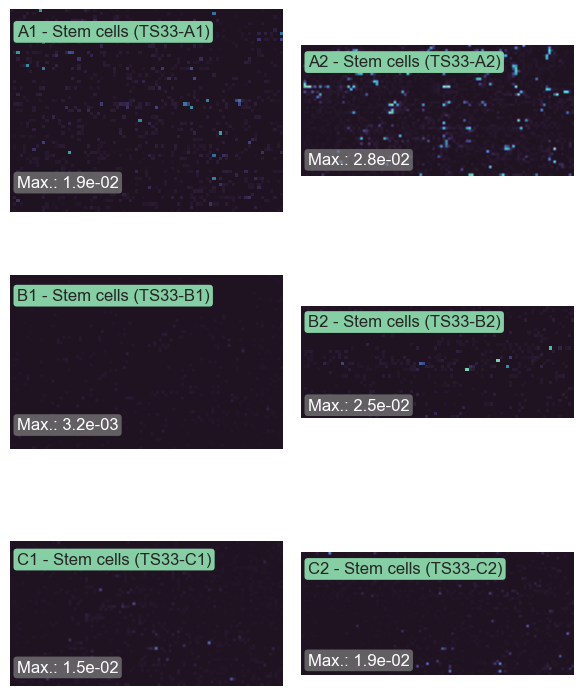

[Go back to index](#main_index)

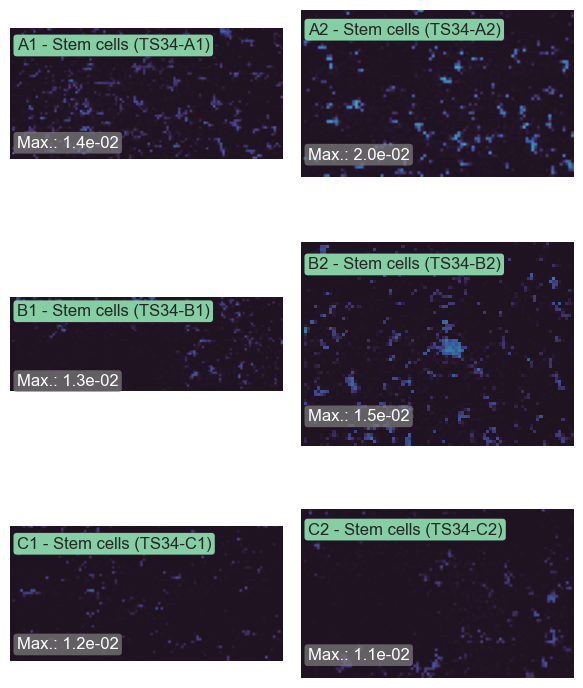

[Go back to index](#main_index)

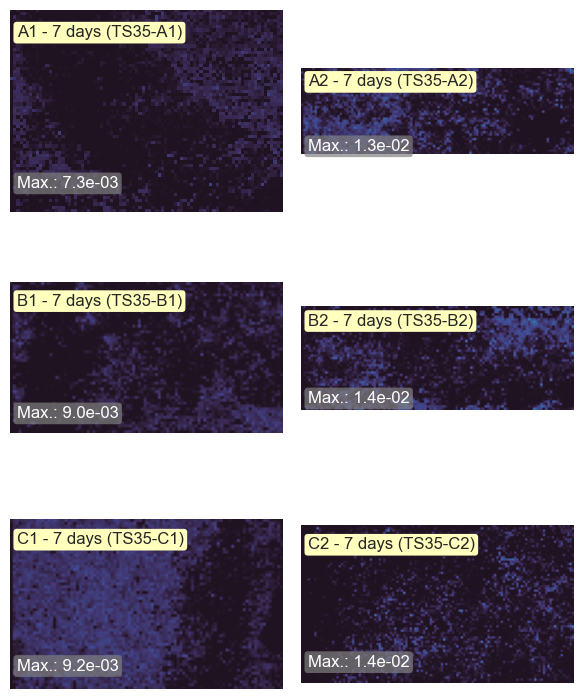

[Go back to index](#main_index)

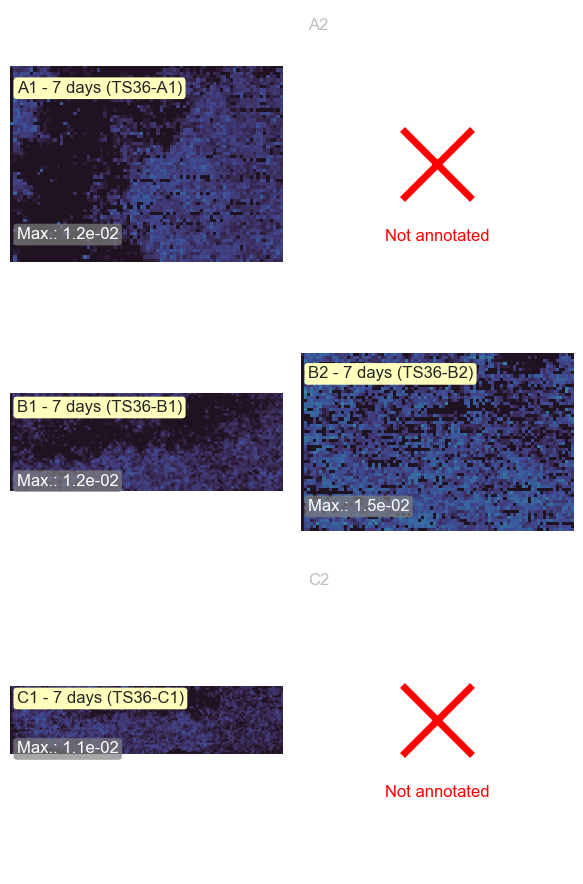

[Go back to index](#main_index)

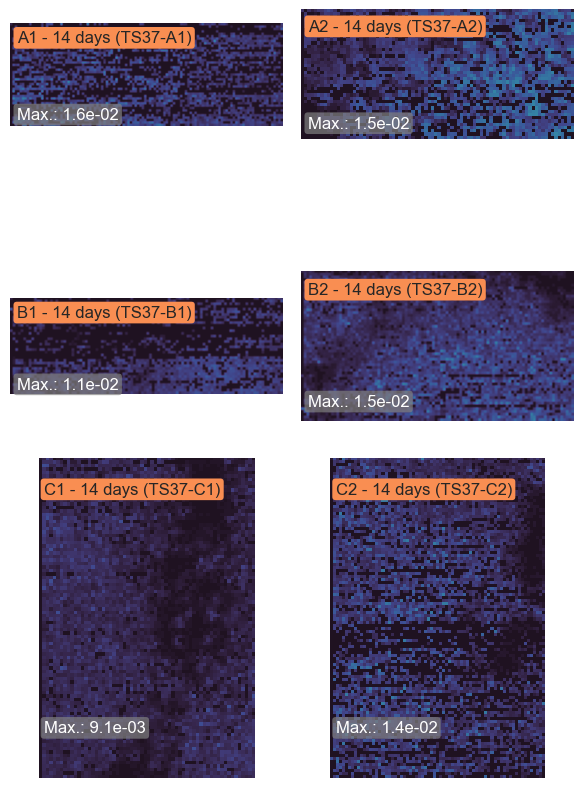

[Go back to index](#main_index)

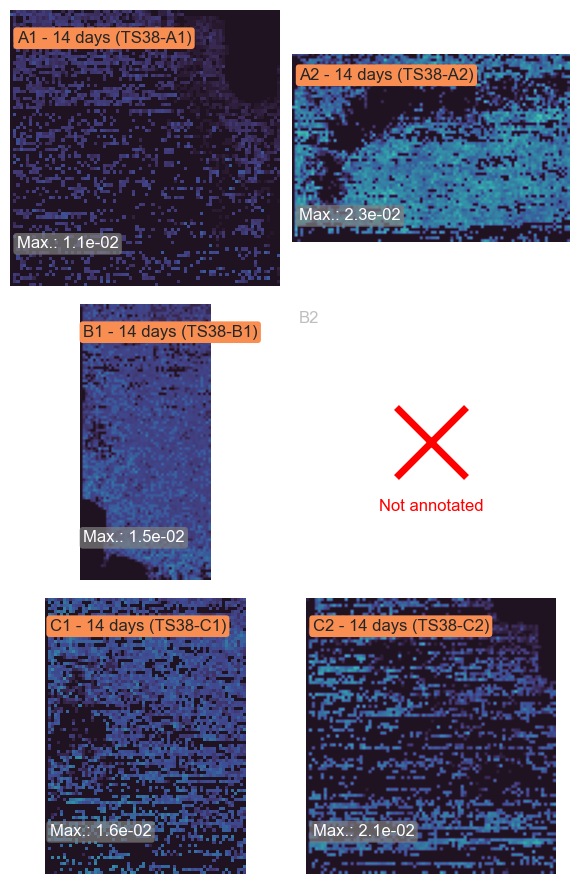

In [8]:
# ----------------------------------------------
# Print Ion Images
# ----------------------------------------------
display(HTML(f'<h2 id="ion_images">Ion Images for DE Markers</h2>'))
mprint(f"[Go back to index](#main_index)")
all_databases = ", ".join(results.database.value_counts().index.to_list())
# TODO: get it from the adata file (sometimes fdr there is zero...)
# max_fdr = results.fdr.max()
max_fdr = report_config.get("adata_options/download_options/fdr", 0.5)
max_fdr = int(max_fdr * 100)
mprint(
    f"Annotation done at FDR {max_fdr}% against the following databases: {all_databases}")
mprint(f"Ion images with TIC normalization: `{tic_normalization}`")


def plot_img(img, color, **kwargs):
    plt.imshow(img.iloc[0], **kwargs)


results["annotation_id"] = results["formula"] + results["adduct"]

if slide_key:
    gb = ion_images.sort_values(
        slide_key, key=natsort.natsort_key
    ).groupby(slide_key)
else:
    raise DeprecationWarning
    gb = [(False, ion_images)]

join_colormap = report_config.get("metaspace_qc/"
                                  "ion_images_with_same_scale_across_datasets",
                                  default=False)

# Loop over the markers:
for annotation_id, row in links_to_ion_images_sections.iterrows():
    # Ignore slides that are completely not annotated:
    row = row.loc[~row.isna()]
    # This should not happen, but just in case (at least one slide should be not Nan)
    if not row.empty:
        mprint(f"## {annotation_id}")
        if annotation_id != "TIC":
            molnames = results[
                results.annotation_id == annotation_id
                ].iloc[0]["moleculeNames"]
            molnames = ", ".join(molnames)
            mprint(molnames)

        colormap_string = "Joint colormap: for all wells/datasets, the same colormap is used to represent ion intensities." if join_colormap else "Individual colormaps: for each well/dataset, a different colormap is used to represent ion intensities."
        mprint(f"{colormap_string}")

        # Loop over slides:
        for i, formatted_batch_name in enumerate(row.index):
            # TODO: find better way to get back slide name
            batch_name = \
            formatted_batch_name.split(f"{slide_key.capitalize()} ")[1]
            batch_ion_images = \
                ion_images.query(
                    f"annotation_id=='{annotation_id}' & {slide_key}=='{batch_name}'"
                )

            display(
                HTML(
                    f'<h3 id="{batch_name}_{annotation_id}">{formatted_batch_name} ({annotation_id})</h3>'))
            mprint(f"[Go back to index](#main_index)")

            g = sns.FacetGrid(
                data=batch_ion_images.loc[
                    ion_images["annotation_id"] == annotation_id
                    ],
                row=row_key,
                col=col_key,
                sharex=False,
                sharey=False,
                col_order=layout_cols,
                row_order=layout_rows,
            )

            plot_img_kwargs = {}

            if join_colormap:
                plot_img_kwargs["vmax"] = max_intensity_per_marker[
                    annotation_id]

            g.map(plot_img, "image", cmap="mercury_r",
                  **plot_img_kwargs)
            # g.set_titles(row_template="{row_name}", col_template="{col_name}")
            g.set_titles("")

            for ax in g.axes.flat:
                ax.axis("off")

            plt.tight_layout()

            with plt.rc_context(
                    {
                        "axes.edgecolor": "w",
                        "xtick.color": "w",
                        "ytick.color": "w",
                        "ytick.labelsize": 8,
                        "ytick.major.size": 2,
                    }
            ):
                for ((row, col), ax), (_, facet_data) in zip(
                        g.axes_dict.items(), g.facet_data()
                ):

                    if facet_data.empty:
                        ax.text(
                            x=0.025,
                            y=1 - 0.025,
                            s=f"{row}{col}",
                            c="0.75",
                            transform=ax.transAxes,
                            ha="left",
                            va="top",
                        )
                        # empty_text = "Not available" if annotation_id == "TIC" else "Not annotated"
                        empty_text = "Not annotated"
                        text_color = "red"
                        if masking_key:
                            mask_query = full_metadata.query(
                                f"{col_key} == '{col}' and {row_key} == '{row}' and {slide_key} == '{batch_name}'")[
                                masking_key]
                            if mask_query.empty:
                                empty_text = "Well not Available"
                                text_color = "0.75"
                            else:
                                assert len(mask_query) == 1
                                if mask_query.values[0]:
                                    empty_text = "Masked Well"
                                    text_color = "0.75"
                        ax.plot(
                            [0.5],
                            [0.5],
                            transform=ax.transAxes,
                            marker="x",
                            markersize=50,
                            markeredgewidth=5,
                            c=text_color,
                        )
                        ax.text(
                            x=0.5,
                            y=0.25,
                            s=empty_text,
                            c=text_color,
                            transform=ax.transAxes,
                            ha="center",
                        )
                    else:
                        bio_label = facet_data.iloc[0][bio_key]
                        dataset_name = facet_data.iloc[0][
                            "auto_generated_dataset_name"]
                        facecolor = palette[bio_label]

                        bbox_kwargs = {
                            "facecolor": facecolor,
                            "boxstyle": "round",
                            "pad": 0.2,
                            "linewidth": 0,
                        }

                        ax.text(
                            x=0.025,
                            y=1 - 0.075,
                            s=f"{row}{col} - {bio_label} ({dataset_name})",
                            c="0.15"
                            if sum(to_rgb(facecolor)) > 1.5
                            else "1.0",
                            transform=ax.transAxes,
                            ha="left",
                            va="top",
                            bbox=bbox_kwargs,
                        )

                        max_intensity = facet_data.image.iloc[0].max()
                        bbox_kwargs["facecolor"] = "gray"
                        bbox_kwargs["alpha"] = 0.7
                        ax.text(
                            x=0.025,
                            y=0.18,
                            # s=f"Max.: {max_intensity:.1e}" if max_intensity > 1000 else f"Max.: {max_intensity}",
                            s=f"Max.: {max_intensity:.1e}",
                            c="1.0",
                            transform=ax.transAxes,
                            ha="left",
                            va="top",
                            bbox=bbox_kwargs,
                        )
                        # x, y, w, h = ax.get_position().bounds
                        # cax = plt.gcf().add_axes([x+w*0.05, y+h*(0.7), w*0.025, h*0.25])
                        # mappable = ax.images[0]
                        # cbar = plt.colorbar(mappable, cax=cax)

            plt.show()

Violin plots of marker intensities (nonzero only, hotspot-clipped)

[Go back to index](#main_index)

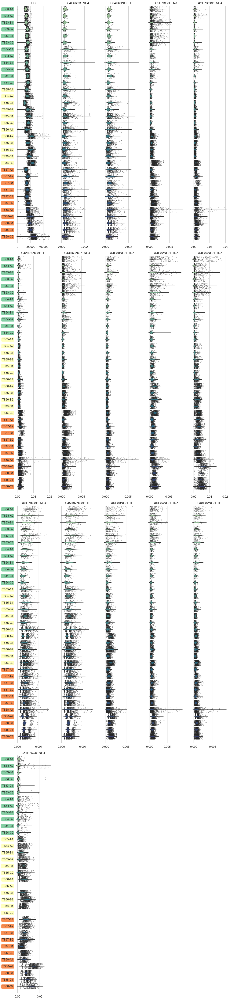

In [9]:
# ----------------------------------------------
# Print Violin Plots of Marker Intensities
# ----------------------------------------------

display(HTML(
    f'<h2 id="marker_intensities">Violin Plots of Intensities of Differentially Expressed Markers</h2>'))
mprint(f"Violin plots of marker intensities (nonzero only, hotspot-clipped)")
mprint(f"[Go back to index](#main_index)")

data_exp = marker_nzf.explode("nz_values")
data_exp["nz_values"] = data_exp["nz_values"].astype(float)

# Reset index otherwise sns.stripplot may complain:
data_exp.reset_index(inplace=True)

order = ["TIC"] + natsort.natsorted(
    marker_nzf.query("annotation_id != 'TIC'")["annotation_id"].unique()
)

with sns.axes_style("whitegrid"):
    h = 1 + 0.35 * len(metadata)
    w = 2.5
    a = w / h

    g = sns.catplot(
        data=data_exp,
        x="nz_values",
        y="auto_generated_dataset_name",
        col="annotation_id",
        col_wrap=5,
        orient="h",
        # hue="auto_generated_dataset_name",
        palette="crest",
        height=h,
        col_order=order,
        aspect=a,
        kind="violin",
        inner=None,
        linewidth=1,
        sharex=False,
        # cut=0
    )

    g.map(
        sns.stripplot,
        "nz_values",
        "auto_generated_dataset_name",
        jitter=0.45,
        s=0.5,
        color="0.2",
        zorder=-1,
    )

    g.set(xlabel="", ylabel="")
    g.set_titles("{col_name}")

    for ax, (_, facet_data) in zip(g.axes.flat, g.facet_data()):
        ax.xaxis.grid(True)
        ax.yaxis.grid(False)
        ax.tick_params(labelbottom=True)
        ax.set_ylim(len(marker_nzf.auto_generated_dataset_name.cat.categories),
                    -0.5)
        if facet_data.empty:
            ax.set_xticks([])
            ax.plot(
                [0.5],
                [0.5],
                transform=ax.transAxes,
                marker="x",
                markersize=30,
                markeredgewidth=3,
                c="0.75",
            )

    for ax in g._left_axes:
        osm.pl._pl._decorate_ticklabels(
            ax, ytick_palette=tick_palette, adapt_textcolor=True
        )

    sns.despine(left=True, bottom=True)
    plt.show()



# # %%
# # ----------------------------------------------
# # Linearity between FDR & no. of annotations
# # ----------------------------------------------
# display(HTML(
#     f'<h2 id="linearity">Linearity between FDR & no. of annotations</h2>'))
# mprint(f"[Go back to index](#main_index)")
#
#
# def set_facetgrid_titles(g):
#     # Manually set titles:
#     for (row_i, col_j, cue), data_ijk in g.facet_data():
#         if not data_ijk.empty:
#             ax = g.facet_axis(row_i, col_j)
#             well_data = data_ijk[[col_key, row_key,
#                                   "auto_generated_dataset_name"]].value_counts().reset_index().iloc[
#                 0]
#             ax.set_title(
#                 f"{well_data[row_key]}{well_data[col_key]} - {well_data['auto_generated_dataset_name']}")
#
#
# if slide_key:
#     gb = n_ions.groupby(slide_key)
# else:
#     gb = [(None, n_ions)]
#
# for batch, batch_n_ions in gb:
#     if slide_key:
#         mprint(f"### {slide_key.capitalize()} {batch}")
#
#     g = sns.FacetGrid(
#         data=batch_n_ions,
#         col=col_key,
#         row=row_key,
#         hue="database",
#         palette="mercury_r",
#         # hue_kws=d,
#         legend_out=True,
#         height=2,
#         col_order=layout_cols,
#         row_order=layout_rows,
#     )
#
#     g.map(sns.lineplot, "fdr", "n_ions", marker="o", markeredgewidth=0)
#
#     g.add_legend(title="Database")
#
#     g.set_titles("{row_name}{col_name}")
#
#     set_facetgrid_titles(g)
#     # # Manually set titles:
#     # for (row_i, col_j, cue), data_ijk in g.facet_data():
#     #     ax = g.facet_axis(row_i, col_j)
#     #     well_data = data_ijk[["col", "row", "auto_generated_dataset_name"]].value_counts().reset_index().iloc[0]
#     #     assert len(well_data) == 1
#     #     ax.set_title(f"{well_data['row']}{well_data['col']}\n{well_data['dataset_name']}")
#
#     plt.yscale("log")
#     plt.xscale("log")
#     plt.xticks([0.05, 0.1, 0.2, 0.5])
#     plt.xlim([0.03, 0.6])
#     plt.gca().get_xaxis().set_major_formatter(ScalarFormatter())
#     plt.gca().get_xaxis().get_major_formatter().labelOnlyBase = False
#
#     for (row, col), ax in g.axes_dict.items():
#         if ax in g._bottom_axes:
#             ax.set_xticklabels(
#                 ["5%", "10%", "20%", "50%"], rotation=90, ha="center"
#             )
#
#         query = batch_n_ions.query(
#             f"({row_key}=='{row}') & ({col_key}=='{col}')")
#         if not query.empty:
#             bio_label = query.iloc[0][bio_key]
#
#             facecolor = palette[bio_label]
#
#             bbox_kwargs = {
#                 "facecolor": facecolor,
#                 "boxstyle": "round",
#                 "pad": 0.2,
#                 "linewidth": 0,
#             }
#
#             ax.set_title(
#                 ax.get_title(),
#                 color="0.15"
#                 if sum(to_rgb(palette[bio_label])) > 1.5
#                 else "1.0",
#                 bbox=bbox_kwargs,
#                 fontsize=9
#             )
#
#     plt.show()
#
# # %%
# # ----------------------------------------------
# # Fraction of pixels with non-zero intensity
# # ----------------------------------------------
# display(HTML(
#     f'<h2 id="non_zero_fraction">Fraction of pixels with non-zero intensity</h2>'))
# mprint(f"[Go back to index](#main_index)")
#
# order = natsort.natsorted(
#     marker_nzf.query("annotation_id != 'TIC'")["annotation_id"].unique()
# )
#
# with sns.axes_style("whitegrid"):
#     h = 1 + 0.25 * len(metadata)
#     w = 2.5
#     a = w / h
#
#     g = sns.FacetGrid(
#         marker_nzf,
#         col="annotation_id",
#         col_wrap=5,
#         # palette=palette,
#         # hue=bio_key,
#         height=h,
#         col_order=order,
#         aspect=a,
#     )
#
#     g.map(
#         sns.stripplot,
#         "nz_frac",
#         "auto_generated_dataset_name",
#         size=10,
#         orient="h",
#         jitter=False,
#         palette="mercury",
#         linewidth=1,
#         edgecolor="w",
#         # order=marker_nzf.auto_generated_dataset_name.cat.categories
#     )
#
#     # g.refline(x=1, linestyle=":", color=".75", linewidth=1)
#
#     g.set(xlabel="NZ fraction", ylabel="", xlim=[-0.05, 1.05])
#     g.set_titles("{col_name}")
#
#     for ax, (_, facet_data) in zip(g.axes.flat, g.facet_data()):
#         ax.xaxis.grid(False)
#         ax.yaxis.grid(True)
#         ax.tick_params(labelbottom=True)
#
#         if facet_data.empty:
#             ax.yaxis.grid(False)
#             ax.plot(
#                 [0.5],
#                 [0.5],
#                 transform=ax.transAxes,
#                 marker="x",
#                 markersize=30,
#                 markeredgewidth=3,
#                 c="0.75",
#             )
#
#     for ax in g._left_axes:
#         osm.pl._pl._decorate_ticklabels(
#             ax, ytick_palette=tick_palette, adapt_textcolor=True
#         )
#
#         # if not np.isin(ax.title.get_text(), marker_nzf["formula"]):
#         #    ax.yaxis.grid(False)
#         #    ax.plot([0.5], [0.5], transform=ax.transAxes, marker="x", markersize=30, markeredgewidth=3, c="0.75")
#
#     sns.despine(left=True, bottom=True)
#     plt.show()
#
# # %%
# # ----------------------------------------------
# # Ion coverage across datasets
# # ----------------------------------------------
# display(HTML(f'<h2 id="ion_converage">Ion coverage across datasets</h2>'))
# mprint(f"[Go back to index](#main_index)")
#
# coverage_dfs = []
# for fdr in results["fdr"].unique():
#     # Across all databases
#     coverage = (
#         results[results["fdr"] <= fdr]
#         .groupby(["datasetId"])["annotation_id"]
#         .unique()
#         .explode()
#     )
#     coverage_sum = coverage.value_counts().sort_values(ascending=False)
#     coverage_sum.index.name = "ionFormula"
#     coverage_sum.name = "coverage"
#     coverage_sum = coverage_sum.reset_index()
#     coverage_sum["fdr"] = fdr
#     coverage_sum["database"] = "All databases"
#
#     # Per-database
#     coverage_dfs.append(coverage_sum)
#     coverage = (
#         results[results["fdr"] <= fdr]
#         .groupby(["datasetId", "database"])["annotation_id"]
#         .unique()
#         .explode()
#     )
#     coverage_sum = (
#         coverage.groupby("database")
#         .value_counts()
#         .sort_values(ascending=False)
#     )
#     coverage_sum.name = "coverage"
#     coverage_sum = coverage_sum.reset_index()
#     coverage_sum["fdr"] = fdr
#
#     coverage_dfs.append(coverage_sum)
#
# coverage = pd.concat(coverage_dfs, ignore_index=True)
#
# g = sns.displot(
#     data=coverage,
#     kind="hist",
#     x="coverage",
#     col="fdr",
#     row="database",
#     discrete=True,
#     height=3.5,
#     facet_kws=dict(margin_titles=True),
# )
#
# for ax, (_, ax_data) in zip(g.axes.flat, g.facet_data()):
#     n_global = (ax_data["coverage"] == len(metadata)).sum()
#     ax.text(
#         s=f"Globally\ncovered\nions: {n_global}\n▼",
#         y=n_global * 1.025,
#         x=len(metadata),
#         c=plt.rcParams["axes.edgecolor"],
#         ha="center",
#         va="bottom",
#         fontsize=10,
#     )
#
# g.set_xlabels("Datasets covered")
# g.set_titles(
#     col_template=r"FDR $\leq$ {col_name}", row_template="{row_name}"
# )
# plt.ylim(top=plt.ylim()[1] * 1.2)
# plt.xlim(0.4, len(metadata) + 0.6)
# plt.locator_params(nbins=4, axis="y")
# sns.despine()
#
# plt.show()